Summary of Market Data
* Data related to machinery and electrical equipment industry across multiple countries.
* Key components
- First row : types of data (Production Index Machiney & Electricals)
- Second Row: Unique code
- Actual data (from row 2): 
    - time periods
    - columns = economic indicators and regions

Key Features (2 main types of indices)
- Production Index: measures the production output of machinery and electrical equipment. 
- Shipments Index: volume of shipments for machinery and electrical equipment. 

Indices are base 100 => if value is greater than 100, production or shipments have increased, if not, have declined.

1) Market Trends and Economic Health
* Production Indices (MAB_ELE_PROXXX, PROXXXXX)
* Shipments Indices (MAB_ELE_SHPXXX) (How much machinery and electrical equipment is being transported. If shipments are lower than production (inventory build up or reduced demand), otherwise it would suggrest high demand)

2) Pricing Trends and Cost Factors
* Raw material prices
- Track global commodity prices (base metals, energy...)
- If raw material prices increase, manufacturing costs rise
* Producer Prices (how much manufactures charge)
- Higher demand or Increased Production Costs

3) Global & Regional Comparisons
* Country-Wise Data
* Glibal Indices

4) Currency and International Trade

<a class="anchor" id="chapter1"></a>

# 1. Data Exploration

</a>

<a class="anchor" id="sub-section-1_1"></a>

## 1.1. Imports

</a>

In [108]:
# Imports
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

In [109]:
# Configurations
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

# Force normal decimal formatting
pd.options.display.float_format = '{:.4f}'.format

In [110]:
# Import xlsx dataset into pandas dataframe
market_data = pd.read_excel('../Data/Case2_Market data.xlsx', header=[0,1,2])

# Import csv dataset into pandas dataframe
sales_data = pd.read_csv('../Data/Case2_Sales data.csv', sep=";")

In [111]:
print(sales_data)

            DATE Mapped_GCK    Sales_EUR
0     01.10.2018         #1            0
1     02.10.2018         #1            0
2     03.10.2018         #1            0
3     04.10.2018         #1            0
4     05.10.2018         #1            0
5     06.10.2018         #1            0
6     08.10.2018         #1            0
7     09.10.2018         #1            0
8     10.10.2018         #1            0
9     11.10.2018         #1            0
10    12.10.2018         #1            0
11    13.10.2018         #1            0
12    14.10.2018         #1            0
13    15.10.2018         #1            0
14    16.10.2018         #1            0
15    17.10.2018         #1            0
16    18.10.2018         #1            0
17    19.10.2018         #1            0
18    04.08.2021        #11            0
19    24.08.2021        #11            0
20    04.08.2021         #6            0
21    20.10.2018         #1            0
22    22.10.2018         #1            0
23    23.10.2018

In [112]:
sales_data['DATE'] = pd.to_datetime(sales_data['DATE'], dayfirst=True)



In [113]:
# Print min and max dates
print("📅 Min date:", sales_data['DATE'].min())
print("📅 Max date:", sales_data['DATE'].max())

📅 Min date: 2018-10-01 00:00:00
📅 Max date: 2022-04-30 00:00:00


<a class="anchor" id="sub-section-1_2"></a>

# 1.2. Market Data

</a>

In [114]:
market_data.head()

Unnamed: 0_level_0  \
  Index 2010=100 (if not otherwise noted)   
                                     date   
0                                  2004m2   
1                                  2004m3   
2                                  2004m4   
3                                  2004m5   
4                                  2004m6   

                                     China  \
  Production Index Machinery & Electricals   
                            MAB_ELE_PRO156   
0                                  16.9407   
1                                  23.7119   
2                                  24.4352   
3                                  23.7081   
4                                  27.0091   

                                           \
  Shipments Index Machinery & Electricals   
                           MAB_ELE_SHP156   
0                                 16.9407   
1                                 23.7119   
2                                 24.4352   
3                                 23.7081   
4                                 27.0091   

                                    France  \
  Production Index Machinery & Electricals   
                            MAB_ELE_PRO250   
0                                 112.0913   
1                                 136.3280   
2                                 117.7918   
3                                 109.0025   
4                                 133.7857   

                                           \
  Shipments Index Machinery & Electricals   
                           MAB_ELE_SHP250   
0                                 83.4589   
1                                106.1682   
2                                 92.0076   
3                                 85.6965   
4                                106.6415   

                                   Germany  \
  Production Index Machinery & Electricals   
                            MAB_ELE_PRO276   
0                                  82.6230   
1                                 100.5566   
2                                  89.6532   
3                                  86.8806   
4                                  99.0108   

                                           \
  Shipments Index Machinery & Electricals   
                           MAB_ELE_SHP276   
0                                 79.4525   
1                                 97.0129   
2                                 84.9324   
3                                 82.3728   
4                                 95.1087   

                                     Italy  \
  Production Index Machinery & Electricals   
                            MAB_ELE_PRO380   
0                                 124.2896   
1                                 143.4117   
2                                 129.0838   
3                                 135.5904   
4                                 136.4249   

                                           \
  Shipments Index Machinery & Electricals   
                           MAB_ELE_SHP380   
0                                 86.5605   
1                                106.3445   
2                                 95.5797   
3                                100.0870   
4                                110.8897   

                                     Japan  \
  Production Index Machinery & Electricals   
                            MAB_ELE_PRO392   
0                                 109.3340   
1                                 140.8846   
2                                 105.8536   
3                                 101.8648   
4                                 120.3329   

                                           \
  Shipments Index Machinery & Electricals   
                           MAB_ELE_SHP392   
0                                110.4953   
1                                144.6862   
2                                102.6558   
3                                100.3053   
4                                119.6164   

            

| Feature            | Description |
|----------------|------------------------------------------|
| date            | Index 2010 = 100 (if not otherwise noted) |
| MAB_ELE_PRO156 | China Production Index Machinery & Electricals |
| MAB_ELE_SHP156 | China Shipments Index Machinery & Electricals |
| MAB_ELE_PRO250 | France Production Index Machinery & Electricals |
| MAB_ELE_SHP250 | France Shipments Index Machinery & Electricals |
| MAB_ELE_PRO276 | Germany Production Index Machinery & Electricals |
| MAB_ELE_SHP276 | Germany Shipments Index Machinery & Electricals |
| MAB_ELE_PRO380 | Italy Production Index Machinery & Electricals |
| MAB_ELE_SHP380 | Italy Shipments Index Machinery & Electricals |
| MAB_ELE_PRO392 | Japan Production Index Machinery & Electricals |
| MAB_ELE_SHP392 | Japan Shipments Index Machinery & Electricals |
| MAB_ELE_PRO756 | Switzerland Production Index Machinery & Electricals |
| MAB_ELE_SHP756 | Switzerland Shipments Index Machinery & Electricals |
| MAB_ELE_PRO826 | United Kingdom Production Index Machinery & Electricals |
| MAB_ELE_SHP826 | United Kingdom Shipments Index Machinery & Electricals |
| MAB_ELE_PRO840 | United States Production Index Machinery & Electricals |
| MAB_ELE_SHP840  | United States Shipments Index Machinery & Electricals |
| MAB_ELE_PRO1100 | Europe Production Index Machinery & Electricals |
| MAB_ELE_SHP1100 | Europe Shipments Index Machinery & Electricals |
| RohiBASEMET1000_org | World: Price of Base Metals |
| RohiENERGY1000_org  | World: Price of Energy |
| RohiMETMIN1000_org  | World: Price of Metals & Minerals |
| RohiNATGAS1000_org  | World: Price of Natural Gas Index |
| RohCRUDE_PETRO1000_org | World: Price of Crude Oil, Average |
| RohCOPPER1000_org | World: Price of Copper |
| WKLWEUR840_org | United States: EUR in LCU |
| PRI27840_org | Producer Prices: United States Electrical Equipment |
| PRI27826_org | Producer Prices: United Kingdom Electrical Equipment |
| PRI27380_org | Producer Prices: Italy Electrical Equipment |
| PRI27250_org | Producer Prices: France Electrical Equipment |
| PRI27276_org | Producer Prices: Germany Electrical Equipment |
| PRI27156_org | Producer Prices: China Electrical Equipment |
| PRO28840_org | Production index: United States Machinery and Equipment n.e.c. |
| PRO281000_org   | Production index: World Machinery and Equipment n.e.c. |
| PRO28756_org    | Production index: Switzerland Machinery and Equipment n.e.c. |
| PRO28826_org    | Production index: United Kingdom Machinery and Equipment n.e.c. |
| PRO28380_org    | Production index: Italy Machinery and Equipment n.e.c. |
| PRO28392_org    | Production index: Japan Machinery and Equipment n.e.c. |
| PRO28250_org    | Production index: France Machinery and Equipment n.e.c. |
| PRO28276_org    | Production index: Germany Machinery and Equipment n.e.c. |
| PRO27840_org    | Production index: United States Electrical Equipment |
| PRO271000_org   | Production index: World Electrical Equipment |
| PRO27756_org    | Production index: Switzerland Electrical Equipment |
| PRO27826_org    | Production index: United Kingdom Electrical Equipment |
| PRO27380_org    | Production index: Italy Electrical Equipment |
| PRO27392_org    | Production index: Japan Electrical Equipment |
| PRO27250_org    | Production index: France Electrical Equipment |
| PRO27276_org    | Production index: Germany Electrical Equipment |

In [115]:
# Keep only the third header row (index 2)
market_data.columns = market_data.columns.droplevel([0,1])
market_data.head()

,date,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org
0,2004m2,16.9407,16.9407,112.0913,83.4589,82.6230,79.4525,124.2896,86.5605,109.3340,110.4953,91.2219,89.9873,111.3538,73.6013,107.6014,79.2402,97.1229,80.0985,54.0398,44.1233,48.7479,87.0770,39.6395,36.6238,1.2646,78.9699,80.7574,93.0200,NaN,93.2305,NaN,102.4917,97.5974,97.1000,106.1920,116.7903,110.8900,118.2741,80.8290,117.7240,NaN,81.1000,120.7065,141.5109,106.1613,102.0771,85.9132
1,2004m3,23.7119,23.7119,136.3280,106.1682,100.5566,97.0129,143.4117,106.3445,140.8846,144.6862,85.8663,79.8836,127.5586,84.0476,110.1874,98.6190,113.7839,96.0159,54.6662,47.5890,49.2562,87.1927,42.5920,39.9311,1.2262,79.6736,80.9621,93.5403,NaN,93.3357,NaN,105.6275,113.2249,91.1951,121.6251,139.2884,141.1769,148.1218,102.1301,119.2208,NaN,76.6903,138.3095,152.8802,140.2887,117.2257,97.6708
2,2004m4,24.4352,24.4352,117.7918,92.0076,89.6532,84.9324,129.0838,95.5797,105.8536,102.6558,85.6225,79.7408,108.7323,73.0260,108.1666,89.7740,101.7152,85.1672,54.8727,47.7790,49.4238,91.3799,42.6506,39.1349,1.1985,80.3376,80.7574,93.8524,NaN,93.4409,NaN,103.4850,100.1691,93.7935,104.9655,125.2896,105.6488,125.4822,90.9614,117.4411,NaN,71.5524,115.5573,137.7969,106.2712,105.3358,87.2540
3,2004m5,23.7081,23.7081,109.0025,85.6965,86.8806,82.3728,135.5904,100.0870,101.8648,100.3053,85.3787,79.5980,110.6452,74.5919,108.4259,87.4638,101.2757,84.4858,51.2304,53.5909,46.4684,99.0445,47.5171,36.2784,1.2007,80.7988,80.7574,93.8524,NaN,93.5461,NaN,103.6439,99.5814,96.3920,105.8854,131.9890,101.9904,116.6497,88.0829,117.8992,NaN,66.4145,119.2695,143.8605,101.6087,96.6165,84.6756
4,2004m6,27.0091,27.0091,133.7857,106.6415,99.0108,95.1087,136.4249,110.8897,120.3329,119.6164,85.1349,79.4552,122.0210,82.3433,110.5699,97.3645,112.0572,96.9633,52.8763,50.7996,47.8039,98.6363,44.9676,35.6574,1.2138,80.9135,80.5527,93.9565,NaN,93.4409,NaN,106.0627,109.2777,98.9904,118.2523,132.9889,122.1366,143.2487,100.9787,119.4991,NaN,61.2766,128.8494,144.3153,116.6552,118.4587,95.4018


In [116]:
market_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 48 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   date                    219 non-null    object 
 1   MAB_ELE_PRO156          219 non-null    float64
 2   MAB_ELE_SHP156          219 non-null    float64
 3   MAB_ELE_PRO250          219 non-null    float64
 4   MAB_ELE_SHP250          219 non-null    float64
 5   MAB_ELE_PRO276          219 non-null    float64
 6   MAB_ELE_SHP276          219 non-null    float64
 7   MAB_ELE_PRO380          219 non-null    float64
 8   MAB_ELE_SHP380          219 non-null    float64
 9   MAB_ELE_PRO392          219 non-null    float64
 10  MAB_ELE_SHP392          219 non-null    float64
 11  MAB_ELE_PRO756          218 non-null    float64
 12  MAB_ELE_SHP756          218 non-null    float64
 13  MAB_ELE_PRO826          219 non-null    float64
 14  MAB_ELE_SHP826          201 non-null    fl

In [117]:
# Check the shape
market_data.shape

(219, 48)

In [118]:
# Get statistics
market_data.describe()

,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org
count,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,218.0000,218.0000,219.0000,201.0000,219.0000,218.0000,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,201.0000,219.0000,184.0000,219.0000,196.0000,219.0000,219.0000,218.0000,219.0000,219.0000,219.0000,219.0000,219.0000,219.0000,208.0000,218.0000,219.0000,219.0000,219.0000,219.0000,219.0000
mean,138.3036,138.3036,104.4319,105.3168,107.4991,114.8984,105.2284,105.7354,111.9481,112.6706,97.8345,94.7849,108.7529,95.9571,109.4183,114.1600,108.7800,110.5511,89.7333,92.5580,86.0649,103.3678,89.4465,86.3443,1.2535,102.1857,100.1512,102.1650,101.9694,103.1736,97.6814,108.6688,112.4664,99.7171,104.3849,109.4863,115.0832,109.1167,110.4292,110.9029,111.1471,94.5929,116.6673,95.4505,105.5558,96.8441,102.1255
std,78.8832,78.8832,18.9185,12.7622,11.8619,17.0916,23.5096,19.9482,15.4893,16.8919,8.2415,9.1539,12.0967,12.9462,7.8913,14.6334,11.8395,15.7279,20.8101,30.6154,21.4108,41.7474,30.7368,23.8115,0.1202,10.5241,10.5494,4.4549,2.6469,6.0764,3.2359,9.1324,12.4112,10.4680,13.2227,22.4910,17.4083,21.0501,14.3517,8.4446,12.3212,13.4650,13.2053,29.1954,12.5925,16.8578,9.9599
min,16.9407,16.9407,50.7567,64.4207,74.3329,71.7872,34.2134,45.1917,67.5319,64.3723,77.8015,74.6393,61.0480,57.4629,85.9944,79.2402,69.7866,71.1589,50.8220,31.6323,46.4684,33.9923,26.6234,35.6574,1.0543,78.9699,80.5527,93.0200,96.8646,93.2305,90.2923,83.1973,74.7610,77.9526,51.7162,33.7972,64.0824,54.4162,71.6177,91.5358,83.3102,56.8322,77.9563,34.4871,74.5655,44.8294,76.4246
25%,68.4777,68.4777,93.6135,97.4528,100.5609,103.1498,94.3352,95.9858,103.7400,103.4532,92.4102,88.2210,100.4984,86.1997,104.6000,104.5965,101.7296,98.5880,76.5905,69.9283,71.9569,72.5948,66.7040,72.3822,1.1439,97.3386,91.8117,99.0549,100.2294,98.7022,95.0728,102.8445,104.8336,92.9796,94.5916,99.7417,105.4155,96.5990,102.0150,106.6172,102.7984,90.2837,107.4144,79.1688,97.5477,84.7706,95.6596
50%,133.5077,133.5077,102.7366,106.0122,108.9923,117.4288,105.0885,107.6958,111.6830,112.5973,97.5731,94.3768,108.9110,97.8689,110.1536,115.7134,110.3838,111.9541,88.3904,86.2849,85.0702,100.2854,82.4350,88.9860,1.2400,103.8836,102.2518,103.3209,102.2687,103.4374,97.8530,109.3037,113.6166,98.0512,105.3743,112.4906,115.0922,106.3959,111.3414,109.1566,110.2844,97.6202,116.9943,88.3780,104.3663,95.8238,103.5496
75%,198.4739,198.4739,114.0909,115.0305,115.7358,127.1122,117.0317,119.8364,121.4027,121.4981,103.8771,100.7365,118.0018,105.2696,114.5854,123.4200,115.8325,121.6139,104.3784,120.7204,100.7957,119.1734,116.4139,101.7309,1.3359,105.5929,109.9284,104.8816,103.0844,107.1203,99.8595,114.9915,120.5877,105.0012,114.0618,123.4897,125.6806,120.5584,120.2073,116.4813,117.5515,103.2388,125.9755,110.4725,112.4851,108.1541,108.8612
max,329.4134,329.4134,152.7434,136.8587,130.8700,151.2971,153.9408,153.6451,153.8987,159.4959,116.6746,115.3211,137.6826,126.3385,126.6508,165.9262,134.2162,158.0556,149.8909,173.4836,141.2833,271.0799,168.0464,135.7822,1.5770,137.5316,116.5814,118.4080,113.2807,121.2206,104.5499,131.2298,149.3752,135.3369,133.3788,154.0872,160.9542,167.0051,147.2654,129.7133,152.4529,117.5414,154.8348,164.8560,141.9775,141.2697,121.4955


In [119]:
# Check for missing values
missing_values = market_data.isnull().sum()
missing_values[missing_values > 0]

MAB_ELE_PRO756     1
MAB_ELE_SHP756     1
MAB_ELE_SHP826    18
MAB_ELE_SHP840     1
PRI27826_org      18
PRI27250_org      35
PRI27156_org      23
PRO28756_org       1
PRO271000_org     11
PRO27756_org       1
dtype: int64

In [120]:
# Check duplicate rows
market_data[market_data.duplicated() == True]

,date,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org


In [121]:
print(market_data['date'].dtype)
print(market_data['date'].head(10))


object
0     2004m2
1     2004m3
2     2004m4
3     2004m5
4     2004m6
5     2004m7
6     2004m8
7     2004m9
8    2004m10
9    2004m11
Name: date, dtype: object


In [122]:
# Remove spaces (just in case)
market_data['date'] = market_data['date'].str.strip()

# Replace 'm' with '-' for proper format
market_data['date'] = market_data['date'].str.replace('m', '-', regex=False)

# Ensure month is always two digits (e.g., 2004-2 -> 2004-02)
market_data['date'] = market_data['date'].str.replace(r'-(\d)$', r'-0\1', regex=True)

# Convert to datetime format
market_data['date'] = pd.to_datetime(market_data['date'], format='%Y-%m', errors='coerce')

# Check if it worked
print(market_data[['date']].head(10))  # This should now show proper dates


        date
0 2004-02-01
1 2004-03-01
2 2004-04-01
3 2004-05-01
4 2004-06-01
5 2004-07-01
6 2004-08-01
7 2004-09-01
8 2004-10-01
9 2004-11-01


In [123]:
market_data['date'] = market_data['date'].astype(str)


In [124]:
print(market_data.dtypes)


date                       object
MAB_ELE_PRO156            float64
MAB_ELE_SHP156            float64
MAB_ELE_PRO250            float64
MAB_ELE_SHP250            float64
MAB_ELE_PRO276            float64
MAB_ELE_SHP276            float64
MAB_ELE_PRO380            float64
MAB_ELE_SHP380            float64
MAB_ELE_PRO392            float64
MAB_ELE_SHP392            float64
MAB_ELE_PRO756            float64
MAB_ELE_SHP756            float64
MAB_ELE_PRO826            float64
MAB_ELE_SHP826            float64
MAB_ELE_PRO840            float64
MAB_ELE_SHP840            float64
MAB_ELE_PRO1100           float64
MAB_ELE_SHP1100           float64
RohiBASEMET1000_org       float64
RohiENERGY1000_org        float64
RohiMETMIN1000_org        float64
RohiNATGAS1000_org        float64
RohCRUDE_PETRO1000_org    float64
RohCOPPER1000_org         float64
WKLWEUR840_org            float64
PRI27840_org              float64
PRI27826_org              float64
PRI27380_org              float64
PRI27250_org  

In [125]:
#market data head
market_data.head()

,date,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org
0,2004-02-01,16.9407,16.9407,112.0913,83.4589,82.6230,79.4525,124.2896,86.5605,109.3340,110.4953,91.2219,89.9873,111.3538,73.6013,107.6014,79.2402,97.1229,80.0985,54.0398,44.1233,48.7479,87.0770,39.6395,36.6238,1.2646,78.9699,80.7574,93.0200,NaN,93.2305,NaN,102.4917,97.5974,97.1000,106.1920,116.7903,110.8900,118.2741,80.8290,117.7240,NaN,81.1000,120.7065,141.5109,106.1613,102.0771,85.9132
1,2004-03-01,23.7119,23.7119,136.3280,106.1682,100.5566,97.0129,143.4117,106.3445,140.8846,144.6862,85.8663,79.8836,127.5586,84.0476,110.1874,98.6190,113.7839,96.0159,54.6662,47.5890,49.2562,87.1927,42.5920,39.9311,1.2262,79.6736,80.9621,93.5403,NaN,93.3357,NaN,105.6275,113.2249,91.1951,121.6251,139.2884,141.1769,148.1218,102.1301,119.2208,NaN,76.6903,138.3095,152.8802,140.2887,117.2257,97.6708
2,2004-04-01,24.4352,24.4352,117.7918,92.0076,89.6532,84.9324,129.0838,95.5797,105.8536,102.6558,85.6225,79.7408,108.7323,73.0260,108.1666,89.7740,101.7152,85.1672,54.8727,47.7790,49.4238,91.3799,42.6506,39.1349,1.1985,80.3376,80.7574,93.8524,NaN,93.4409,NaN,103.4850,100.1691,93.7935,104.9655,125.2896,105.6488,125.4822,90.9614,117.4411,NaN,71.5524,115.5573,137.7969,106.2712,105.3358,87.2540
3,2004-05-01,23.7081,23.7081,109.0025,85.6965,86.8806,82.3728,135.5904,100.0870,101.8648,100.3053,85.3787,79.5980,110.6452,74.5919,108.4259,87.4638,101.2757,84.4858,51.2304,53.5909,46.4684,99.0445,47.5171,36.2784,1.2007,80.7988,80.7574,93.8524,NaN,93.5461,NaN,103.6439,99.5814,96.3920,105.8854,131.9890,101.9904,116.6497,88.0829,117.8992,NaN,66.4145,119.2695,143.8605,101.6087,96.6165,84.6756
4,2004-06-01,27.0091,27.0091,133.7857,106.6415,99.0108,95.1087,136.4249,110.8897,120.3329,119.6164,85.1349,79.4552,122.0210,82.3433,110.5699,97.3645,112.0572,96.9633,52.8763,50.7996,47.8039,98.6363,44.9676,35.6574,1.2138,80.9135,80.5527,93.9565,NaN,93.4409,NaN,106.0627,109.2777,98.9904,118.2523,132.9889,122.1366,143.2487,100.9787,119.4991,NaN,61.2766,128.8494,144.3153,116.6552,118.4587,95.4018


In [126]:
# Print min and max dates
print("📅 Min date:", market_data['date'].min())
print("📅 Max date:", market_data['date'].max())

📅 Min date: 2004-02-01
📅 Max date: 2022-04-01


In [127]:
# Print min and max dates
print("📅 Min date:", sales_data['DATE'].min())
print("📅 Max date:", sales_data['DATE'].max())

📅 Min date: 2018-10-01 00:00:00
📅 Max date: 2022-04-30 00:00:00


## Split Datasets in Market Data

In [128]:


## 1️⃣ Production & Shipments Index Machinery & Electricals
prod_ship_features = [
    'date',  # Ensure date is included
    'MAB_ELE_PRO156', 'MAB_ELE_SHP156', 'MAB_ELE_PRO250', 'MAB_ELE_SHP250',
    'MAB_ELE_PRO276', 'MAB_ELE_SHP276', 'MAB_ELE_PRO380', 'MAB_ELE_SHP380',
    'MAB_ELE_PRO392', 'MAB_ELE_SHP392', 'MAB_ELE_PRO756', 'MAB_ELE_SHP756',
    'MAB_ELE_PRO826', 'MAB_ELE_SHP826', 'MAB_ELE_PRO840', 'MAB_ELE_SHP840',
    'MAB_ELE_PRO1100', 'MAB_ELE_SHP1100'
]

## 2️⃣ Prices of Materials
price_features = [
    'date',  # Ensure date is included
    'RohiBASEMET1000_org', 'RohiENERGY1000_org', 'RohiMETMIN1000_org',
    'RohiNATGAS1000_org', 'RohCRUDE_PETRO1000_org', 'RohCOPPER1000_org',
    'WKLWEUR840_org'
]

## 3️⃣ Producer Prices
producer_price_features = [
    'date',  # Ensure date is included
    'PRI27840_org', 'PRI27826_org', 'PRI27380_org', 'PRI27250_org', 
    'PRI27276_org', 'PRI27156_org'
]

## 4️⃣ Production Index
production_index_features = [
    'date',  # Ensure date is included
    'PRO28840_org', 'PRO281000_org', 'PRO28756_org', 'PRO28826_org',
    'PRO28380_org', 'PRO28392_org', 'PRO28250_org', 'PRO28276_org',
    'PRO27840_org', 'PRO271000_org', 'PRO27756_org', 'PRO27826_org',
    'PRO27380_org', 'PRO27392_org', 'PRO27250_org', 'PRO27276_org'
]

# Create separate DataFrames
df_prod_ship = market_data[prod_ship_features]
df_prices = market_data[price_features]
df_producer_prices = market_data[producer_price_features]
df_production_index = market_data[production_index_features]

# Print dataset shapes to confirm
print(f"Production & Shipments: {df_prod_ship.shape}")
print(f"Prices of Materials: {df_prices.shape}")
print(f"Producer Prices: {df_producer_prices.shape}")
print(f"Production Index: {df_production_index.shape}")

# Optionally, save them as separate CSV files
df_prod_ship.to_csv("Production_Shipments.csv", index=False)
df_prices.to_csv("Prices_of_Materials.csv", index=False)
df_producer_prices.to_csv("Producer_Prices.csv", index=False)
df_production_index.to_csv("Production_Index.csv", index=False)

print("Files saved successfully.")


Production & Shipments: (219, 19)
Prices of Materials: (219, 8)
Producer Prices: (219, 7)
Production Index: (219, 17)
Files saved successfully.


In [129]:
# load df_prod_ship dataset
df_prod_ship = pd.read_csv("Production_Shipments.csv")  

In [130]:
# Check the head
df_prod_ship.head()

,date,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100
0,2004-02-01,16.9407,16.9407,112.0913,83.4589,82.6230,79.4525,124.2896,86.5605,109.3340,110.4953,91.2219,89.9873,111.3538,73.6013,107.6014,79.2402,97.1229,80.0985
1,2004-03-01,23.7119,23.7119,136.3280,106.1682,100.5566,97.0129,143.4117,106.3445,140.8846,144.6862,85.8663,79.8836,127.5586,84.0476,110.1874,98.6190,113.7839,96.0159
2,2004-04-01,24.4352,24.4352,117.7918,92.0076,89.6532,84.9324,129.0838,95.5797,105.8536,102.6558,85.6225,79.7408,108.7323,73.0260,108.1666,89.7740,101.7152,85.1672
3,2004-05-01,23.7081,23.7081,109.0025,85.6965,86.8806,82.3728,135.5904,100.0870,101.8648,100.3053,85.3787,79.5980,110.6452,74.5919,108.4259,87.4638,101.2757,84.4858
4,2004-06-01,27.0091,27.0091,133.7857,106.6415,99.0108,95.1087,136.4249,110.8897,120.3329,119.6164,85.1349,79.4552,122.0210,82.3433,110.5699,97.3645,112.0572,96.9633


## df_prod_ship

### Exploring df_prod_ship

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 19 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   date             219 non-null    object 
 1   MAB_ELE_PRO156   219 non-null    float64
 2   MAB_ELE_SHP156   219 non-null    float64
 3   MAB_ELE_PRO250   219 non-null    float64
 4   MAB_ELE_SHP250   219 non-null    float64
 5   MAB_ELE_PRO276   219 non-null    float64
 6   MAB_ELE_SHP276   219 non-null    float64
 7   MAB_ELE_PRO380   219 non-null    float64
 8   MAB_ELE_SHP380   219 non-null    float64
 9   MAB_ELE_PRO392   219 non-null    float64
 10  MAB_ELE_SHP392   219 non-null    float64
 11  MAB_ELE_PRO756   218 non-null    float64
 12  MAB_ELE_SHP756   218 non-null    float64
 13  MAB_ELE_PRO826   219 non-null    float64
 14  MAB_ELE_SHP826   201 non-null    float64
 15  MAB_ELE_PRO840   219 non-null    float64
 16  MAB_ELE_SHP840   218 non-null    float64
 17  MAB_ELE_PRO1100 

array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >],
      dtype=object)

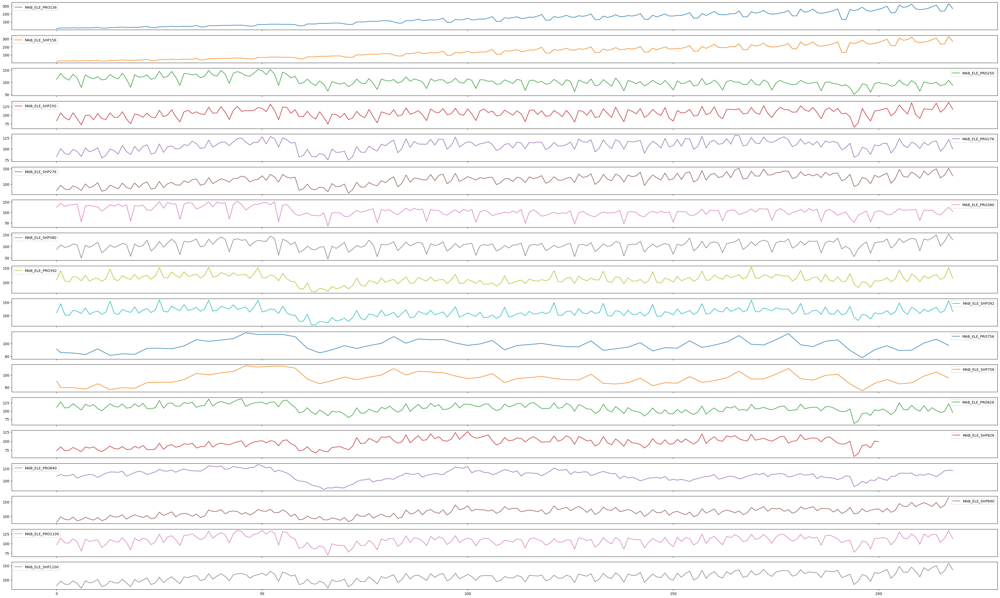

In [131]:
df_prod_ship.info()
df_prod_ship.describe()
df_prod_ship.isna().sum()
df_prod_ship.plot(subplots=True, figsize=(50, 30))  # Visual overview


Missing values are present in some columns (MAB_ELE_PRO756, MAB_ELE_SHP756, MAB_ELE_SHP826, MAB_ELE_SHP840).
No extreme outliers stand out visually, but we should confirm with statistical methods.
Trends look stable, meaning we can use time-series-based methods for handling missing values.


### Identify Outliers

In [132]:
def detect_outliers_iqr(df):
    outliers = {}
    for col in df.columns[1:]:  # Skip 'date' column
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR
        outliers[col] = df[(df[col] < lower) | (df[col] > upper)].shape[0]  # Count outliers
    return outliers

outlier_counts = detect_outliers_iqr(df_prod_ship)
print(outlier_counts)


{'MAB_ELE_PRO156': 0, 'MAB_ELE_SHP156': 0, 'MAB_ELE_PRO250': 9, 'MAB_ELE_SHP250': 1, 'MAB_ELE_PRO276': 2, 'MAB_ELE_SHP276': 0, 'MAB_ELE_PRO380': 17, 'MAB_ELE_SHP380': 8, 'MAB_ELE_PRO392': 10, 'MAB_ELE_SHP392': 11, 'MAB_ELE_PRO756': 0, 'MAB_ELE_SHP756': 0, 'MAB_ELE_PRO826': 2, 'MAB_ELE_SHP826': 1, 'MAB_ELE_PRO840': 5, 'MAB_ELE_SHP840': 1, 'MAB_ELE_PRO1100': 4, 'MAB_ELE_SHP1100': 1}


In [133]:
# Capping Outliers
def cap_outliers(df):
    for col in df.columns[1:]:  # Skip 'date'
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR
        df[col] = df[col].clip(lower, upper)  # Capping outliers
    return df

df_prod_ship = cap_outliers(df_prod_ship)


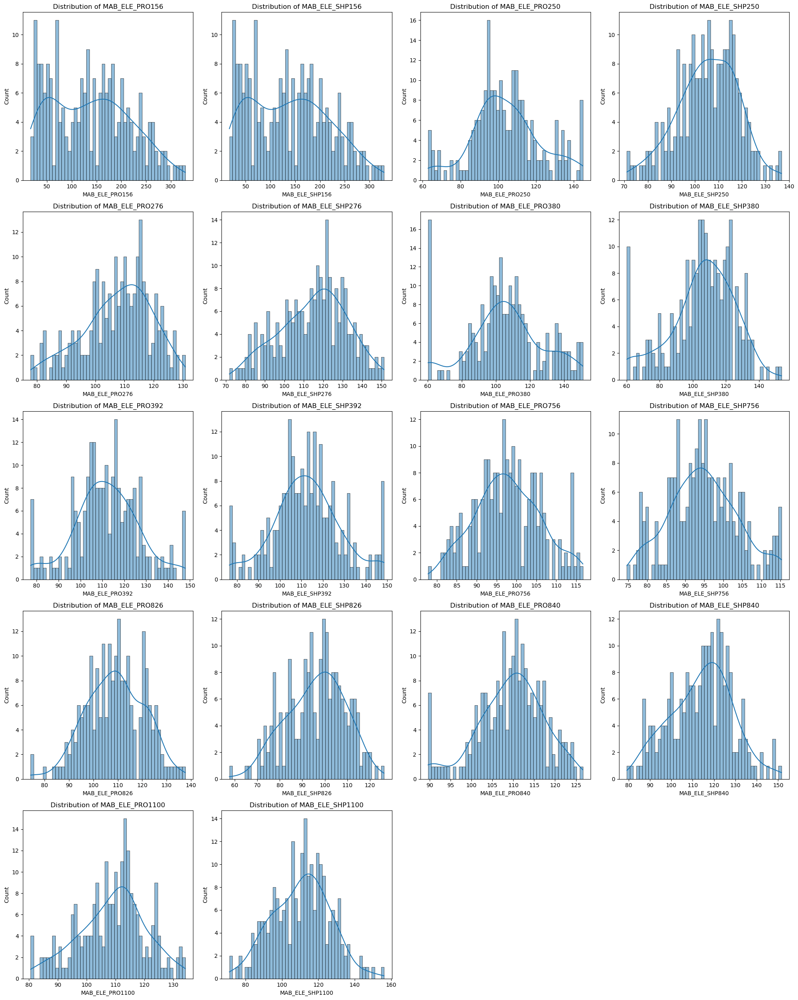

In [134]:
#Checking for skewdness
# Define number of rows and columns for the grid
num_cols = 4  # Number of columns in the grid
num_rows = int(np.ceil(len(df_prod_ship.columns[1:]) / num_cols))  # Adjust rows based on number of features

# Create subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 5 * num_rows))  # Adjust figure size

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns and plot
for i, col in enumerate(df_prod_ship.columns[1:]):
    sns.histplot(df_prod_ship[col], bins=50, kde=True, ax=axes[i])
    axes[i].set_title(f"Distribution of {col}")

# Remove any empty subplots (if total columns are not a multiple of num_cols)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])  # Remove empty plots

plt.tight_layout()  # Adjust layout to avoid overlap
plt.show()


Since most distributions look symmetric or slightly skewed, applying a log transformation wouldn’t improve things much.

### Handle Missing values 

In [135]:
# check missing values
missing_values = df_prod_ship.isnull().sum()
missing_values[missing_values > 0]

MAB_ELE_PRO756     1
MAB_ELE_SHP756     1
MAB_ELE_SHP826    18
MAB_ELE_SHP840     1
dtype: int64

In [136]:
#missing production data is likely to continue trends from past values.
df_prod_ship.fillna(method='ffill', inplace=True)

#Applying Linear Interpolation for smoother transitions
df_prod_ship.interpolate(method='linear', inplace=True)

/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2836412164.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_prod_ship.fillna(method='ffill', inplace=True)
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2836412164.py:5: FutureWarning: DataFrame.interpolate with object dtype is deprecated and will raise in a future version. Call obj.infer_objects(copy=False) before interpolating instead.
  df_prod_ship.interpolate(method='linear', inplace=True)


In [137]:
# check missing values
missing_values = df_prod_ship.isnull().sum()
missing_values[missing_values > 0]

Series([], dtype: int64)

## df_prices

In [138]:
# load df_prices dataset
df_prices = pd.read_csv("Prices_of_Materials.csv")

In [139]:
#head of df_prices
df_prices.head()

,date,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org
0,2004-02-01,54.0398,44.1233,48.7479,87.0770,39.6395,36.6238,1.2646
1,2004-03-01,54.6662,47.5890,49.2562,87.1927,42.5920,39.9311,1.2262
2,2004-04-01,54.8727,47.7790,49.4238,91.3799,42.6506,39.1349,1.1985
3,2004-05-01,51.2304,53.5909,46.4684,99.0445,47.5171,36.2784,1.2007
4,2004-06-01,52.8763,50.7996,47.8039,98.6363,44.9676,35.6574,1.2138


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 8 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   date                    219 non-null    object 
 1   RohiBASEMET1000_org     219 non-null    float64
 2   RohiENERGY1000_org      219 non-null    float64
 3   RohiMETMIN1000_org      219 non-null    float64
 4   RohiNATGAS1000_org      219 non-null    float64
 5   RohCRUDE_PETRO1000_org  219 non-null    float64
 6   RohCOPPER1000_org       219 non-null    float64
 7   WKLWEUR840_org          219 non-null    float64
dtypes: float64(7), object(1)
memory usage: 13.8+ KB


array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >], dtype=object)

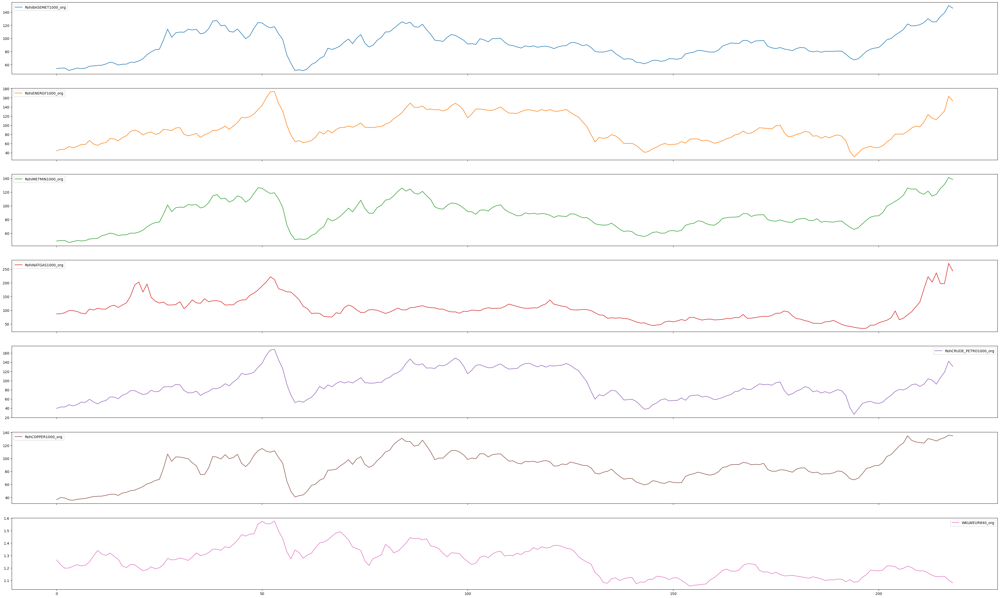

In [140]:
df_prices.info()
df_prices.describe()
df_prices.isna().sum()
df_prices.plot(subplots=True, figsize=(50, 30))  # Visual overview


* No missing values

### Handling Outliers

In [141]:
#ckecking for outliers using the previous function

outlier_counts = detect_outliers_iqr(df_prices)
print(outlier_counts)


{'RohiBASEMET1000_org': 2, 'RohiENERGY1000_org': 0, 'RohiMETMIN1000_org': 0, 'RohiNATGAS1000_org': 13, 'RohCRUDE_PETRO1000_org': 0, 'RohCOPPER1000_org': 0, 'WKLWEUR840_org': 0}


Prices fluctuate due to supply, demand, and external shocks (e.g., oil crises, wars, inflation).
ARIMA expects real market variations, so removing true price spikes may hurt forecasting accuracy.
Therefore, instead of capping all outliers, we will only cap those in RohiNATGAS1000_org that exceed 3x the IQR range (very extreme cases)


In [142]:
def cap_extreme_outliers(df, columns, factor=3):
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - factor * IQR
        upper = Q3 + factor * IQR
        df[col] = df[col].clip(lower, upper)  # Capping extreme outliers
    return df

# Apply only to RohiNATGAS1000_org
df_prices = cap_extreme_outliers(df_prices, ['RohiNATGAS1000_org'])


## df_producer_prices

In [143]:
# load df_producer_prices dataset
df_producer_prices = pd.read_csv("Producer_Prices.csv")

In [144]:
# head of df_producer_prices
df_producer_prices.head()

,date,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org
0,2004-02-01,78.9699,80.7574,93.0200,NaN,93.2305,NaN
1,2004-03-01,79.6736,80.9621,93.5403,NaN,93.3357,NaN
2,2004-04-01,80.3376,80.7574,93.8524,NaN,93.4409,NaN
3,2004-05-01,80.7988,80.7574,93.8524,NaN,93.5461,NaN
4,2004-06-01,80.9135,80.5527,93.9565,NaN,93.4409,NaN


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   date          219 non-null    object 
 1   PRI27840_org  219 non-null    float64
 2   PRI27826_org  201 non-null    float64
 3   PRI27380_org  219 non-null    float64
 4   PRI27250_org  184 non-null    float64
 5   PRI27276_org  219 non-null    float64
 6   PRI27156_org  196 non-null    float64
dtypes: float64(6), object(1)
memory usage: 12.1+ KB


array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >],
      dtype=object)

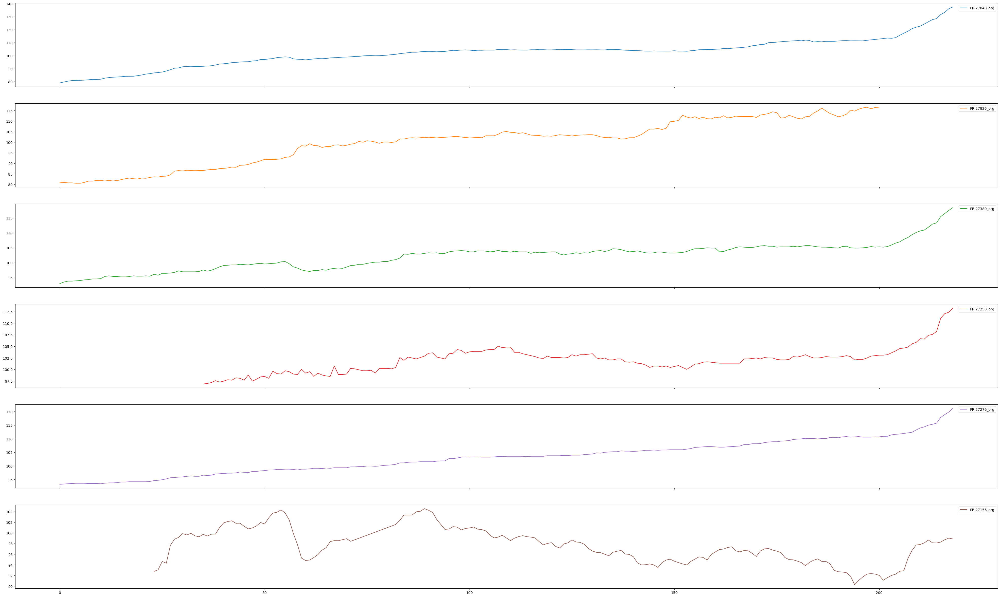

In [145]:
df_producer_prices.info()
df_producer_prices.describe()
df_producer_prices.isna().sum()
df_producer_prices.plot(subplots=True, figsize=(50, 30))  # Visual overview

### Handling Outliers

In [146]:
#ckecking for outliers using the previous function

outlier_counts = detect_outliers_iqr(df_producer_prices)
print(outlier_counts)

{'PRI27840_org': 32, 'PRI27826_org': 0, 'PRI27380_org': 4, 'PRI27250_org': 7, 'PRI27276_org': 2, 'PRI27156_org': 0}


Since producer prices follow gradual trends, extreme spikes are likely anomalies rather than market-driven events.

In [147]:
def cap_outliers(df, columns):
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR
        df[col] = df[col].clip(lower, upper)  # Capping extreme outliers
    return df

# Apply capping only to the features with high outlier counts
df_producer_prices = cap_outliers(df_producer_prices, ['PRI27840_org', 'PRI27250_org'])


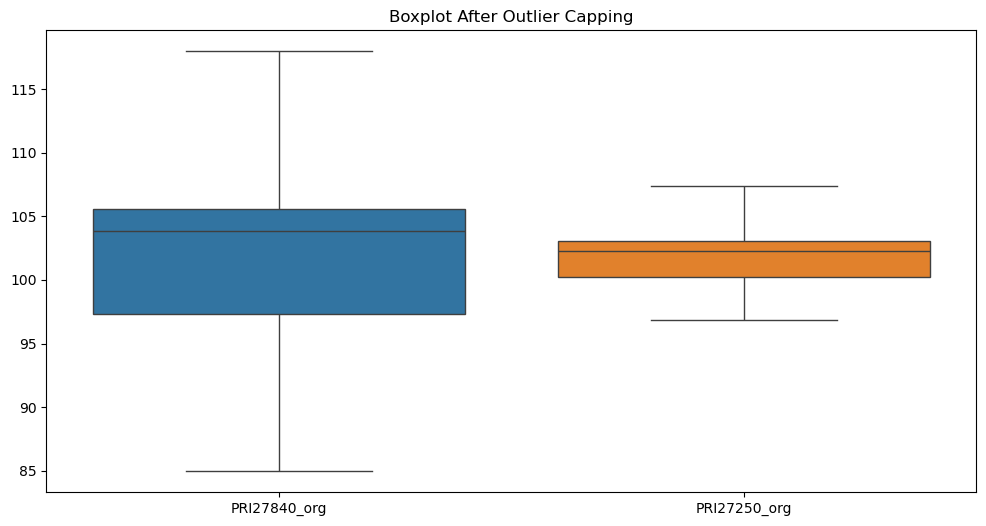

In [148]:
#Visualising
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_producer_prices[['PRI27840_org', 'PRI27250_org']])
plt.title("Boxplot After Outlier Capping")
plt.show()


Decision for Remaining Outliers
1️- Keep PRI27276_org as is → Only 2 outliers, likely small impact
2️- Keep PRI27380_org unless extreme → If they don’t affect trendlines, leave them

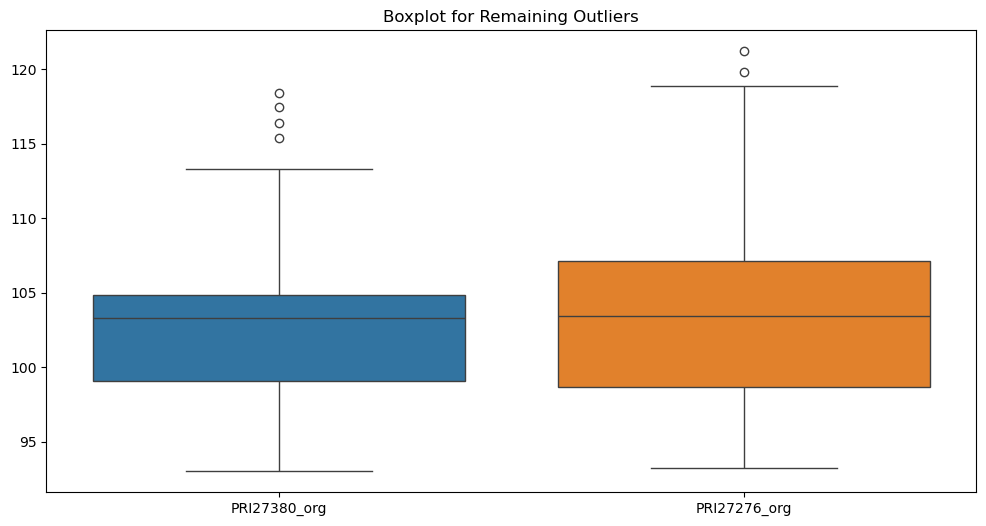

In [149]:

plt.figure(figsize=(12, 6))
sns.boxplot(data=df_producer_prices[['PRI27380_org', 'PRI27276_org']])
plt.title("Boxplot for Remaining Outliers")
plt.show()


In [150]:
# Capping Mild Outliers
def cap_mild_outliers(df, columns, factor=3):  # Using a higher factor to preserve more data
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - factor * IQR
        upper = Q3 + factor * IQR
        df[col] = df[col].clip(lower, upper)
    return df

df_producer_prices = cap_mild_outliers(df_producer_prices, ['PRI27380_org', 'PRI27276_org'])

### Handling Missing Values

In [151]:
#check missing values
missing_values = df_producer_prices.isnull().sum()
missing_values[missing_values > 0]

PRI27826_org    18
PRI27250_org    35
PRI27156_org    23
dtype: int64

Since this is producer price data, the best approach is to use trend-based methods (not random filling).

In [152]:
# Forward Fill (ffill) to propagate previous values
df_producer_prices.fillna(method='ffill', inplace=True)

# Linear Interpolation for smoother transitions
df_producer_prices.interpolate(method='linear', inplace=True)

# Rolling Mean for `PRI27250_org` (as it has the most missing values)
df_producer_prices['PRI27250_org'] = df_producer_prices['PRI27250_org'].fillna(
    df_producer_prices['PRI27250_org'].rolling(3, min_periods=1).mean()
)
# Backward Fill (bfill) to handle any remaining NaNs
df_producer_prices.fillna(method='bfill', inplace=True)

print(df_producer_prices.isna().sum())



date            0
PRI27840_org    0
PRI27826_org    0
PRI27380_org    0
PRI27250_org    0
PRI27276_org    0
PRI27156_org    0
dtype: int64


/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2867412135.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_producer_prices.fillna(method='ffill', inplace=True)
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2867412135.py:5: FutureWarning: DataFrame.interpolate with object dtype is deprecated and will raise in a future version. Call obj.infer_objects(copy=False) before interpolating instead.
  df_producer_prices.interpolate(method='linear', inplace=True)
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2867412135.py:12: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_producer_prices.fillna(method='bfill', inplace=True)


## df_production_index

In [153]:
#load df_producer_prices dataset
df_production_index = pd.read_csv("Production_Index.csv")

In [154]:
#head of df_production_prices
df_production_index.head()

,date,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org
0,2004-02-01,102.4917,97.5974,97.1000,106.1920,116.7903,110.8900,118.2741,80.8290,117.7240,NaN,81.1000,120.7065,141.5109,106.1613,102.0771,85.9132
1,2004-03-01,105.6275,113.2249,91.1951,121.6251,139.2884,141.1769,148.1218,102.1301,119.2208,NaN,76.6903,138.3095,152.8802,140.2887,117.2257,97.6708
2,2004-04-01,103.4850,100.1691,93.7935,104.9655,125.2896,105.6488,125.4822,90.9614,117.4411,NaN,71.5524,115.5573,137.7969,106.2712,105.3358,87.2540
3,2004-05-01,103.6439,99.5814,96.3920,105.8854,131.9890,101.9904,116.6497,88.0829,117.8992,NaN,66.4145,119.2695,143.8605,101.6087,96.6165,84.6756
4,2004-06-01,106.0627,109.2777,98.9904,118.2523,132.9889,122.1366,143.2487,100.9787,119.4991,NaN,61.2766,128.8494,144.3153,116.6552,118.4587,95.4018


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date           219 non-null    object 
 1   PRO28840_org   219 non-null    float64
 2   PRO281000_org  219 non-null    float64
 3   PRO28756_org   218 non-null    float64
 4   PRO28826_org   219 non-null    float64
 5   PRO28380_org   219 non-null    float64
 6   PRO28392_org   219 non-null    float64
 7   PRO28250_org   219 non-null    float64
 8   PRO28276_org   219 non-null    float64
 9   PRO27840_org   219 non-null    float64
 10  PRO271000_org  208 non-null    float64
 11  PRO27756_org   218 non-null    float64
 12  PRO27826_org   219 non-null    float64
 13  PRO27380_org   219 non-null    float64
 14  PRO27392_org   219 non-null    float64
 15  PRO27250_org   219 non-null    float64
 16  PRO27276_org   219 non-null    float64
dtypes: float64(16), object(1)
memory usage: 29.2+ KB


array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >], dtype=object)

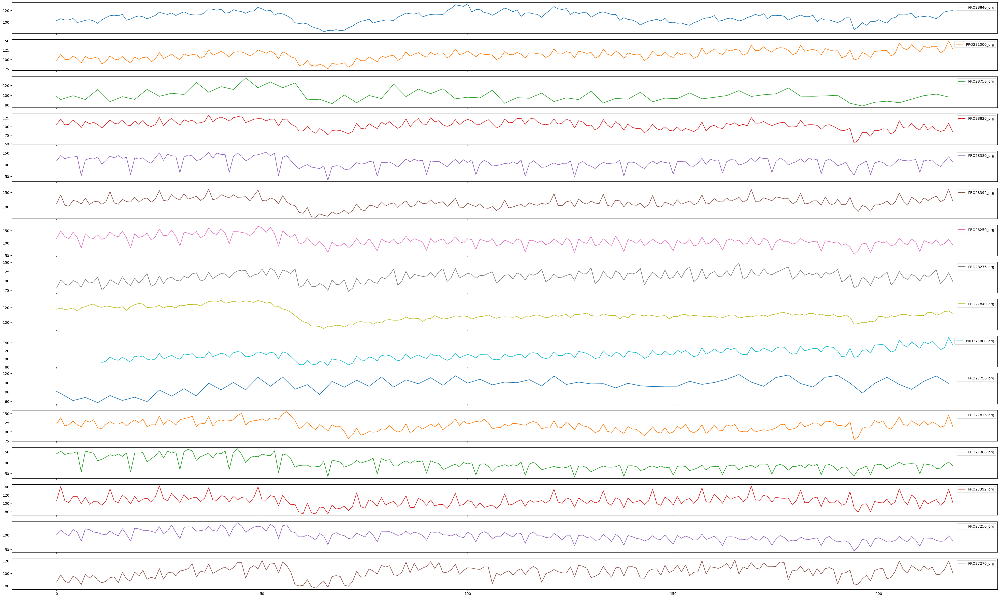

In [155]:
df_production_index.info()
df_production_index.describe()
df_production_index.isna().sum()
df_production_index.plot(subplots=True, figsize=(50, 30))  # Visual overview

In [156]:
outlier_counts = detect_outliers_iqr(df_production_index)
print(outlier_counts)

{'PRO28840_org': 1, 'PRO281000_org': 3, 'PRO28756_org': 8, 'PRO28826_org': 2, 'PRO28380_org': 14, 'PRO28392_org': 9, 'PRO28250_org': 7, 'PRO28276_org': 2, 'PRO27840_org': 1, 'PRO271000_org': 5, 'PRO27756_org': 21, 'PRO27826_org': 2, 'PRO27380_org': 2, 'PRO27392_org': 8, 'PRO27250_org': 1, 'PRO27276_org': 0}


High outlier counts in:

- PRO27756_org (21 outliers)
- PRO28380_org (14 outliers)
- PRO28392_org (9 outliers)

Moderate outlier counts in:

- PRO28756_org, PRO27392_org, PRO28250_org (7-8 outliers)

Low outlier counts in:

- PRO28840_org, PRO28826_org, PRO27840_org, PRO271000_org, PRO27826_org, PRO27380_org, PRO27250_org (1-5 outliers)

In [157]:
#check missing values
missing_values = df_production_index.isnull().sum()
missing_values[missing_values > 0]

PRO28756_org      1
PRO271000_org    11
PRO27756_org      1
dtype: int64

In [1]:
# For HIGH outliers
def cap_outliers(df, columns, factor=1.5):  
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - factor * IQR
        upper = Q3 + factor * IQR
        df[col] = df[col].clip(lower, upper)  # Capping outliers
    return df

df_production_index = cap_outliers(df_production_index, ['PRO27756_org', 'PRO28380_org', 'PRO28392_org'])


NameError: name 'df_production_index' is not defined

In [159]:
# For Moderate outliers
df_production_index = cap_outliers(df_production_index, ['PRO28756_org', 'PRO27392_org', 'PRO28250_org'], factor=3)


For low outliers, we will keep the natural variations

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15],
 [Text(0, 0, 'PRO28840_org'),
  Text(1, 0, 'PRO281000_org'),
  Text(2, 0, 'PRO28756_org'),
  Text(3, 0, 'PRO28826_org'),
  Text(4, 0, 'PRO28380_org'),
  Text(5, 0, 'PRO28392_org'),
  Text(6, 0, 'PRO28250_org'),
  Text(7, 0, 'PRO28276_org'),
  Text(8, 0, 'PRO27840_org'),
  Text(9, 0, 'PRO271000_org'),
  Text(10, 0, 'PRO27756_org'),
  Text(11, 0, 'PRO27826_org'),
  Text(12, 0, 'PRO27380_org'),
  Text(13, 0, 'PRO27392_org'),
  Text(14, 0, 'PRO27250_org'),
  Text(15, 0, 'PRO27276_org')])

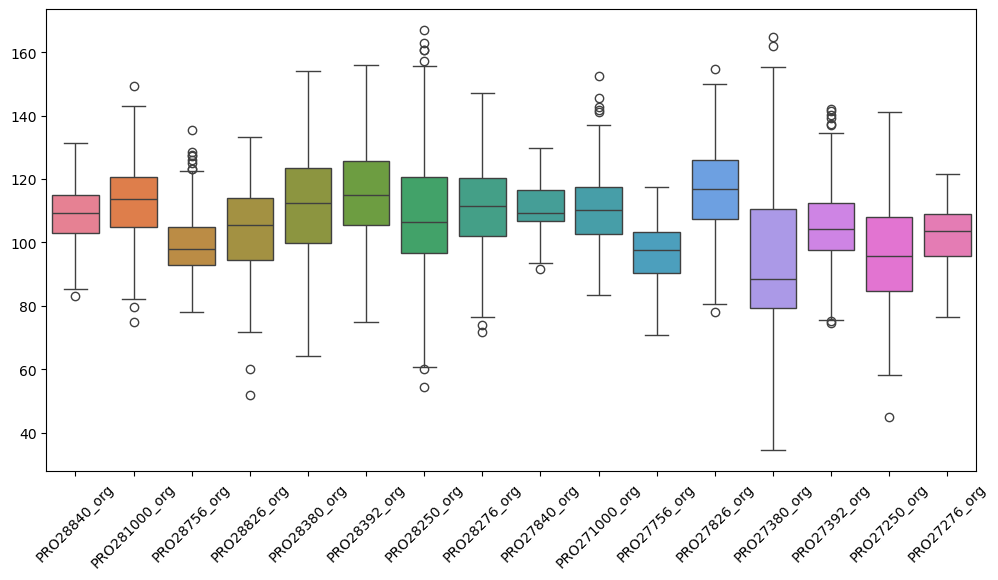

In [160]:
#check outliers
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_production_index.iloc[:, 1:])
plt.xticks(rotation=45)

In [161]:
# check missing values
missing_values = df_production_index.isnull().sum()
missing_values[missing_values > 0]

PRO28756_org      1
PRO271000_org    11
PRO27756_org      1
dtype: int64

In [162]:
# 1Forward Fill
df_production_index.fillna(method='ffill', inplace=True)

# Linear Interpolation
df_production_index.interpolate(method='linear', inplace=True)

# Backward Fill
df_production_index.fillna(method='bfill', inplace=True)

print(df_production_index.isna().sum()) 


date             0
PRO28840_org     0
PRO281000_org    0
PRO28756_org     0
PRO28826_org     0
PRO28380_org     0
PRO28392_org     0
PRO28250_org     0
PRO28276_org     0
PRO27840_org     0
PRO271000_org    0
PRO27756_org     0
PRO27826_org     0
PRO27380_org     0
PRO27392_org     0
PRO27250_org     0
PRO27276_org     0
dtype: int64


/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/1277196946.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_production_index.fillna(method='ffill', inplace=True)
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/1277196946.py:5: FutureWarning: DataFrame.interpolate with object dtype is deprecated and will raise in a future version. Call obj.infer_objects(copy=False) before interpolating instead.
  df_production_index.interpolate(method='linear', inplace=True)
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/1277196946.py:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_production_index.fillna(method='bfill', inplace=True)


# TODO FORECASTING NEXT 4 MONTHS

### Forecasting df_prod_ship

In [56]:
print(df_prod_ship.head())

         date  MAB_ELE_PRO156  MAB_ELE_SHP156  MAB_ELE_PRO250  MAB_ELE_SHP250  \
0  2004-02-01         16.9407         16.9407        112.0913         83.4589   
1  2004-03-01         23.7119         23.7119        136.3280        106.1682   
2  2004-04-01         24.4352         24.4352        117.7918         92.0076   
3  2004-05-01         23.7081         23.7081        109.0025         85.6965   
4  2004-06-01         27.0091         27.0091        133.7857        106.6415   

   MAB_ELE_PRO276  MAB_ELE_SHP276  MAB_ELE_PRO380  MAB_ELE_SHP380  \
0         82.6230         79.4525        124.2896         86.5605   
1        100.5566         97.0129        143.4117        106.3445   
2         89.6532         84.9324        129.0838         95.5797   
3         86.8806         82.3728        135.5904        100.0870   
4         99.0108         95.1087        136.4249        110.8897   

   MAB_ELE_PRO392  MAB_ELE_SHP392  MAB_ELE_PRO756  MAB_ELE_SHP756  \
0        109.3340        110.

In [126]:
pip install pmdarima matplotlib statsmodels

Note: you may need to restart the kernel to use updated packages.


In [57]:
# Check structure
print(df_prod_ship.head())


         date  MAB_ELE_PRO156  MAB_ELE_SHP156  MAB_ELE_PRO250  MAB_ELE_SHP250  \
0  2004-02-01         16.9407         16.9407        112.0913         83.4589   
1  2004-03-01         23.7119         23.7119        136.3280        106.1682   
2  2004-04-01         24.4352         24.4352        117.7918         92.0076   
3  2004-05-01         23.7081         23.7081        109.0025         85.6965   
4  2004-06-01         27.0091         27.0091        133.7857        106.6415   

   MAB_ELE_PRO276  MAB_ELE_SHP276  MAB_ELE_PRO380  MAB_ELE_SHP380  \
0         82.6230         79.4525        124.2896         86.5605   
1        100.5566         97.0129        143.4117        106.3445   
2         89.6532         84.9324        129.0838         95.5797   
3         86.8806         82.3728        135.5904        100.0870   
4         99.0108         95.1087        136.4249        110.8897   

   MAB_ELE_PRO392  MAB_ELE_SHP392  MAB_ELE_PRO756  MAB_ELE_SHP756  \
0        109.3340        110.

In [58]:
import pandas as pd
from statsmodels.tsa.stattools import adfuller
from pmdarima import auto_arima
import matplotlib.pyplot as plt

In [59]:


# Step 1: Ensure 'date' column is datetime and set as index
df_prod_ship['date'] = pd.to_datetime(df_prod_ship['date'])
df_prod_ship.set_index('date', inplace=True)
df_prod_ship.index.name = 'date'

# Step 2: Forecast config
forecast_horizon = 10
adf_results = {}
sarima_models = {}
future_forecasts = {}

In [61]:
# Loop through each time series column
for col in df_prod_ship.columns:
    print(f"\n📈 Forecasting: {col}")
    
    ts = df_prod_ship[col]

    # Ensure index is datetime 
    ts.index = pd.to_datetime(ts.index)

    # ADF test for stationarity 
    try:
        adf_stat, p_value, _, _, _, _ = adfuller(ts)
        adf_results[col] = {'ADF Statistic': adf_stat, 'p-value': p_value}
        print(f"  ADF p-value: {p_value:.4f}")
    except Exception as e:
        print(f"  ⚠️ ADF test failed for {col}: {e}")

    # Fit SARIMA model
    try:
        model = auto_arima(
            ts,
            seasonal=True,
            m=12,  # Monthly seasonality
            stepwise=True,
            suppress_warnings=True,
            trace=False,
            max_p=3, max_q=3, max_P=2, max_Q=2, max_order=10,
            n_jobs=-1
        )

        sarima_models[col] = model

        # Forecast next 10 months
        forecast = model.predict(n_periods=forecast_horizon)

        # Generate correct future monthly dates
        last_date = ts.index[-1]
        future_dates = pd.date_range(start=last_date + pd.DateOffset(months=1),
                                     periods=forecast_horizon, freq='MS')

        # Create forecast series
        forecast_series = pd.Series(forecast, index=future_dates)

        # Prepend the last historical value if not already present
        last_value = ts.iloc[-1]
        last_date = ts.index[-1]
        if last_date not in forecast_series.index:
            forecast_series = pd.concat([pd.Series([last_value], index=[last_date]), forecast_series])

        # Drop duplicates just in case
        forecast_series = forecast_series[~forecast_series.index.duplicated(keep='first')]

        # Save final forecast series
        future_forecasts[col] = forecast_series


    except Exception as e:
        print(f"  ❌ SARIMA model failed for {col}: {e}")
        continue




📈 Forecasting: MAB_ELE_PRO156
  ADF p-value: 0.9853


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_SHP156
  ADF p-value: 0.9853


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_PRO250
  ADF p-value: 0.3359


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_SHP250
  ADF p-value: 0.0377


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_PRO276
  ADF p-value: 0.0004


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_SHP276
  ADF p-value: 0.0804


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_PRO380
  ADF p-value: 0.2499


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_SHP380
  ADF p-value: 0.2938


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_PRO392
  ADF p-value: 0.0343


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_SHP392
  ADF p-value: 0.0142


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_PRO756
  ADF p-value: 0.0001


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '
/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_auto_solvers.py:524: ModelFitWarning: Error fitting  ARIMA(3,0,2)(2,0,1)[12] intercept (if you do not want to see these warnings, run with error_action="ignore").
Traceback:
Traceback (most recent call last):
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_auto_solvers.py", line 508, in _fit_candidate_model
    fit.fit(y, X=X, **fit_params)
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/arima.py", line 603, in fit
    self._fit(y, X, **fit_args)
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/arima.py", line 524, in _fit
    fit, self.arima_res_ = _fit_wr


📈 Forecasting: MAB_ELE_SHP756
  ADF p-value: 0.0002


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '
/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_auto_solvers.py:524: ModelFitWarning: Error fitting  ARIMA(2,0,1)(2,0,1)[12] intercept (if you do not want to see these warnings, run with error_action="ignore").
Traceback:
Traceback (most recent call last):
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_auto_solvers.py", line 508, in _fit_candidate_model
    fit.fit(y, X=X, **fit_params)
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/arima.py", line 603, in fit
    self._fit(y, X, **fit_args)
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/arima.py", line 524, in _fit
    fit, self.arima_res_ = _fit_wr


📈 Forecasting: MAB_ELE_PRO826
  ADF p-value: 0.0794

📈 Forecasting: MAB_ELE_SHP826
  ADF p-value: 0.0957


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_PRO840
  ADF p-value: 0.0004


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_SHP840
  ADF p-value: 0.4763


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_PRO1100
  ADF p-value: 0.0127


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: MAB_ELE_SHP1100
  ADF p-value: 0.3560


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '


In [62]:
# Combine all forecasts into one DataFrame
forecast_df_prod_ship = pd.DataFrame(future_forecasts)
forecast_df_prod_ship.index.name = 'date'

In [63]:
# Preview and save
print("\n✅ Forecasting complete! Here's a preview:")
print(forecast_df_prod_ship.head())


✅ Forecasting complete! Here's a preview:
            MAB_ELE_PRO156  MAB_ELE_SHP156  MAB_ELE_PRO250  MAB_ELE_SHP250  \
date                                                                         
2022-04-01        267.3731        267.3731         87.6981        116.5287   
2022-05-01        284.6931        284.6931         85.9201        113.8309   
2022-06-01        318.8517        318.8517        105.4241        138.8031   
2022-07-01        268.8731        268.8731         93.9545        116.0129   
2022-08-01        260.8095        260.8095         63.8004        101.5159   

            MAB_ELE_PRO276  MAB_ELE_SHP276  MAB_ELE_PRO380  MAB_ELE_SHP380  \
date                                                                         
2022-04-01         99.5222        127.0229        103.5567        128.7333   
2022-05-01         99.0532        132.1068        113.7166        140.2089   
2022-06-01        113.4746        145.3346        110.9762        152.4625   
2022-07-01        10

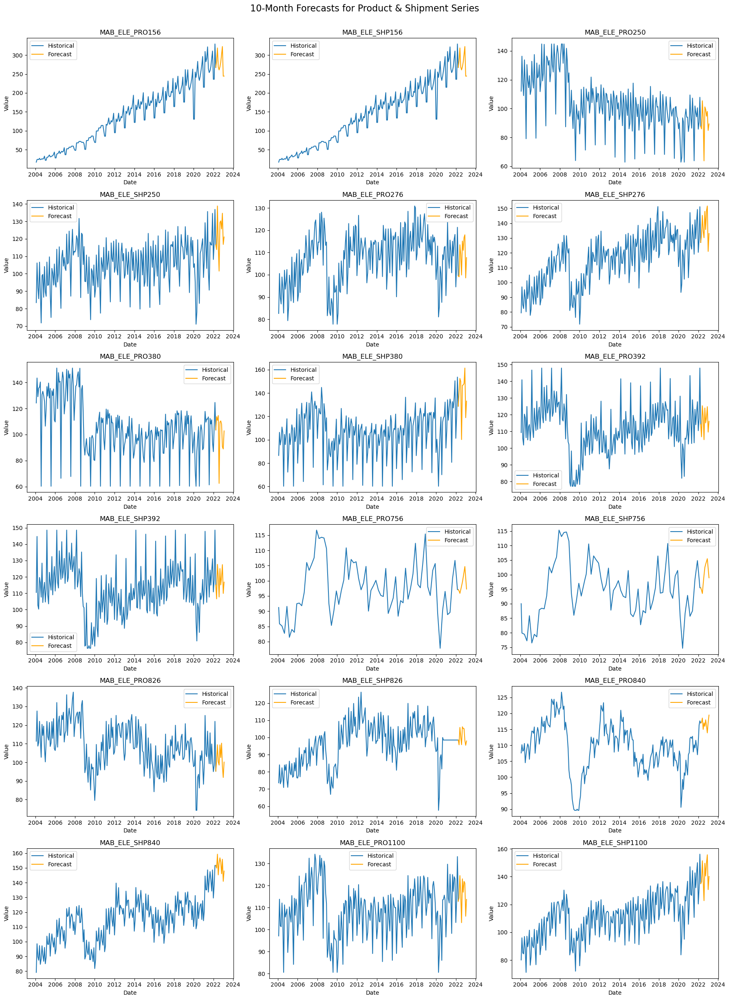

In [64]:
import matplotlib.pyplot as plt
import math

# Define columns to plot (all forecasted columns)
cols = forecast_df_prod_ship.columns
n_cols = 3  # 3 plots per row
n_rows = math.ceil(len(cols) / n_cols)

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()

# Plot each column in its subplot
for i, col in enumerate(cols):
    ax = axes[i]
    ax.plot(df_prod_ship[col], label='Historical')
    ax.plot(forecast_df_prod_ship[col], label='Forecast', color='orange')
    ax.set_title(f"{col}")
    ax.set_xlabel("Date")
    ax.set_ylabel("Value")
    ax.legend()

# Hide unused subplots if any
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle("10-Month Forecasts for Product & Shipment Series", fontsize=16, y=1.02)
plt.show()


In [65]:
forecast_df_prod_ship.to_csv("forecast_df_prod_ship_10_months.csv")

### Forecasting df_prices

In [68]:
# Ensure 'date' column is datetime and set as index
df_prices['date'] = pd.to_datetime(df_prices['date'])
df_prices.set_index('date', inplace=True)
df_prices.index.name = 'date'

# Forecast config
forecast_horizon = 10
adf_results = {}
sarima_models = {}
future_forecasts = {}

KeyError: 'date'

In [69]:
# Loop through each time series column
for col in df_prices.columns:
    print(f"\n📈 Forecasting: {col}")
    
    ts = df_prices[col]

    # Ensure index is datetime 
    ts.index = pd.to_datetime(ts.index)

    # ADF test for stationarity 
    try:
        adf_stat, p_value, _, _, _, _ = adfuller(ts)
        adf_results[col] = {'ADF Statistic': adf_stat, 'p-value': p_value}
        print(f"  ADF p-value: {p_value:.4f}")
    except Exception as e:
        print(f"  ⚠️ ADF test failed for {col}: {e}")

    # Fit SARIMA model
    try:
        model = auto_arima(
            ts,
            seasonal=True,
            m=12,  # Monthly seasonality
            stepwise=True,
            suppress_warnings=True,
            trace=False,
            max_p=3, max_q=3, max_P=2, max_Q=2, max_order=10,
            n_jobs=-1
        )

        sarima_models[col] = model

        # Forecast next 10 months
        forecast = model.predict(n_periods=forecast_horizon)

        # Generate correct future monthly dates
        last_date = ts.index[-1]
        future_dates = pd.date_range(start=last_date + pd.DateOffset(months=1),
                                     periods=forecast_horizon, freq='MS')

        # Create forecast series
        forecast_series = pd.Series(forecast, index=future_dates)

        # Prepend last value to ensure continuity (if needed)
        last_value = ts.iloc[-1]
        last_date = ts.index[-1]
        if last_date not in forecast_series.index:
            forecast_series = pd.concat([pd.Series([last_value], index=[last_date]), forecast_series])

        # Drop any duplicates (just in case)
        forecast_series = forecast_series[~forecast_series.index.duplicated(keep='first')]

        # Store the result
        future_forecasts[col] = forecast_series


    except Exception as e:
        print(f"  ❌ SARIMA model failed for {col}: {e}")
        continue




📈 Forecasting: RohiBASEMET1000_org
  ADF p-value: 0.2565


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: RohiENERGY1000_org
  ADF p-value: 0.0903


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: RohiMETMIN1000_org
  ADF p-value: 0.2063


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: RohiNATGAS1000_org
  ADF p-value: 0.3058


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: RohCRUDE_PETRO1000_org
  ADF p-value: 0.0320


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: RohCOPPER1000_org
  ADF p-value: 0.1248


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: WKLWEUR840_org
  ADF p-value: 0.4513


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '


In [70]:
# Combine all forecasts into one DataFrame
forecast_df_prices = pd.DataFrame(future_forecasts)
forecast_df_prices.index.name = 'date'

In [71]:
# Preview and save
print("\n✅ Forecasting complete! Here's a preview:")
print(forecast_df_prices.head())


✅ Forecasting complete! Here's a preview:
            RohiBASEMET1000_org  RohiENERGY1000_org  RohiMETMIN1000_org  \
date                                                                      
2022-04-01             146.0910            153.1889            138.0941   
2022-05-01             143.7657            149.5110            135.5027   
2022-06-01             141.6237            148.1581            133.2085   
2022-07-01             139.3349            147.6603            131.0895   
2022-08-01             136.8285            147.4772            129.0942   

            RohiNATGAS1000_org  RohCRUDE_PETRO1000_org  RohCOPPER1000_org  \
date                                                                        
2022-04-01            243.4360                130.8354           134.8597   
2022-05-01            249.1918                125.9050           133.8177   
2022-06-01            246.6968                121.3776           134.0765   
2022-07-01            236.9966                

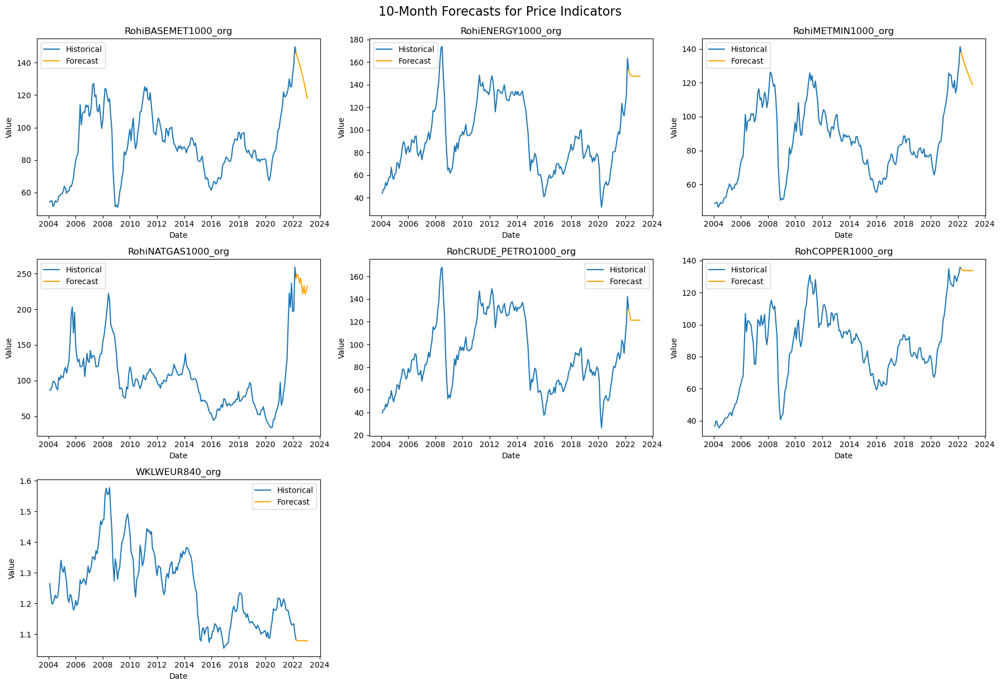

In [72]:
import matplotlib.pyplot as plt
import math

# Define the columns and grid layout
cols = forecast_df_prices.columns
n_cols = 3  # plots per row
n_rows = math.ceil(len(cols) / n_cols)

# Create the figure and axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()

#  Plot each forecast vs. historical
for i, col in enumerate(cols):
    ax = axes[i]
    ax.plot(df_prices[col], label='Historical')
    ax.plot(forecast_df_prices[col], label='Forecast', color='orange')
    ax.set_title(col)
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.legend()

# Hide unused subplots 
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle("10-Month Forecasts for Price Indicators", fontsize=16, y=1.02)
plt.show()


In [73]:
forecast_df_prices.to_csv("forecast_df_prices_10_months.csv")


### df_producer_prices forecast 

In [74]:
# Ensure 'date' column is datetime and set as index
df_producer_prices['date'] = pd.to_datetime(df_producer_prices['date'])
df_producer_prices.set_index('date', inplace=True)
df_producer_prices.index.name = 'date'

# Forecast config
forecast_horizon = 10
adf_results = {}
sarima_models = {}
future_forecasts = {}

In [ ]:
# Loop through each time series column
for col in df_producer_prices.columns:
    print(f"\n📈 Forecasting: {col}")
    
    ts = df_producer_prices[col]

    # Ensure index is datetime 
    ts.index = pd.to_datetime(ts.index)

    # ADF test for stationarity 
    try:
        adf_stat, p_value, _, _, _, _ = adfuller(ts)
        adf_results[col] = {'ADF Statistic': adf_stat, 'p-value': p_value}
        print(f"  ADF p-value: {p_value:.4f}")
    except Exception as e:
        print(f"  DF test failed for {col}: {e}")

    # Fit SARIMA model
    try:
        model = auto_arima(
            ts,
            seasonal=True,
            m=12,  # Monthly seasonality
            stepwise=True,
            suppress_warnings=True,
            trace=False,
            max_p=3, max_q=3, max_P=2, max_Q=2, max_order=10,
            n_jobs=-1
        )

        sarima_models[col] = model

        # Forecast next 10 months
        forecast = model.predict(n_periods=forecast_horizon)

        # Generate correct future monthly dates
        last_date = ts.index[-1]
        future_dates = pd.date_range(start=last_date + pd.DateOffset(months=1),
                                     periods=forecast_horizon, freq='MS')

        # Save forecast series
        # Create forecast series
        forecast_series = pd.Series(forecast, index=future_dates)

        # Prepend the last actual value to the forecast series (if not already there)
        last_value = ts.iloc[-1]
        last_date = ts.index[-1]
        if last_date not in forecast_series.index:
            forecast_series = pd.concat([pd.Series([last_value], index=[last_date]), forecast_series])

        # Drop duplicate timestamps (if any)
        forecast_series = forecast_series[~forecast_series.index.duplicated(keep='first')]

        # Save clean forecast series
        future_forecasts[col] = forecast_series



    except Exception as e:
        print(f"  ❌ SARIMA model failed for {col}: {e}")
        continue




📈 Forecasting: PRI27840_org
  ADF p-value: 0.7929


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRI27826_org
  ADF p-value: 0.5866


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRI27380_org
  ADF p-value: 0.9980


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRI27250_org
  ADF p-value: 0.8188


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRI27276_org
  ADF p-value: 0.9983


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRI27156_org
  ADF p-value: 0.1005


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '


In [76]:
# Combine all forecasts into one DataFrame
forecast_df_producer_price = pd.DataFrame(future_forecasts)
forecast_df_producer_price.index.name = 'date'

In [77]:
# Preview and save
print("\n✅ Forecasting complete! Here's a preview:")
print(forecast_df_producer_price.head())


✅ Forecasting complete! Here's a preview:
            PRI27840_org  PRI27826_org  PRI27380_org  PRI27250_org  \
date                                                                 
2022-04-01      117.9743      116.2743      118.4080      107.3668   
2022-05-01      118.0469      116.4171      119.2555      107.4800   
2022-06-01      118.1442      116.5775      120.0649      107.7092   
2022-07-01      118.2683      116.7400      120.8383      107.8328   
2022-08-01      118.3994      116.9028      121.5777      108.0957   

            PRI27276_org  PRI27156_org  
date                                    
2022-04-01      121.2206       98.8571  
2022-05-01      122.4032      100.1376  
2022-06-01      123.6120      100.9050  
2022-07-01      125.0484      101.4245  
2022-08-01      126.5174      101.3794  


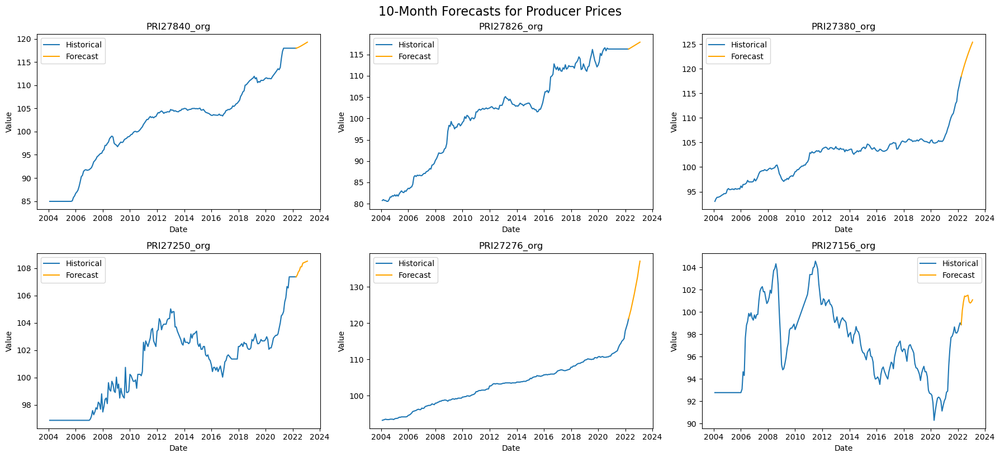

In [78]:
import matplotlib.pyplot as plt
import math

# Step 1: Define the columns to plot
cols = forecast_df_producer_price.columns
n_cols = 3  # plots per row
n_rows = math.ceil(len(cols) / n_cols)

# Step 2: Create the figure and axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()

# Step 3: Plot historical and forecast for each series
for i, col in enumerate(cols):
    ax = axes[i]
    ax.plot(df_producer_prices[col], label='Historical')
    ax.plot(forecast_df_producer_price[col], label='Forecast', color='orange')
    ax.set_title(col)
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.legend()

# Step 4: Hide unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle("10-Month Forecasts for Producer Prices", fontsize=16, y=1.02)
plt.show()


In [79]:
forecast_df_producer_price.to_csv("forecast_df_producer_price._10_months.csv")


## df_production_index

In [80]:
# Ensure 'date' column is datetime and set as index
df_production_index['date'] = pd.to_datetime(df_production_index['date'])
df_production_index.set_index('date', inplace=True)
df_production_index.index.name = 'date'

# Forecast config
forecast_horizon = 10
adf_results = {}
sarima_models = {}
future_forecasts = {}

In [81]:
# Loop through each time series column
for col in df_production_index.columns:
    print(f"\n📈 Forecasting: {col}")
    
    ts = df_production_index[col]

    # Ensure index is datetime 
    ts.index = pd.to_datetime(ts.index)

    # ADF test for stationarity 
    try:
        adf_stat, p_value, _, _, _, _ = adfuller(ts)
        adf_results[col] = {'ADF Statistic': adf_stat, 'p-value': p_value}
        print(f"  ADF p-value: {p_value:.4f}")
    except Exception as e:
        print(f"  ⚠️ ADF test failed for {col}: {e}")

    # Fit SARIMA model
    try:
        model = auto_arima(
            ts,
            seasonal=True,
            m=12,  # Monthly seasonality
            stepwise=True,
            suppress_warnings=True,
            trace=False,
            max_p=3, max_q=3, max_P=2, max_Q=2, max_order=10,
            n_jobs=-1
        )

        sarima_models[col] = model

        # Forecast next 10 months
        forecast = model.predict(n_periods=forecast_horizon)

        # Generate future dates
        last_date = ts.index[-1]
        future_dates = pd.date_range(start=last_date + pd.DateOffset(months=1),
                                     periods=forecast_horizon, freq='MS')

        # Build forecast series
        forecast_series = pd.Series(forecast, index=future_dates)

        # ✅ Prepend last historical value for continuity
        if last_date not in forecast_series.index:
            last_value = ts.iloc[-1]
            forecast_series = pd.concat([pd.Series([last_value], index=[last_date]), forecast_series])

        # ✅ Drop duplicates
        forecast_series = forecast_series[~forecast_series.index.duplicated(keep='first')]

        # ✅ Store forecast
        future_forecasts[col] = forecast_series

    except Exception as e:
        print(f"  ❌ SARIMA model failed for {col}: {e}")
        continue



📈 Forecasting: PRO28840_org
  ADF p-value: 0.0003


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '
/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_auto_solvers.py:524: ModelFitWarning: Error fitting  ARIMA(2,0,1)(2,0,0)[12] intercept (if you do not want to see these warnings, run with error_action="ignore").
Traceback:
Traceback (most recent call last):
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_auto_solvers.py", line 508, in _fit_candidate_model
    fit.fit(y, X=X, **fit_params)
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/arima.py", line 603, in fit
    self._fit(y, X, **fit_args)
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/arima.py", line 524, in _fit
    fit, self.arima_res_ = _fit_wr


📈 Forecasting: PRO281000_org
  ADF p-value: 0.2803


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO28756_org
  ADF p-value: 0.0006


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO28826_org
  ADF p-value: 0.0658


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO28380_org
  ADF p-value: 0.0400


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO28392_org
  ADF p-value: 0.0291


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO28250_org
  ADF p-value: 0.1338


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO28276_org
  ADF p-value: 0.0012


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO27840_org
  ADF p-value: 0.0348


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO271000_org
  ADF p-value: 0.8255


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO27756_org
  ADF p-value: 0.0579


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO27826_org
  ADF p-value: 0.1688


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO27380_org
  ADF p-value: 0.3577


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO27392_org
  ADF p-value: 0.1051


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO27250_org
  ADF p-value: 0.6909


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



📈 Forecasting: PRO27276_org
  ADF p-value: 0.0001


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '


In [82]:
# Combine all forecasts into one DataFrame
forecast_df_production_index = pd.DataFrame(future_forecasts)
forecast_df_production_index.name = 'date'

In [83]:
# Preview and save
print("\n✅ Forecasting complete! Here's a preview:")
print(forecast_df_production_index.head())


✅ Forecasting complete! Here's a preview:
            PRO28840_org  PRO281000_org  PRO28756_org  PRO28826_org  \
2022-04-01      119.3855       128.2857       96.3606       84.7287   
2022-05-01      118.7672       130.8178       96.1468       86.1540   
2022-06-01      121.1634       140.3997       95.1508      101.3876   
2022-07-01      112.9886       131.7008       96.6988       94.7273   
2022-08-01      116.3127       124.4353       97.7669       88.0989   

            PRO28380_org  PRO28392_org  PRO28250_org  PRO28276_org  \
2022-04-01      111.0907      120.0988       91.9797       98.6759   
2022-05-01      123.5204      113.9340       91.3847      102.1884   
2022-06-01      123.1744      132.1767      112.5278      110.8242   
2022-07-01      130.0341      125.9539      101.8101      105.2427   
2022-08-01       73.3847      114.7187       65.6103       97.1710   

            PRO27840_org  PRO271000_org  PRO27756_org  PRO27826_org  \
2022-04-01      112.1581       134.843

/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


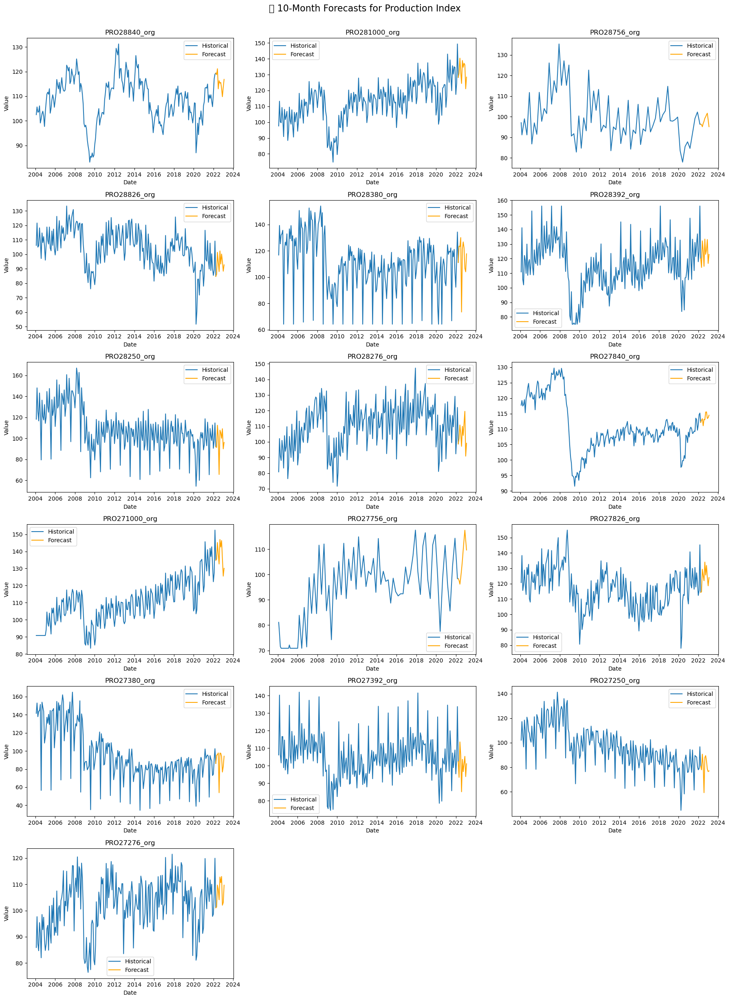

In [84]:
import matplotlib.pyplot as plt
import math

# Set up columns and grid layout
cols = forecast_df_production_index.columns
n_cols = 3  # number of plots per row
n_rows = math.ceil(len(cols) / n_cols)

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()

# Plot each column
for i, col in enumerate(cols):
    ax = axes[i]
    ax.plot(df_production_index[col], label='Historical')
    ax.plot(forecast_df_production_index[col], label='Forecast', color='orange')
    ax.set_title(col)
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.legend()

# Remove unused subplots if any
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle("📈 10-Month Forecasts for Production Index", fontsize=16, y=1.02)
plt.show()


In [85]:
forecast_df_production_index.to_csv("forecast_df_production_index._10_months.csv")


### Merge Forecasted Data with Market Data

In [33]:
import pandas as pd

# Load the forecast data
forecast_df_prod_ship = pd.read_csv("forecast_df_prod_ship_10_months.csv")
forecast_df_prices = pd.read_csv("forecast_df_prices_10_months.csv")
forecast_df_producer_price = pd.read_csv("forecast_df_producer_price._10_months.csv")
forecast_df_production_index = pd.read_csv("forecast_df_production_index._10_months.csv")

In [34]:
print(forecast_df_prod_ship.isnull().sum())
print(forecast_df_prices.isnull().sum())
print(forecast_df_producer_price.isnull().sum())
print(forecast_df_production_index.isnull().sum())


date               0
MAB_ELE_PRO156     0
MAB_ELE_SHP156     0
MAB_ELE_PRO250     0
MAB_ELE_SHP250     0
MAB_ELE_PRO276     0
MAB_ELE_SHP276     0
MAB_ELE_PRO380     0
MAB_ELE_SHP380     0
MAB_ELE_PRO392     0
MAB_ELE_SHP392     0
MAB_ELE_PRO756     0
MAB_ELE_SHP756     0
MAB_ELE_PRO826     0
MAB_ELE_SHP826     0
MAB_ELE_PRO840     0
MAB_ELE_SHP840     0
MAB_ELE_PRO1100    0
MAB_ELE_SHP1100    0
dtype: int64
date                      0
RohiBASEMET1000_org       0
RohiENERGY1000_org        0
RohiMETMIN1000_org        0
RohiNATGAS1000_org        0
RohCRUDE_PETRO1000_org    0
RohCOPPER1000_org         0
WKLWEUR840_org            0
dtype: int64
date            0
PRI27840_org    0
PRI27826_org    0
PRI27380_org    0
PRI27250_org    0
PRI27276_org    0
PRI27156_org    0
dtype: int64
Unnamed: 0       0
PRO28840_org     0
PRO281000_org    0
PRO28756_org     0
PRO28826_org     0
PRO28380_org     0
PRO28392_org     0
PRO28250_org     0
PRO28276_org     0
PRO27840_org     0
PRO271000_org    0
PRO

In [35]:
print(forecast_df_prod_ship.columns)
print(forecast_df_prices.columns)
print(forecast_df_producer_price.columns)
print(forecast_df_production_index.columns)


Index(['date', 'MAB_ELE_PRO156', 'MAB_ELE_SHP156', 'MAB_ELE_PRO250',
       'MAB_ELE_SHP250', 'MAB_ELE_PRO276', 'MAB_ELE_SHP276', 'MAB_ELE_PRO380',
       'MAB_ELE_SHP380', 'MAB_ELE_PRO392', 'MAB_ELE_SHP392', 'MAB_ELE_PRO756',
       'MAB_ELE_SHP756', 'MAB_ELE_PRO826', 'MAB_ELE_SHP826', 'MAB_ELE_PRO840',
       'MAB_ELE_SHP840', 'MAB_ELE_PRO1100', 'MAB_ELE_SHP1100'],
      dtype='object')
Index(['date', 'RohiBASEMET1000_org', 'RohiENERGY1000_org',
       'RohiMETMIN1000_org', 'RohiNATGAS1000_org', 'RohCRUDE_PETRO1000_org',
       'RohCOPPER1000_org', 'WKLWEUR840_org'],
      dtype='object')
Index(['date', 'PRI27840_org', 'PRI27826_org', 'PRI27380_org', 'PRI27250_org',
       'PRI27276_org', 'PRI27156_org'],
      dtype='object')
Index(['Unnamed: 0', 'PRO28840_org', 'PRO281000_org', 'PRO28756_org',
       'PRO28826_org', 'PRO28380_org', 'PRO28392_org', 'PRO28250_org',
       'PRO28276_org', 'PRO27840_org', 'PRO271000_org', 'PRO27756_org',
       'PRO27826_org', 'PRO27380_org', 'PRO27392

In [36]:
# Ensure all dataframes have 'date' as a column and not as index
df1 = forecast_df_prod_ship
df2 = forecast_df_prices
df3 = forecast_df_producer_price
df4 = forecast_df_production_index.rename(columns={'Unnamed: 0': 'date'})  # Fix column name

# Merge step-by-step on 'date'
total_market_forecasts = df1.merge(df2, on='date', how='outer') \
                            .merge(df3, on='date', how='outer') \
                            .merge(df4, on='date', how='outer')

# Check for any missing values now
print(total_market_forecasts.isnull().sum())


date                      0
MAB_ELE_PRO156            0
MAB_ELE_SHP156            0
MAB_ELE_PRO250            0
MAB_ELE_SHP250            0
MAB_ELE_PRO276            0
MAB_ELE_SHP276            0
MAB_ELE_PRO380            0
MAB_ELE_SHP380            0
MAB_ELE_PRO392            0
MAB_ELE_SHP392            0
MAB_ELE_PRO756            0
MAB_ELE_SHP756            0
MAB_ELE_PRO826            0
MAB_ELE_SHP826            0
MAB_ELE_PRO840            0
MAB_ELE_SHP840            0
MAB_ELE_PRO1100           0
MAB_ELE_SHP1100           0
RohiBASEMET1000_org       0
RohiENERGY1000_org        0
RohiMETMIN1000_org        0
RohiNATGAS1000_org        0
RohCRUDE_PETRO1000_org    0
RohCOPPER1000_org         0
WKLWEUR840_org            0
PRI27840_org              0
PRI27826_org              0
PRI27380_org              0
PRI27250_org              0
PRI27276_org              0
PRI27156_org              0
PRO28840_org              0
PRO281000_org             0
PRO28756_org              0
PRO28826_org        

In [41]:
# Rename column to match others
forecast_df_production_index = forecast_df_production_index.rename(columns={'Unnamed: 0': 'date'})

# Concatenate historical + forecast data for each domain
df_prod_ship_total = pd.concat([df_prod_ship, forecast_df_prod_ship], axis=0, ignore_index=True)
df_prices_total = pd.concat([df_prices, forecast_df_prices], axis=0, ignore_index=True)
df_producer_prices_total = pd.concat([df_producer_prices, forecast_df_producer_price], axis=0, ignore_index=True)
df_production_index_total = pd.concat([df_production_index, forecast_df_production_index], axis=0, ignore_index=True)

# Merge everything on 'date'
total_market_data = df_prod_ship_total \
    .merge(df_prices_total, on='date', how='inner') \
    .merge(df_producer_prices_total, on='date', how='inner') \
    .merge(df_production_index_total, on='date', how='inner')

# Optional: sort by date
total_market_data = total_market_data.fillna(method='ffill').fillna(method='bfill')

# Check result
print(total_market_data.shape)
print(total_market_data.head())


(244, 48)
         date  MAB_ELE_PRO156  MAB_ELE_SHP156  MAB_ELE_PRO250  MAB_ELE_SHP250  \
0  2004-02-01         16.9407         16.9407        112.0913         83.4589   
1  2004-03-01         23.7119         23.7119        136.3280        106.1682   
2  2004-04-01         24.4352         24.4352        117.7918         92.0076   
3  2004-05-01         23.7081         23.7081        109.0025         85.6965   
4  2004-06-01         27.0091         27.0091        133.7857        106.6415   

   MAB_ELE_PRO276  MAB_ELE_SHP276  MAB_ELE_PRO380  MAB_ELE_SHP380  \
0         82.6230         79.4525        124.2896         86.5605   
1        100.5566         97.0129        143.4117        106.3445   
2         89.6532         84.9324        129.0838         95.5797   
3         86.8806         82.3728        135.5904        100.0870   
4         99.0108         95.1087        136.4249        110.8897   

   MAB_ELE_PRO392  MAB_ELE_SHP392  MAB_ELE_PRO756  MAB_ELE_SHP756  \
0        109.3340  

/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_30509/3865396197.py:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  total_market_data = total_market_data.fillna(method='ffill').fillna(method='bfill')


In [42]:
total_nans = total_market_data.isna().sum().sum()
print("Total missing values (NaNs):", total_nans)


Total missing values (NaNs): 0


In [43]:
# Save if needed
total_market_data.to_csv("total_market_data_with_forecasts.csv", index=False)

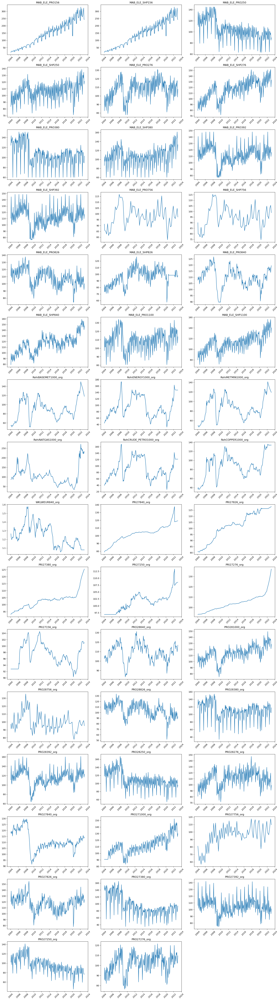

In [45]:
import pandas as pd
import matplotlib.pyplot as plt

# Load and prepare the data
total_market_data = pd.read_csv("total_market_data_with_forecasts.csv")
total_market_data['date'] = pd.to_datetime(total_market_data['date'])
total_market_data.set_index('date', inplace=True)

# Plotting
num_cols = total_market_data.shape[1]
ncols = 3
nrows = (num_cols // ncols) + int(num_cols % ncols != 0)

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(18, 4 * nrows))
axes = axes.flatten()

for i, col in enumerate(total_market_data.columns):
    axes[i].plot(total_market_data.index, total_market_data[col])
    axes[i].set_title(col)
    axes[i].tick_params(axis='x', rotation=45)

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

fig.tight_layout()
plt.show()


In [48]:
min_date = total_market_data.index.min()
max_date = total_market_data.index.max()

print("Min date:", min_date)
print("Max date:", max_date)


Min date: 2004-02-01 00:00:00
Max date: 2023-02-01 00:00:00


<a class="anchor" id="sub-section-1_3">

# 1.3. Sales Data
    
</a>

In [163]:
sales_data.head()

,DATE,Mapped_GCK,Sales_EUR
0,2018-10-01,#1,0
1,2018-10-02,#1,0
2,2018-10-03,#1,0
3,2018-10-04,#1,0
4,2018-10-05,#1,0


In [164]:
sales_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9802 entries, 0 to 9801
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   DATE        9802 non-null   datetime64[ns]
 1   Mapped_GCK  9802 non-null   object        
 2   Sales_EUR   9802 non-null   object        
dtypes: datetime64[ns](1), object(2)
memory usage: 229.9+ KB


In [58]:
sales_data.shape

(9802, 3)

In [59]:
sales_data['Mapped_GCK'].unique()

array(['#1', '#11', '#6', '#8', '#12', '#16', '#4', '#5', '#3', '#9',
       '#14', '#13', '#20', '#36'], dtype=object)

Understand what these product groups refer to?

<a class="anchor" id="sub-section-1_3_1">

### 1.3.1. Converting Data Types
    
</a>

Before using this dataset effectively, several preprocessing steps are necessary, including adjusting data types for consistency. Firstly, Sales_EUR should be converted to a float to enable numerical operations. Secondly, the DATE column must be formatted to match the date structure in the Market dataset.

**Sales_EUR**

In [165]:
# Turn into string, replace commas with periods, and remove leading/trailing whitespaces
sales_data['Sales_EUR'] = sales_data['Sales_EUR'].astype(str).str.replace(',', '.').str.strip()

# Convert to float
sales_data['Sales_EUR'] = pd.to_numeric(sales_data['Sales_EUR'])

# Check the data type
sales_data['Sales_EUR'].dtypes

dtype('float64')

In [61]:
sales_data['Sales_EUR'].describe()

count       9802.0000
mean      272785.6867
std      2230789.1619
min      -506381.1700
25%            0.0000
50%            0.0000
75%            0.0000
max     41127988.0200
Name: Sales_EUR, dtype: float64

In [62]:
#count 0 values
sales_data[sales_data['Sales_EUR'] == 0].shape

#calculate the percentage of 0 values
zero_sales = sales_data[sales_data['Sales_EUR'] == 0].shape[0]
total_sales = sales_data.shape[0]
zero_sales_percentage = zero_sales / total_sales * 100
zero_sales_percentage

72.7810650887574

We have 0 sales in 73% of the data

In [63]:
# print head of negative values
sales_data[sales_data['Sales_EUR'] < 0].head()

,DATE,Mapped_GCK,Sales_EUR
90,2022-02-02,#6,-54.0000
96,2022-04-04,#11,-587.5900
102,2021-12-02,#3,-183.5000
130,2022-03-02,#6,-93.8800
155,2021-05-03,#5,-166.2400


In [64]:
#calculate the percentage of negative values
negative_sales = sales_data[sales_data['Sales_EUR'] < 0].shape[0]
negative_sales_percentage = negative_sales / total_sales * 100
negative_sales_percentage

2.8157518873699243

**DATE**

In [166]:
# Convert to datetime with day first and change name to date
sales_data['date'] = sales_data['DATE'].apply(pd.to_datetime, dayfirst=True) 

# Check the data type
sales_data['date'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 9802 entries, 0 to 9801
Series name: date
Non-Null Count  Dtype         
--------------  -----         
9802 non-null   datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 76.7 KB


In [66]:
print('Oldest date in Sales Data:', sales_data['date'].min())
print('Newest date in Sales Data:', sales_data['date'].max())

Oldest date in Sales Data: 2018-10-01 00:00:00
Newest date in Sales Data: 2022-04-30 00:00:00


<a class="anchor" id="sub-section-1_3_2">

### 1.3.2. Initial Analysis
    
</a>

In [67]:
#drop DATE column
sales_data.drop('DATE', axis=1, inplace=True)

In [68]:
sales_data.describe(include='all')

,Mapped_GCK,Sales_EUR,date
count,9802,9802.0000,9802
unique,14,NaN,NaN
top,#1,NaN,NaN
freq,1179,NaN,NaN
mean,NaN,272785.6867,2020-07-19 17:55:48.785961984
min,NaN,-506381.1700,2018-10-01 00:00:00
25%,NaN,0.0000,2019-08-30 00:00:00
50%,NaN,0.0000,2020-07-26 12:00:00
75%,NaN,0.0000,2021-06-09 00:00:00
max,NaN,41127988.0200,2022-04-30 00:00:00


hola

In [69]:
# Check duplicate rows
sales_data[sales_data.duplicated() == True]

,Mapped_GCK,Sales_EUR,date


In [70]:
# Check for missing values
missing_values = sales_data.isnull().sum()
missing_values[missing_values > 0]

Series([], dtype: int64)

In [71]:
# Check negative values, errors?
len(sales_data[sales_data['Sales_EUR'] < 0])

276

In [72]:
# Display rows with negative sales
negative_sales = sales_data[sales_data['Sales_EUR'] < 0].head()
print(negative_sales)


    Mapped_GCK  Sales_EUR       date
90          #6   -54.0000 2022-02-02
96         #11  -587.5900 2022-04-04
102         #3  -183.5000 2021-12-02
130         #6   -93.8800 2022-03-02
155         #5  -166.2400 2021-05-03


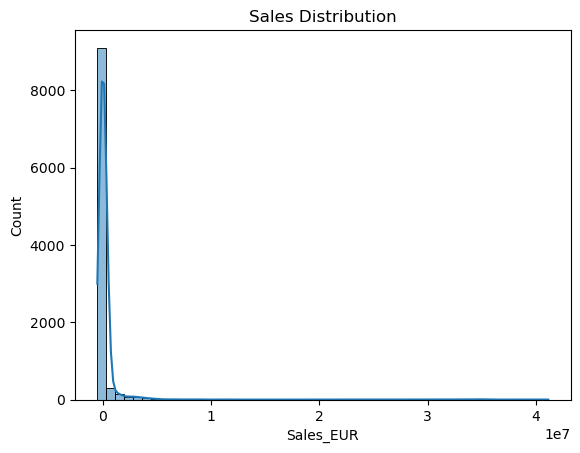

In [73]:
sns.histplot(sales_data['Sales_EUR'], bins=50, kde=True)
plt.title("Sales Distribution")
plt.show()

## Outliers

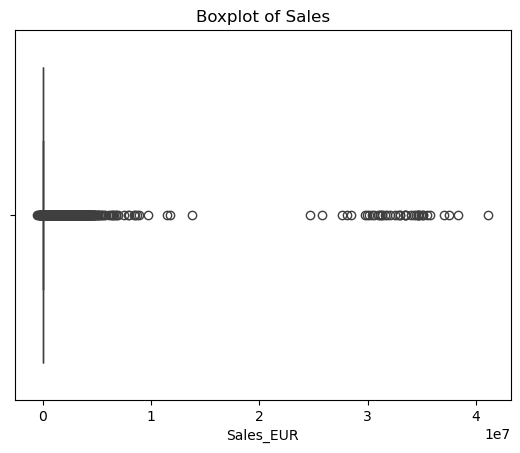

In [74]:
#check for outliers in sales data and extreme values
sns.boxplot(x=sales_data['Sales_EUR'])
plt.title("Boxplot of Sales")
plt.show()

### Total Sales per Month per Product

/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/1538478463.py:14: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_sales = product_sales.resample('M', on='date')['Sales_EUR'].sum()


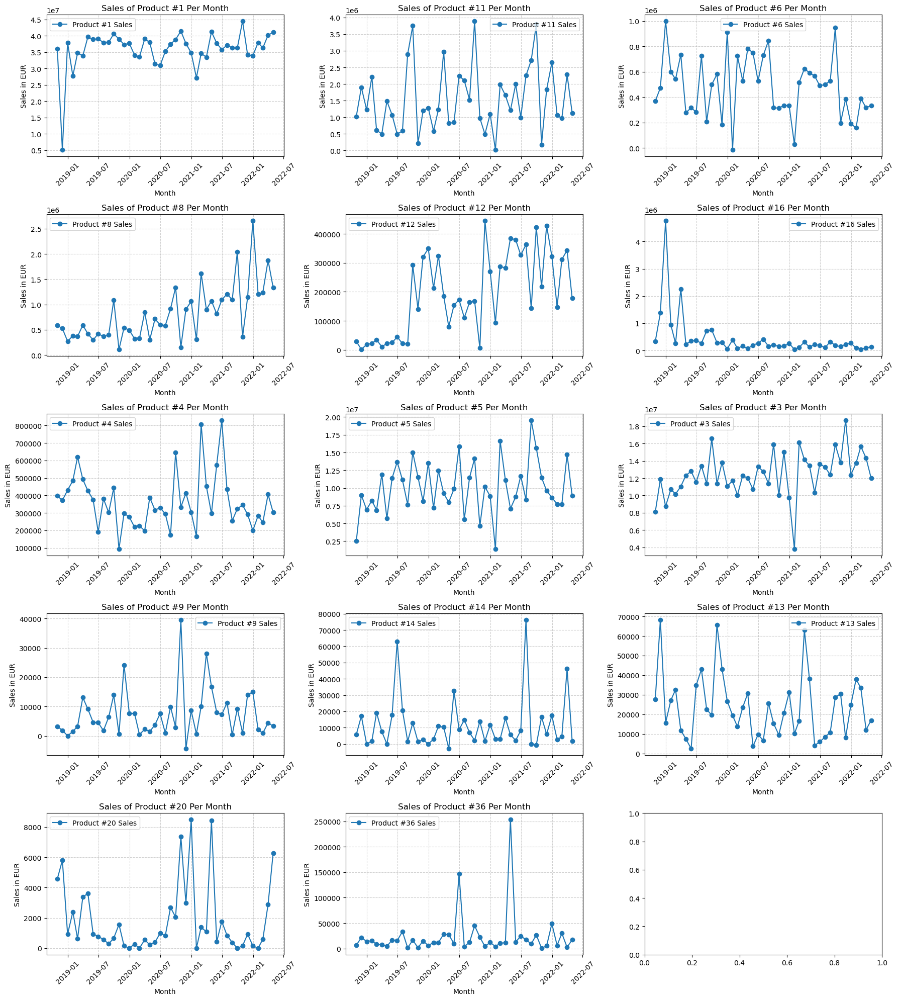

In [167]:
# List of selected products
selected_products = ['#1', '#11', '#6', '#8', '#12', '#16', '#4', '#5', '#3', '#9', '#14', '#13', '#20', '#36']

# Create subplots for each product
fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(18, 20))  # Adjust layout for clarity
axes = axes.flatten()

# Plot each product's time trend
for i, product in enumerate(selected_products):
    # Filter data for the current product
    product_sales = sales_data[sales_data['Mapped_GCK'] == product]

    # Aggregate monthly sales
    monthly_sales = product_sales.resample('M', on='date')['Sales_EUR'].sum()

    # Plot time trend
    axes[i].plot(monthly_sales, marker='o', linestyle='-', label=f"Product {product} Sales")
    axes[i].set_title(f"Sales of Product {product} Per Month", fontsize=12)
    axes[i].set_xlabel("Month")
    axes[i].set_ylabel("Sales in EUR")
    axes[i].tick_params(axis='x', rotation=45)
    axes[i].grid(True, linestyle='--', alpha=0.6)
    axes[i].legend()

# Adjust layout
plt.tight_layout()
plt.show()

In [168]:
#calculate the average, the maximum and the minimum sales per month for each product
product_sales = sales_data.groupby('Mapped_GCK').resample('M', on='date')['Sales_EUR'].agg(['mean', 'max', 'min'])
product_sales

/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/906146653.py:2: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  product_sales = sales_data.groupby('Mapped_GCK').resample('M', on='date')['Sales_EUR'].agg(['mean', 'max', 'min'])


mean           max          min
Mapped_GCK date                                              
#1         2018-10-31 1244790.3031 33421781.0300       0.0000
           2018-11-30  197721.5385  1293062.8900       0.0000
           2018-12-31 1403318.9674 35698229.7400 -226731.5000
           2019-01-31  990291.0125 24656215.4100  -79503.4300
           2019-02-28 1391726.5412 31348710.1800  -47249.0400
           2019-03-31 1302184.7323 29719518.2200  -35476.4600
           2019-04-30 1526472.7696 36991496.0900  -40297.5400
           2019-05-31 1389213.3675 34241222.3800  -65903.1400
           2019-06-30 1448398.1567 34709584.1300  -90035.3100
           2019-07-31 1404169.3444 34644127.5400  -99659.2600
           2019-08-31 1358667.0375 34031494.0700 -134244.7900
           2019-09-30 1450099.3086 35060087.6600 -156912.4000
           2019-10-31 1393296.3996 37519861.5100 -166179.7300
           2019-11-30 1382366.7804 32792206.9300  -41905.7100
           2019-12-31 1396352.1989 34681586.5200 -105537.3200
           2020-01-31 1218451.8382 31351729.0700 -107082.2800
           2020-02-29 1340235.1704 30568295.8000  -35159.4200
           2020-03-31 1347049.3407 34617370.3500 -153809.7800
           2020-04-30 1406723.3822 34904139.1600   -5967.4100
           2020-05-31 1162970.8348 28060622.4900      -0.0000
           2020-06-30 1144326.0767 27607753.2800  -35715.9100
           2020-07-31 1214232.0734 31552339.3500       0.0000
           2020-08-31 1338645.9136 32980853.6100       0.0000
           2020-09-30 1340667.5931 32991953.5500       0.0000
           2020-10-31 1480494.8036 38363810.5100  -14958.1000
           2020-11-30 1447831.2142 33390133.0800       0.0000
           2020-12-31 1160565.3060 31102512.8000  -21130.4700
           2021-01-31 1045401.2669 25754112.7600       0.0000
           2021-02-28 1385220.9124 31128894.4700    -516.6300
           2021-03-31 1239856.9867 28482197.5900       0.0000
           2021-04-30 1473478.4964 35132304.7900  -61569.0800
           2021-05-31 1452308.2800 34487389.4000  -28299.1800
           2021-06-30 1193379.9490 30394729.8600   -5686.3300
           2021-07-31 1280344.9728 32032343.7400  -21942.8400
           2021-08-31 1296814.9079 31789422.5900    -100.3100
           2021-09-30 1250996.0890 30932715.4800 -125560.0700
           2021-10-31 1588679.0664 41127988.0200  -68013.2300
           2021-11-30 1220978.4143 29912291.6800  -55771.5500
           2021-12-31 1305771.9165 30132311.1100  -67062.0400
           2022-01-31 1355105.0736 33522465.5900  -90102.6000
           2022-02-28 1451723.0532 32492828.2700  -61910.6400
           2022-03-31 1386910.5872 33406102.2100   -3677.2500
           2022-04-30 1520489.0044 35469756.2700  -82992.7900
#11        2018-10-31   53752.8158   681212.5000       0.0000
           2018-11-30  126589.6533   860175.0000       0.0000
           2018-12-31   87580.1429   554000.0000       0.0000
           2019-01-31  147759.4493  1101003.7200       0.0000
           2019-02-28   38153.5375   417601.1000       0.0000
           2019-03-31   32933.3207   929483.1100 -463023.3000
           2019-04-30   98952.1067   893416.6000       0.0000
           2019-05-31   56108.6263   639152.5000       0.0000
           2019-06-30   27340.7333   471049.2000       0.0000
           2019-07-31   32536.0078   267456.1400       0.0000
           2019-08-31  152567.3616  2429072.3700  -22775.0000
           2019-09-30  267855.7471  1329298.9500       0.0000
           2019-10-31   13686.0487   227910.0000   -9153.2200
           2019-11-30   79651.3833   647846.0000       0.0000
           2019-12-31  106545.4683   747063.0000       0.0000
           2020-01-31   36523.1250   450858.0000       0.0000
           2020-02-29   68533.8739  1223229.7300       0.0000
           2020-03-31  174702.8618  1495464.0000       0.0000
           2020-04-30   47841.3535   501808.0000       0.0000
           2020-05-31   44343.4789   688887.0000       0.0000


/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2621540739.py:2: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  product_sales = sales_data.groupby(['Mapped_GCK']).resample('M', on='date')['Sales_EUR'].agg(['mean', 'max', 'min']).reset_index()


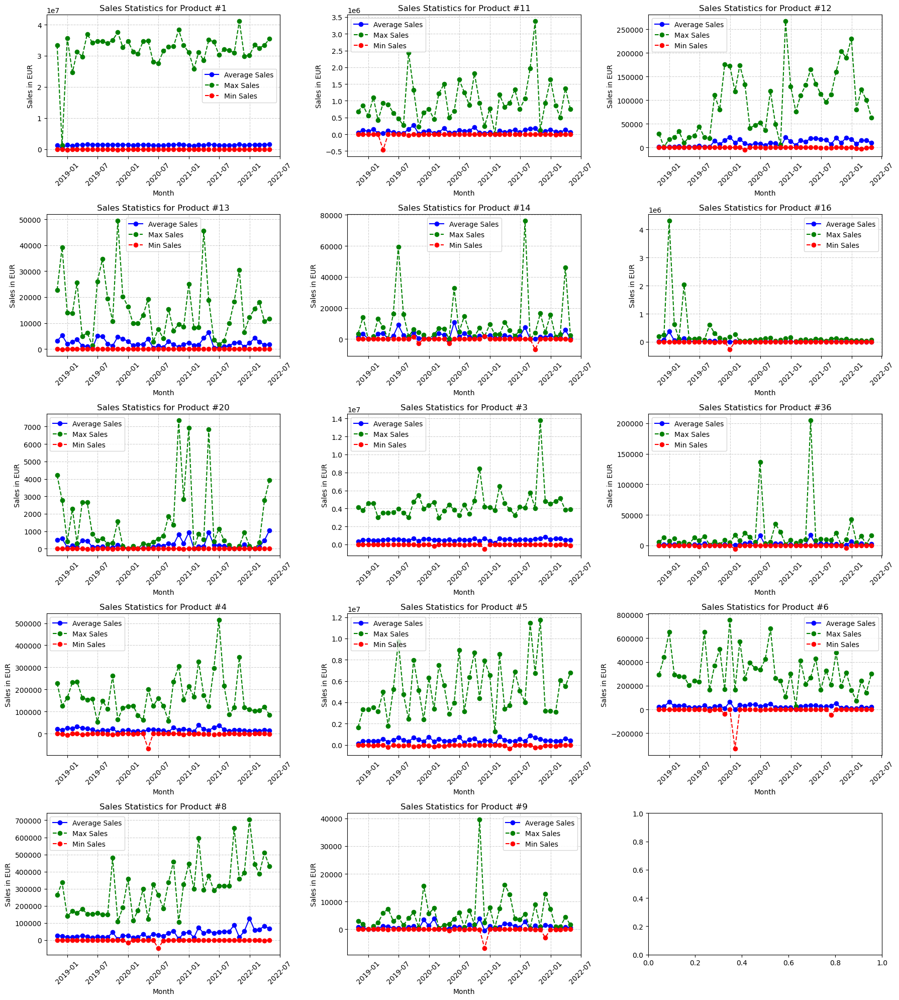

In [169]:
# Calculate average, max, and min sales per month for each product
product_sales = sales_data.groupby(['Mapped_GCK']).resample('M', on='date')['Sales_EUR'].agg(['mean', 'max', 'min']).reset_index()

# Get unique products
unique_products = product_sales['Mapped_GCK'].unique()

# Create subplots
fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(18, 20))  # Adjust layout for clarity
axes = axes.flatten()

# Plot each product's sales statistics
for i, product in enumerate(unique_products):
    # Filter data for the current product
    product_data = product_sales[product_sales['Mapped_GCK'] == product]

    # Plot mean, max, and min sales
    axes[i].plot(product_data['date'], product_data['mean'], marker='o', linestyle='-', label='Average Sales', color='blue')
    axes[i].plot(product_data['date'], product_data['max'], marker='o', linestyle='--', label='Max Sales', color='green')
    axes[i].plot(product_data['date'], product_data['min'], marker='o', linestyle='--', label='Min Sales', color='red')

    # Set titles and labels
    axes[i].set_title(f"Sales Statistics for Product {product}", fontsize=12)
    axes[i].set_xlabel("Month")
    axes[i].set_ylabel("Sales in EUR")
    axes[i].tick_params(axis='x', rotation=45)
    axes[i].grid(True, linestyle='--', alpha=0.6)
    axes[i].legend()

# Adjust layout
plt.tight_layout()
plt.show()


I am trying to find the hihghest peak sales pero product

/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/3545675417.py:4: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  product_sales = sales_data.groupby(['Mapped_GCK']).resample('M', on='date')['Sales_EUR'].agg(['mean', 'max', 'min']).reset_index()


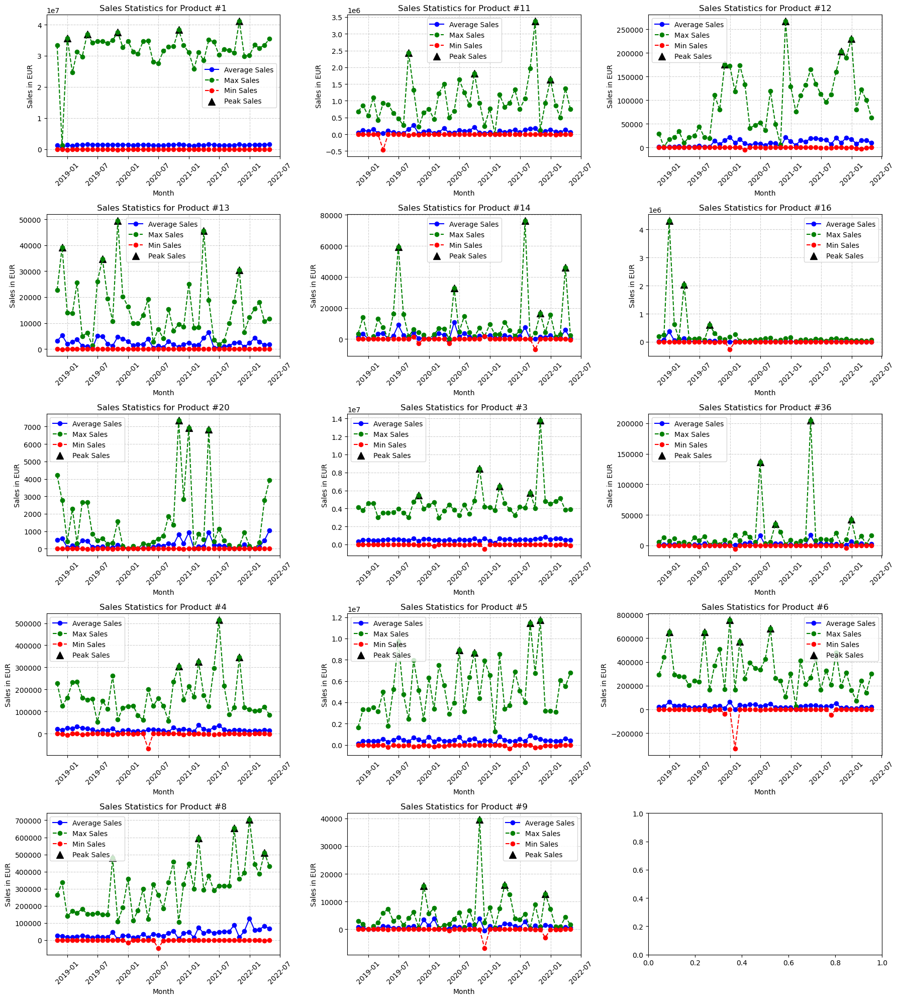

In [170]:
from scipy.signal import find_peaks

# Aggregate average, max, and min sales per month for each product
product_sales = sales_data.groupby(['Mapped_GCK']).resample('M', on='date')['Sales_EUR'].agg(['mean', 'max', 'min']).reset_index()

# Get unique products
unique_products = product_sales['Mapped_GCK'].unique()

# Create subplots
fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(18, 20))  # Adjust layout for clarity
axes = axes.flatten()

for i, product in enumerate(unique_products):
    product_data = product_sales[product_sales['Mapped_GCK'] == product]

    # Detect peaks in max sales using SciPy's find_peaks
    peaks, _ = find_peaks(product_data['max'], distance=2, height=np.percentile(product_data['max'], 90))  # Adjust percentile if needed

    # Plot mean, max, and min sales
    axes[i].plot(product_data['date'], product_data['mean'], marker='o', linestyle='-', label='Average Sales', color='blue')
    axes[i].plot(product_data['date'], product_data['max'], marker='o', linestyle='--', label='Max Sales', color='green')
    axes[i].plot(product_data['date'], product_data['min'], marker='o', linestyle='--', label='Min Sales', color='red')

    # Highlight peaks in max sales
    axes[i].scatter(product_data['date'].iloc[peaks], product_data['max'].iloc[peaks], color='black', marker='^', s=100, label="Peak Sales")

    # Add labels, grid, and title
    axes[i].set_title(f"Sales Statistics for Product {product}", fontsize=12)
    axes[i].set_xlabel("Month")
    axes[i].set_ylabel("Sales in EUR")
    axes[i].tick_params(axis='x', rotation=45)
    axes[i].grid(True, linestyle='--', alpha=0.6)
    axes[i].legend()

# Adjust layout
plt.tight_layout()
plt.show()


In [171]:
from collections import Counter

# Collect peak sales data across all products
all_peak_months = []

for product in unique_products:
    product_data = product_sales[product_sales['Mapped_GCK'] == product]

    # Detect peaks
    peaks, _ = find_peaks(product_data['max'], distance=2, height=np.percentile(product_data['max'], 90))

    # Extract peak months
    peak_months = product_data['date'].iloc[peaks].dt.month_name()
    
    # Store results
    all_peak_months.extend(peak_months)

# Count occurrences of peak months
common_months = Counter(all_peak_months)

# Convert to a sorted Pandas Series for better display
common_months = pd.Series(common_months).sort_values(ascending=False)
common_months


October      15
December      9
September     6
August        5
November      5
March         5
June          5
February      4
April         3
July          3
May           1
dtype: int64

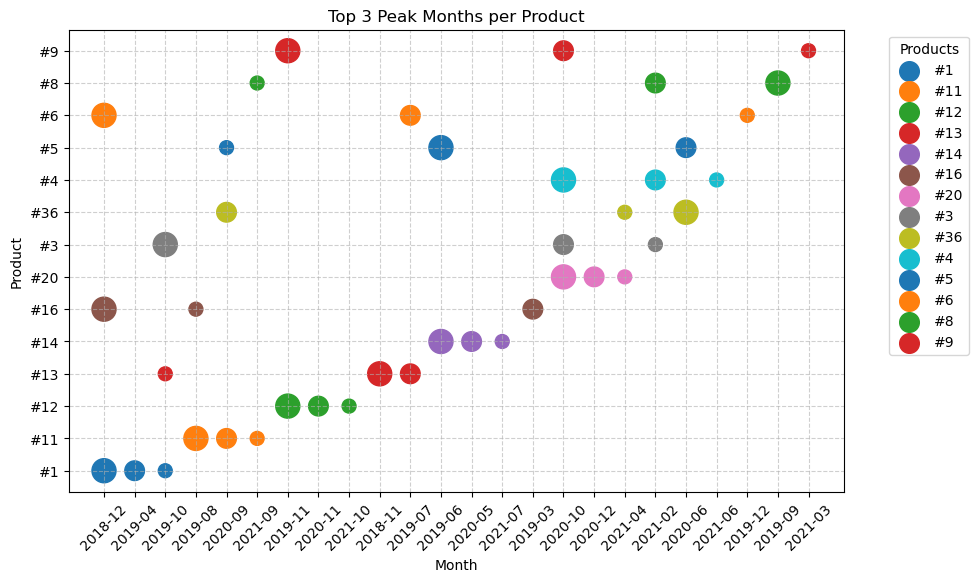

In [172]:
from collections import Counter

# Dictionary to store peak months per product
peak_months_dict = {}

# Get unique products
unique_products = product_sales['Mapped_GCK'].unique()

for product in unique_products:
    product_data = product_sales[product_sales['Mapped_GCK'] == product]

    # Detect peaks in max sales
    peaks, _ = find_peaks(product_data['max'], distance=2, height=np.percentile(product_data['max'], 90))  # Top 10% sales

    # Extract peak months
    peak_months = product_data.iloc[peaks]['date'].dt.strftime('%Y-%m').tolist()
    peak_months_dict[product] = peak_months

# Convert dictionary to DataFrame
peak_months_df = pd.DataFrame([(prod, month) for prod, months in peak_months_dict.items() for month in months], 
                               columns=['Product', 'Month'])

# Count occurrences of peak months per product and select the top 3
top_peak_months = peak_months_df.groupby('Product')['Month'].apply(lambda x: x.value_counts().nlargest(3).index.tolist()).reset_index()

# Convert data for visualization
data_for_plot = []
for _, row in top_peak_months.iterrows():
    product = row['Product']
    months = row['Month']
    for i, month in enumerate(months):
        data_for_plot.append((product, month, 3 - i))  # Assigning rank (higher rank = more common)

# Create DataFrame for plotting
plot_df = pd.DataFrame(data_for_plot, columns=['Product', 'Month', 'Rank'])

# Plot the top 3 peak months for each product
plt.figure(figsize=(10, 6))
for product in plot_df['Product'].unique():
    product_data = plot_df[plot_df['Product'] == product]
    plt.scatter(product_data['Month'], product_data['Product'], s=product_data['Rank'] * 100, label=product)

plt.xticks(rotation=45)
plt.xlabel("Month")
plt.ylabel("Product")
plt.title("Top 3 Peak Months per Product")
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(title="Products", bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the visualization
plt.show()


There is a higher number of peak sales during the month of October, December and September.

This just confirms that the months that get the highest peak sales are October, December and September.

In [173]:
#check top 5 products with the highest average sales
top_5_products = product_sales.groupby('Mapped_GCK')['mean'].mean().sort_values(ascending=False).head(5)
top_5_products

Mapped_GCK
#1    1309970.2554
#3     527434.1953
#5     451331.0129
#11     90207.8391
#8      36949.2958
Name: mean, dtype: float64

In [174]:
#check top 5 products with the highest maximum sales
top_5_products = product_sales.groupby('Mapped_GCK')['max'].mean().sort_values(ascending=False).head(5)
top_5_products

Mapped_GCK
#1    31965082.5856
#5     5249148.5258
#3     4484102.8414
#11     970173.4647
#6      315663.6274
Name: max, dtype: float64

In [83]:
#check top 5 products with the highest minimum sales
top_5_products = product_sales.groupby('Mapped_GCK')['min'].mean().sort_values(ascending=False).head(5)
top_5_products

Mapped_GCK
#20     -0.9216
#13     -4.4907
#14   -228.7360
#9    -241.2723
#36   -311.2970
Name: min, dtype: float64

/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/672910588.py:3: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Mapped_GCK', y='Sales_EUR', data=sales_data, estimator=sum, ci=None)


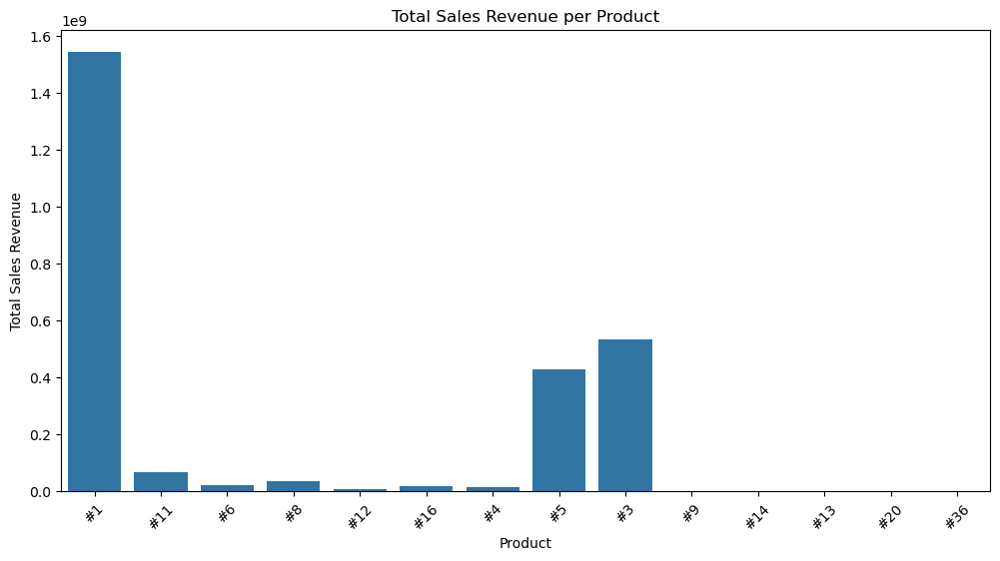

In [84]:
#plot an histogram of the total sales revenue per product
plt.figure(figsize=(12, 6))
sns.barplot(x='Mapped_GCK', y='Sales_EUR', data=sales_data, estimator=sum, ci=None)
plt.title("Total Sales Revenue per Product")
plt.xlabel("Product")
plt.ylabel("Total Sales Revenue")
plt.xticks(rotation=45)
plt.show()

In [85]:
# Calculate total sales for all products
total_sales = sales_data.groupby('Mapped_GCK')['Sales_EUR'].sum()

# Calculate percentage of sales for each product
product_sales_percentage = (total_sales / total_sales.sum()) * 100

# Total percentage of sales of products #1, #5, and #3
total_sales_percentage = product_sales_percentage[['#1', '#5', '#3']].sum()
total_sales_percentage

93.7692484244225

Product 1, 5 and 3 are the biggest contributors in Sales revenue, accounring for 93.80% sales

#### Outlier Detection Using Time Series Decomposition (STL)

In [175]:
from statsmodels.tsa.seasonal import STL
import numpy as np
import pandas as pd

def treat_outliers(product_df, product_name):
    """
    Detects and treats outliers using STL + median smoothing.
    Returns treated time series and an outlier flag series.
    """
    # Step 1: Aggregate monthly sales
    monthly_sales = product_df.resample('M', on='date')['Sales_EUR'].sum().copy()
    
    # Step 2: STL decomposition
    stl = STL(monthly_sales, period=12, robust=True)
    result = stl.fit()
    residual = result.resid
    
    # Step 3: Z-score based outlier detection
    z_score = (residual - residual.mean()) / residual.std()
    outliers = np.abs(z_score) > 3
    outlier_flag = pd.Series(0, index=monthly_sales.index)
    outlier_flag[outliers] = 1
    
    # Step 4: Replace outliers with local median (±2 months)
    ts_treated = monthly_sales.copy()
    for idx in monthly_sales[outliers].index:
        window = ts_treated.loc[idx - pd.DateOffset(months=2): idx + pd.DateOffset(months=2)]
        if not window.drop(index=idx).empty:
            ts_treated.loc[idx] = window.drop(index=idx).median()
    
    # Step 5: Winsorization (optional, clip extremes)
    upper = ts_treated.quantile(0.95)
    lower = ts_treated.quantile(0.05)
    ts_treated = ts_treated.clip(lower=lower, upper=upper)
    
    return ts_treated, outlier_flag


In [176]:
treated_data = {}

for product in selected_products:
    product_df = sales_data[sales_data['Mapped_GCK'] == product]
    ts_clean, flag = treat_outliers(product_df, product)
    
    treated_data[product] = {
        'sales': ts_clean,
        'flag': flag
    }


/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2299050893.py:11: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_sales = product_df.resample('M', on='date')['Sales_EUR'].sum().copy()
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2299050893.py:11: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_sales = product_df.resample('M', on='date')['Sales_EUR'].sum().copy()
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2299050893.py:11: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_sales = product_df.resample('M', on='date')['Sales_EUR'].sum().copy()
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2299050893.py:11: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_sales = product_df.res

/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2299050893.py:11: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_sales = product_df.resample('M', on='date')['Sales_EUR'].sum().copy()
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2299050893.py:11: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_sales = product_df.resample('M', on='date')['Sales_EUR'].sum().copy()
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2299050893.py:11: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_sales = product_df.resample('M', on='date')['Sales_EUR'].sum().copy()
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/2299050893.py:11: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_sales = product_df.res

/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/3583436248.py:5: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  original = sales_data[sales_data['Mapped_GCK'] == prod].resample('M', on='date')['Sales_EUR'].sum()


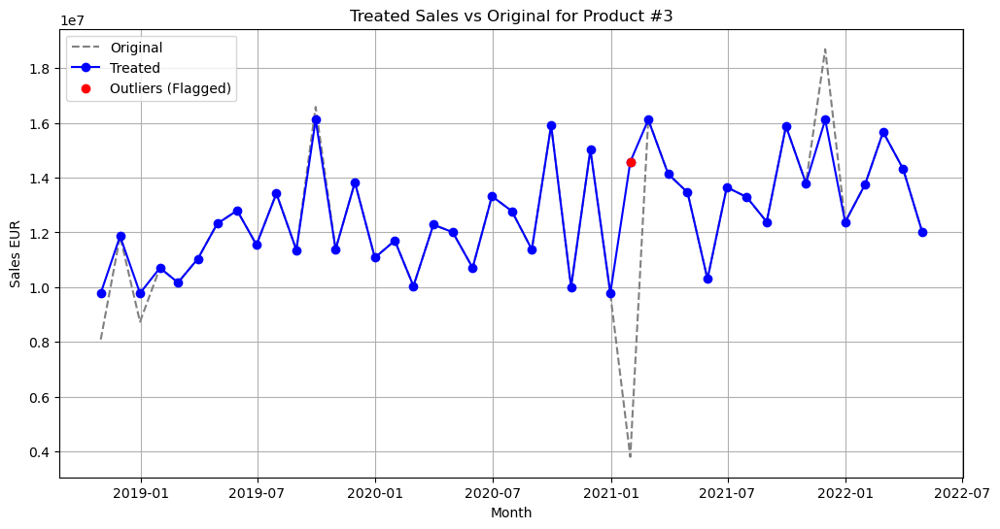

In [177]:
import matplotlib.pyplot as plt

# Visualize one product for sanity check
prod = '#3'
original = sales_data[sales_data['Mapped_GCK'] == prod].resample('M', on='date')['Sales_EUR'].sum()
treated = treated_data[prod]['sales']
flagged = treated_data[prod]['flag']

plt.figure(figsize=(12,6))
plt.plot(original, label='Original', linestyle='--', color='grey')
plt.plot(treated, label='Treated', color='blue', marker='o')
plt.scatter(flagged[flagged==1].index, treated[flagged==1], color='red', label='Outliers (Flagged)', zorder=5)
plt.title(f"Treated Sales vs Original for Product {prod}")
plt.xlabel("Month")
plt.ylabel("Sales EUR")
plt.legend()
plt.grid(True)
plt.show()


/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_44636/1384657330.py:5: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  original = sales_data[sales_data['Mapped_GCK'] == product].resample('M', on='date')['Sales_EUR'].sum()


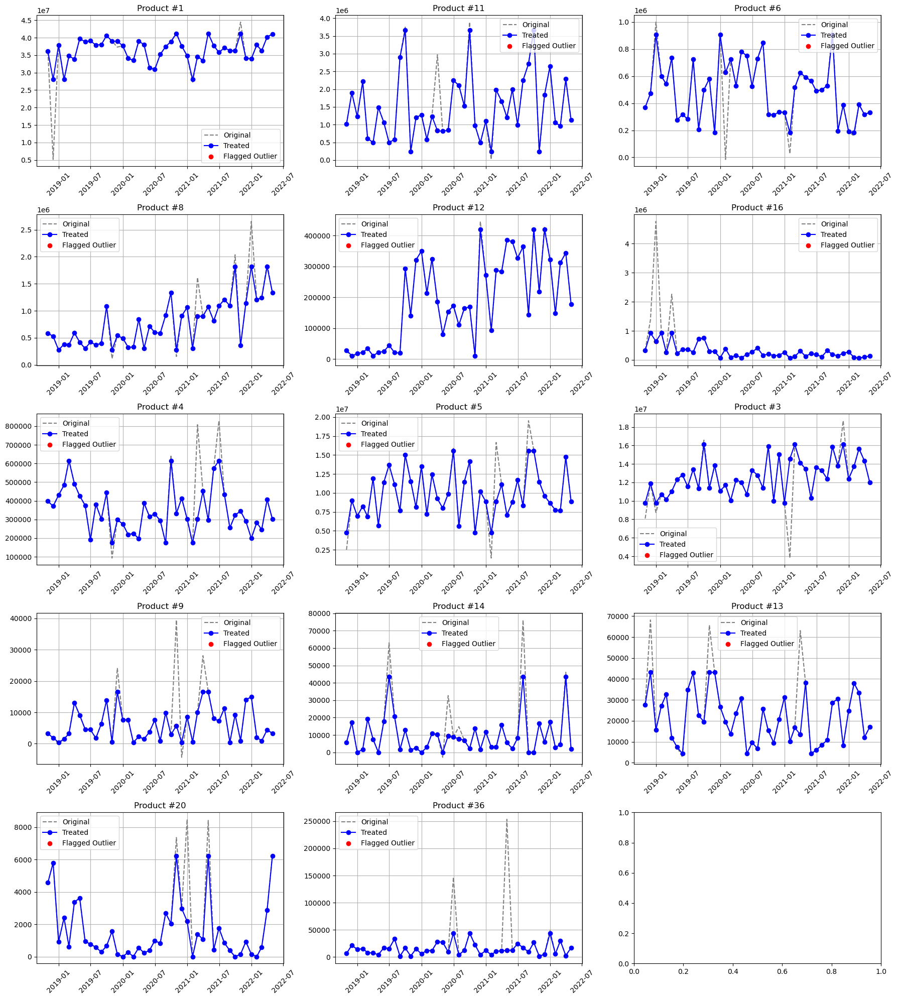

In [178]:
fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(18, 20))
axes = axes.flatten()

for i, product in enumerate(selected_products):
    original = sales_data[sales_data['Mapped_GCK'] == product].resample('M', on='date')['Sales_EUR'].sum()
    treated = treated_data[product]['sales']
    flagged = treated_data[product]['flag']
    
    axes[i].plot(original, label='Original', linestyle='--', color='grey')
    axes[i].plot(treated, label='Treated', color='blue', marker='o')
    axes[i].scatter(flagged[flagged == 1].index, treated[flagged == 1], color='red', label='Flagged Outlier')
    
    axes[i].set_title(f"Product {product}")
    axes[i].tick_params(axis='x', rotation=45)
    axes[i].grid(True)
    axes[i].legend()

plt.tight_layout()
plt.show()


In [179]:
all_treated_sales = pd.DataFrame()

for product, data in treated_data.items():
    df = pd.DataFrame({
        'date': data['sales'].index,
        'Mapped_GCK': product,
        'Sales_EUR': data['sales'].round(2).values  # Round to 2 decimals
    })
    all_treated_sales = pd.concat([all_treated_sales, df])

all_treated_sales.reset_index(drop=True, inplace=True)


<a class="anchor" id="sub-section-1_4">

## 1.4. Merging Sales and Market Data
    
</a>

In [97]:
#show sales data head  to confirm
all_treated_sales.head()

,date,Mapped_GCK,Sales_EUR
0,2018-10-31,#1,36098918.7900
1,2018-11-30,#1,28045013.9200
2,2018-12-31,#1,37889612.1200
3,2019-01-31,#1,28045013.9200
4,2019-02-28,#1,34793163.5300


In [180]:
#check missing values
missing_values = all_treated_sales.isnull().sum()
missing_values[missing_values > 0]

Series([], dtype: int64)

In [182]:
# Step 1: Ensure all 'date' columns are datetime
for df in [df_prod_ship, df_prices, df_producer_prices, df_production_index]:
    df['date'] = pd.to_datetime(df['date'])

# Step 2: Merge market data on start-of-month 'date'
market_data = (
    df_prod_ship
    .merge(df_prices, on='date', how='inner')
    .merge(df_producer_prices, on='date', how='inner')
    .merge(df_production_index, on='date', how='inner')
)

# Step 3: Sort and reset index
market_data = market_data.sort_values('date').reset_index(drop=True)

# Step 4: Prepare 'month' column for alignment
all_treated_sales['date'] = pd.to_datetime(all_treated_sales['date'])
all_treated_sales['month'] = all_treated_sales['date'].dt.to_period('M').dt.to_timestamp()
market_data['month'] = market_data['date']  # Already first-of-month format

# Step 5: Merge on 'month' and remove duplicated 'date'
final_model_data = pd.merge(
    all_treated_sales.drop(columns=['date']),
    market_data.drop(columns=['date']),  # Drop original to avoid duplicate
    on='month',
    how='inner'
)

# Step 6: Rename and sort final DataFrame
final_model_data = final_model_data.rename(columns={'month': 'date'})
final_model_data = final_model_data.sort_values(['Mapped_GCK', 'date']).reset_index(drop=True)


Those are the months we have no sales records

In [184]:
# Check for missing values
missing_values = final_model_data.isnull().sum()
missing_values[missing_values > 0]

Series([], dtype: int64)

The missing values in Sales_EUR correspond to periods not covered in the sales dataset, as it only includes transactions from October 2018 to April 2022.

In [185]:
print('Oldest date in Market Data:', final_model_data['date'].min())
print('Newest date in Market Data:', final_model_data['date'].max())

Oldest date in Market Data: 2018-10-01 00:00:00
Newest date in Market Data: 2022-04-01 00:00:00


In [ ]:
final_model_data.isna().sum 

<bound method DataFrame.sum of      Mapped_GCK  Sales_EUR   date  MAB_ELE_PRO156  MAB_ELE_SHP156  \
0         False      False  False           False           False   
1         False      False  False           False           False   
2         False      False  False           False           False   
3         False      False  False           False           False   
4         False      False  False           False           False   
5         False      False  False           False           False   
6         False      False  False           False           False   
7         False      False  False           False           False   
8         False      False  False           False           False   
9         False      False  False           False           False   
10        False      False  False           False           False   
11        False      False  False           False           False   
12        False      False  False           False           False   
13 

## Missing Values

In [ ]:
missing_rows = merged_data[merged_data.drop(columns=['Sales_EUR'], errors='ignore').isna().any(axis=1)]
# Show missing rows
missing_rows

,date,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org,Mapped_GCK,Sales_EUR
350,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#1,36555844.4200
351,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#11,735371.9600
352,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#12,710223.4600
353,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#13,25182.7600
354,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#14,1750.0000
355,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#16,279421.7800
356,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#20,5824.2400
357,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.49

Since our sales data only goes from 2018-10-01 00:00:00, I will drop all the rows that do not have sales data for the predictive model.

In [96]:
# Drop rows with date before 2018-10-01 00:00:00
merged_data = merged_data[merged_data['date'] >= '2018-10-01']

In [97]:
#check missing values
missing_values = merged_data.isnull().sum()
missing_values[missing_values > 0]

MAB_ELE_PRO756     14
MAB_ELE_SHP756     14
MAB_ELE_SHP826    252
MAB_ELE_SHP840     14
PRI27826_org      252
PRO28756_org       14
PRO27756_org       14
dtype: int64

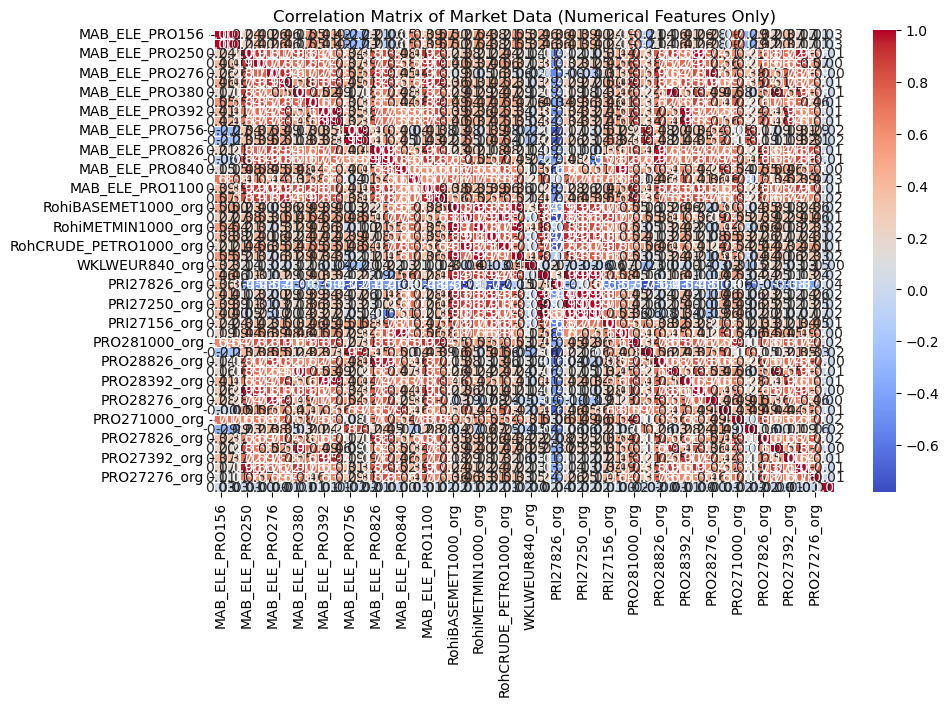

In [98]:
# Select only numerical features
numeric_market_data = merged_data.select_dtypes(include=['number'])

# Compute the correlation matrix
correlation_matrix = numeric_market_data.corr()

# Plot heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix of Market Data (Numerical Features Only)")
plt.show()

In [99]:
#display rows with missing values
missing_rows = merged_data[merged_data.drop(columns=['Sales_EUR'], errors='ignore').isna().any(axis=1)]
missing_rows

,date,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org,Mapped_GCK,Sales_EUR
350,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#1,36555844.4200
351,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#11,735371.9600
352,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#12,710223.4600
353,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#13,25182.7600
354,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#14,1750.0000
355,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#16,279421.7800
356,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.4909,111.2999,100.3046,114.5653,107.6027,135.3643,107.1710,129.6877,89.5907,100.8971,83.8459,108.0877,#20,5824.2400
357,2020-11,274.4020,274.4020,94.0219,116.6192,112.2796,129.3257,103.4539,120.1108,107.8768,108.8311,94.4502,90.7687,106.1838,NaN,102.8429,115.0238,115.6239,129.5316,91.4469,55.3018,90.2796,59.0623,53.5209,93.8171,1.1838,113.1588,NaN,105.1938,103.0844,110.9085,91.1261,100.4402,123.7804,87.0627,93.2118,109.49

## Using KNN for missing values

In [100]:
#Impute missing values with KNN

from sklearn.impute import KNNImputer

In [101]:
import pandas as pd
from sklearn.impute import KNNImputer
from sklearn.preprocessing import MinMaxScaler

# Define numerical features to impute
numerical_features = ['MAB_ELE_SHP826', 'PRI27826_org']

# Make a copy of the dataset to avoid modifying the original
merge_data_imputed = merged_data.copy()

# Initialize MinMaxScaler
scaler = MinMaxScaler()

# Normalize numerical features
merge_data_imputed[numerical_features] = scaler.fit_transform(merge_data_imputed[numerical_features])

In [102]:
# Apply KNN imputer
knn_imputer = KNNImputer(n_neighbors=3)
merge_data_imputed[numerical_features] = knn_imputer.fit_transform(merge_data_imputed[numerical_features])

In [103]:
# Reverse MinMax scaling for imputed values
merge_data_imputed[numerical_features] = scaler.inverse_transform(merge_data_imputed[numerical_features])

# Check for missing values
missing_values = merge_data_imputed.isnull().sum()
missing_values[missing_values > 0]


MAB_ELE_PRO756    14
MAB_ELE_SHP756    14
MAB_ELE_SHP840    14
PRO28756_org      14
PRO27756_org      14
dtype: int64

In [104]:
# Display rows with missing values
missing_rows = merge_data_imputed[merge_data_imputed.drop(columns=['Sales_EUR'], errors='ignore').isna().any(axis=1)]

In [105]:
# Rename the imputed dataset to the original variable name
merged_data= merge_data_imputed.copy()

In [106]:
# Show dataset shape
merged_data.shape

(602, 50)

In [107]:
#show missing values
missing_values = merged_data.isnull().sum()
missing_values[missing_values > 0]  

MAB_ELE_PRO756    14
MAB_ELE_SHP756    14
MAB_ELE_SHP840    14
PRO28756_org      14
PRO27756_org      14
dtype: int64

In [108]:
# deal with missing values in the dataset by using a machine learning model to predict the missing values
# Import IterativeImputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

# Define numerical features to impute
numerical_features = ['MAB_ELE_PRO756', 'MAB_ELE_SHP756','MAB_ELE_SHP840','PRO28756_org', 'PRO27756_org'] 
# Initialize MinMaxScaler
scaler = MinMaxScaler()

# Normalize numerical features
merged_data[numerical_features] = scaler.fit_transform(merged_data[numerical_features])

# Apply Iterative imputer
iterative_imputer = IterativeImputer()
merged_data[numerical_features] = iterative_imputer.fit_transform(merged_data[numerical_features])
# Reverse MinMax scaling for imputed values
merged_data[numerical_features] = scaler.inverse_transform(merged_data[numerical_features])
# Check for missing values
missing_values = merged_data.isnull().sum()
missing_values[missing_values > 0]

Series([], dtype: int64)

In [109]:
# Show dataset head
merged_data.head()

,date,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org,Mapped_GCK,Sales_EUR
0,2018-10,211.9558,211.9558,108.2806,122.4517,124.2279,137.7420,118.3505,122.4569,125.2100,124.7933,109.0778,104.5948,113.6593,112.3180,111.9025,127.8088,124.3920,130.9893,86.1026,100.2222,79.3550,89.5708,97.0723,82.5451,1.1484,110.7004,111.4637,105.2978,102.0647,109.1196,96.3183,111.4226,131.3401,106.8169,110.8935,129.3892,131.5038,114.7208,127.4611,112.8533,129.3258,112.9708,118.6708,93.0015,112.3768,97.8495,118.2982,#1,2793607.0300
1,2018-10,211.9558,211.9558,108.2806,122.4517,124.2279,137.7420,118.3505,122.4569,125.2100,124.7933,109.0778,104.5948,113.6593,112.3180,111.9025,127.8088,124.3920,130.9893,86.1026,100.2222,79.3550,89.5708,97.0723,82.5451,1.1484,110.7004,111.4637,105.2978,102.0647,109.1196,96.3183,111.4226,131.3401,106.8169,110.8935,129.3892,131.5038,114.7208,127.4611,112.8533,129.3258,112.9708,118.6708,93.0015,112.3768,97.8495,118.2982,#11,1702516.0000
2,2018-10,211.9558,211.9558,108.2806,122.4517,124.2279,137.7420,118.3505,122.4569,125.2100,124.7933,109.0778,104.5948,113.6593,112.3180,111.9025,127.8088,124.3920,130.9893,86.1026,100.2222,79.3550,89.5708,97.0723,82.5451,1.1484,110.7004,111.4637,105.2978,102.0647,109.1196,96.3183,111.4226,131.3401,106.8169,110.8935,129.3892,131.5038,114.7208,127.4611,112.8533,129.3258,112.9708,118.6708,93.0015,112.3768,97.8495,118.2982,#12,28686.3300
3,2018-10,211.9558,211.9558,108.2806,122.4517,124.2279,137.7420,118.3505,122.4569,125.2100,124.7933,109.0778,104.5948,113.6593,112.3180,111.9025,127.8088,124.3920,130.9893,86.1026,100.2222,79.3550,89.5708,97.0723,82.5451,1.1484,110.7004,111.4637,105.2978,102.0647,109.1196,96.3183,111.4226,131.3401,106.8169,110.8935,129.3892,131.5038,114.7208,127.4611,112.8533,129.3258,112.9708,118.6708,93.0015,112.3768,97.8495,118.2982,#13,27666.1000
4,2018-10,211.9558,211.9558,108.2806,122.4517,124.2279,137.7420,118.3505,122.4569,125.2100,124.7933,109.0778,104.5948,113.6593,112.3180,111.9025,127.8088,124.3920,130.9893,86.1026,100.2222,79.3550,89.5708,97.0723,82.5451,1.1484,110.7004,111.4637,105.2978,102.0647,109.1196,96.3183,111.4226,131.3401,106.8169,110.8935,129.3892,131.5038,114.7208,127.4611,112.8533,129.3258,112.9708,118.6708,93.0015,112.3768,97.8495,118.2982,#14,5770.0000


In [110]:
#show unique mapped_gck
merged_data['Mapped_GCK'].unique()

array(['#1', '#11', '#12', '#13', '#14', '#16', '#20', '#3', '#36', '#4',
       '#5', '#6', '#8', '#9'], dtype=object)

In [111]:
#display merged data missing values
missing_values = merged_data.isnull().sum()
missing_values[missing_values > 0]

Series([], dtype: int64)

## Split into Train and Val data

In [112]:
import os
import pandas as pd
from sklearn.model_selection import train_test_split

# Create a directory to save the datasets if it doesn't exist
output_dir = "Mapped_GCK_Datasets"
os.makedirs(output_dir, exist_ok=True)

# Define train-validation split ratio
train_ratio = 0.8  # 80% train, 20% validation

# Define the specific products to be processed
selected_products = {'#1', '#11', '#12', '#13', '#14', '#16', '#20', '#3', '#36', '#4', '#5', '#6', '#8', '#9'}

# Filter only selected products
filtered_data = merged_data[merged_data['Mapped_GCK'].isin(selected_products)]

# Loop through each selected Mapped_GCK dataset
for name, group in filtered_data.groupby('Mapped_GCK'):
    # Split data into train and validation sets
    train_set, val_set = train_test_split(group, test_size=1 - train_ratio, random_state=42)

    # Remove '#' from filenames for validity
    clean_name = name.replace("#", "")

    # Save train dataset
    train_file = os.path.join(output_dir, f"Mapped_GCK_{clean_name}_train.csv")
    train_set.to_csv(train_file, index=False)

    # Save validation dataset
    val_file = os.path.join(output_dir, f"Mapped_GCK_{clean_name}_val.csv")
    val_set.to_csv(val_file, index=False)

print(f"Train and validation datasets saved in '{output_dir}' directory.")


Train and validation datasets saved in 'Mapped_GCK_Datasets' directory.


In [113]:
# Directory where datasets are saved
output_dir = "Mapped_GCK_Datasets"

# List of selected product IDs (without '#')
product_ids = ['1', '11', '12', '13', '14', '16', '20', '3', '36', '4', '5', '6', '8', '9']

# Dictionary to store datasets
datasets = {}

for pid in product_ids:
    train_file = os.path.join(output_dir, f"Mapped_GCK_{pid}_train.csv")
    val_file = os.path.join(output_dir, f"Mapped_GCK_{pid}_val.csv")

    if os.path.exists(train_file) and os.path.exists(val_file):
        datasets[f"Mapped_GCK_{pid}_train"] = pd.read_csv(train_file)
        datasets[f"Mapped_GCK_{pid}_val"] = pd.read_csv(val_file)

print("Datasets loaded successfully!")

Datasets loaded successfully!


## Dataset Product #1

### Data Scaling

In [114]:
#load Mapped_GCK_1_train dataset
mapped_gck_1_train = datasets['Mapped_GCK_1_train']
# display types of data in the dataset
mapped_gck_1_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34 entries, 0 to 33
Data columns (total 50 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   date                    34 non-null     object 
 1   MAB_ELE_PRO156          34 non-null     float64
 2   MAB_ELE_SHP156          34 non-null     float64
 3   MAB_ELE_PRO250          34 non-null     float64
 4   MAB_ELE_SHP250          34 non-null     float64
 5   MAB_ELE_PRO276          34 non-null     float64
 6   MAB_ELE_SHP276          34 non-null     float64
 7   MAB_ELE_PRO380          34 non-null     float64
 8   MAB_ELE_SHP380          34 non-null     float64
 9   MAB_ELE_PRO392          34 non-null     float64
 10  MAB_ELE_SHP392          34 non-null     float64
 11  MAB_ELE_PRO756          34 non-null     float64
 12  MAB_ELE_SHP756          34 non-null     float64
 13  MAB_ELE_PRO826          34 non-null     float64
 14  MAB_ELE_SHP826          34 non-null     floa

In [115]:
#load Mapped_GCK_1_val dataset
mapped_gck_1_val = datasets['Mapped_GCK_1_val']
# display types of data in the dataset
mapped_gck_1_val.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9 entries, 0 to 8
Data columns (total 50 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   date                    9 non-null      object 
 1   MAB_ELE_PRO156          9 non-null      float64
 2   MAB_ELE_SHP156          9 non-null      float64
 3   MAB_ELE_PRO250          9 non-null      float64
 4   MAB_ELE_SHP250          9 non-null      float64
 5   MAB_ELE_PRO276          9 non-null      float64
 6   MAB_ELE_SHP276          9 non-null      float64
 7   MAB_ELE_PRO380          9 non-null      float64
 8   MAB_ELE_SHP380          9 non-null      float64
 9   MAB_ELE_PRO392          9 non-null      float64
 10  MAB_ELE_SHP392          9 non-null      float64
 11  MAB_ELE_PRO756          9 non-null      float64
 12  MAB_ELE_SHP756          9 non-null      float64
 13  MAB_ELE_PRO826          9 non-null      float64
 14  MAB_ELE_SHP826          9 non-null      float6

In [116]:
# save the numerical features in the dataset excluding sales_EUR
numerical_features_1 = mapped_gck_1_train.select_dtypes(include=['float64', 'int64']).columns.drop('Sales_EUR')
numerical_features_1


Index(['MAB_ELE_PRO156', 'MAB_ELE_SHP156', 'MAB_ELE_PRO250', 'MAB_ELE_SHP250',
       'MAB_ELE_PRO276', 'MAB_ELE_SHP276', 'MAB_ELE_PRO380', 'MAB_ELE_SHP380',
       'MAB_ELE_PRO392', 'MAB_ELE_SHP392', 'MAB_ELE_PRO756', 'MAB_ELE_SHP756',
       'MAB_ELE_PRO826', 'MAB_ELE_SHP826', 'MAB_ELE_PRO840', 'MAB_ELE_SHP840',
       'MAB_ELE_PRO1100', 'MAB_ELE_SHP1100', 'RohiBASEMET1000_org',
       'RohiENERGY1000_org', 'RohiMETMIN1000_org', 'RohiNATGAS1000_org',
       'RohCRUDE_PETRO1000_org', 'RohCOPPER1000_org', 'WKLWEUR840_org',
       'PRI27840_org', 'PRI27826_org', 'PRI27380_org', 'PRI27250_org',
       'PRI27276_org', 'PRI27156_org', 'PRO28840_org', 'PRO281000_org',
       'PRO28756_org', 'PRO28826_org', 'PRO28380_org', 'PRO28392_org',
       'PRO28250_org', 'PRO28276_org', 'PRO27840_org', 'PRO271000_org',
       'PRO27756_org', 'PRO27826_org', 'PRO27380_org', 'PRO27392_org',
       'PRO27250_org', 'PRO27276_org'],
      dtype='object')

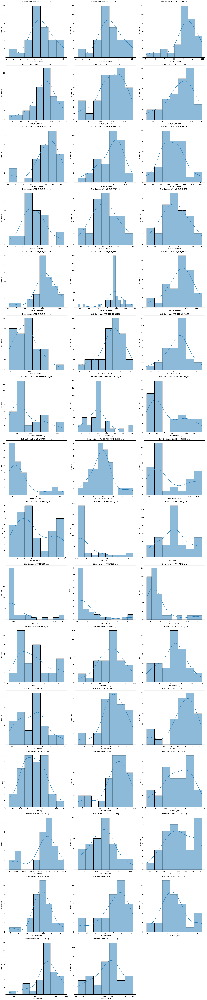

In [117]:

import math

# Calculate the number of rows and columns for subplots
num_features = len(numerical_features_1)
num_cols = 3  # Fixed number of columns
num_rows = math.ceil(num_features / num_cols)  # Dynamically calculate rows

# Increase figure size for bigger individual plots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 6))  # Adjust height dynamically
axes = axes.flatten()  # Flatten to easily iterate

# Loop through features and plot on respective subplot
for i, feature in enumerate(numerical_features_1):
    sns.histplot(mapped_gck_1_train[feature], kde=True, ax=axes[i])
    axes[i].set_title(f"Distribution of {feature}")
    axes[i].set_xlabel(feature)
    axes[i].set_ylabel("Frequency")

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


Since many features are skewed and contain outliers, the RobustScaler is the best option. It normalizes data based on the median and interquartile range (IQR), making it resistant to extreme values.

### Robust Scaler

In [118]:
# Fit and transform the train set
mapped_gck_1_train[numerical_features_1] = scaler.fit_transform(mapped_gck_1_train[numerical_features_1])
# Transform the validation set
mapped_gck_1_val[numerical_features_1] = scaler.transform(mapped_gck_1_val[numerical_features_1])

# Display the first 5 rows of the dataset
mapped_gck_1_train.head()

,date,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org,Mapped_GCK,Sales_EUR
0,2019-01,0.2273,0.2273,0.6711,0.6061,0.5117,0.4388,0.6574,0.3785,0.3357,0.3369,0.8462,0.8461,0.6354,0.6949,0.6256,0.0406,0.5195,0.3943,0.1691,0.3388,0.1350,0.1943,0.3890,0.1703,0.4416,0.0272,0.1852,0.0462,0.0636,0.0522,0.5336,0.6025,0.2660,0.8486,0.7136,0.6527,0.3429,0.6351,0.4151,0.6766,0.1642,0.8422,0.4342,0.6706,0.3103,0.6993,0.6260,#1,27456087.0500
1,2019-04,0.4481,0.4481,0.8165,0.6971,0.6377,0.5909,0.6635,0.5192,0.3591,0.3159,0.5129,0.5177,0.7117,0.7653,0.6907,0.2883,0.6185,0.5142,0.2221,0.4165,0.2119,0.1202,0.5203,0.2668,0.3099,0.0271,0.1852,0.0615,0.1000,0.0870,0.4086,0.6846,0.4498,0.5442,0.7755,0.6921,0.3405,0.8152,0.6033,0.6760,0.3254,0.4620,0.5285,0.5823,0.4058,0.7674,0.5517,#1,39257845.5400
2,2021-01,0.4242,0.4242,0.5686,0.4612,0.2060,0.1712,0.5269,0.3832,0.2924,0.2985,0.4298,0.4383,0.4239,0.6655,0.6088,0.0959,0.3437,0.2963,0.3925,0.2908,0.4924,0.1646,0.3564,0.5634,1.0000,0.1001,0.5037,0.0769,0.1364,0.1913,0.1982,0.5889,0.2117,0.2389,0.3978,0.4796,0.2816,0.5387,0.1431,0.6491,0.2619,0.7403,0.4288,0.6611,0.3184,0.5914,0.3156,#1,27180432.9400
3,2021-05,0.8096,0.8096,0.6080,0.5327,0.4708,0.5055,0.8281,0.7331,0.2968,0.3120,0.3074,0.3399,0.6552,0.6655,0.7982,0.4608,0.6212,0.5752,0.6615,0.4154,0.7955,0.2087,0.4965,0.9867,0.9815,0.3027,0.5037,0.2615,0.2455,0.2522,0.5608,0.8108,0.5216,0.3138,0.6594,0.8130,0.2855,0.6003,0.4090,0.7093,0.5105,0.2969,0.5836,0.8711,0.3239,0.5847,0.5040,#1,37407447.0900
4,2020-05,0.6301,0.6301,0.2609,0.1862,0.0937,0.0922,0.4923,0.3464,0.0000,0.0000,0.1021,0.1024,0.1271,0.1276,0.1179,0.0489,0.2048,0.1632,0.0194,0.0579,0.0324,0.0068,0.1022,0.0352,0.0614,0.0284,0.8333,0.0000,0.0091,0.1391,0.0913,0.1423,0.0610,0.0510,0.1285,0.5076,0.0000,0.2433,0.1022,0.0221,0.0471,0.1853,0.1121,0.4487,0.0000,0.2791,0.0451,#1,31400212.5400


In [119]:
# Display the first 5 rows of the dataset
mapped_gck_1_val.head()

,date,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org,Mapped_GCK,Sales_EUR
0,2021-11,0.8096,0.8096,0.7417,0.7170,0.7529,0.8369,0.8205,0.8234,0.5688,0.5687,0.7149,0.7770,0.7610,0.6655,0.7047,0.4466,0.8355,0.7981,0.7009,0.6338,0.6400,0.7111,0.6445,0.9030,0.4401,0.6366,0.5037,0.5923,0.4909,0.5130,0.8993,0.6464,0.7153,0.6327,0.7368,0.8321,0.6042,0.6777,0.6769,0.8803,0.8004,0.8487,0.7295,0.7876,0.4604,0.8206,0.7454,#1,33735028.2000
1,2020-10,0.6430,0.6430,0.8344,0.6752,0.5548,0.5016,0.7679,0.6470,0.3330,0.3352,0.3879,0.3894,0.6226,0.6755,0.5457,0.2973,0.6497,0.5206,0.2299,0.1519,0.2633,0.0874,0.2064,0.3201,0.7071,0.0802,0.9444,0.0308,0.0909,0.1304,0.1994,0.5247,0.4617,0.2270,0.5542,0.7392,0.3013,0.7994,0.4540,0.5934,0.6347,0.6497,0.6833,0.8496,0.4173,0.8505,0.6684,#1,41570323.7700
2,2020-11,0.7235,0.7235,0.7371,0.7206,0.6736,0.6222,0.7138,0.6596,0.3695,0.3703,0.4427,0.4471,0.7038,0.6655,0.4532,0.1102,0.6851,0.6161,0.2925,0.1799,0.3265,0.1057,0.2327,0.3887,0.7537,0.0931,0.5037,0.0231,0.0909,0.1478,0.0955,0.4152,0.4950,0.2474,0.6285,0.6845,0.3571,0.7141,0.5951,0.5683,0.6511,0.7605,0.7687,0.7971,0.3985,0.7359,0.6950,#1,36555844.4200
3,2021-10,0.7004,0.7004,0.7938,0.7241,0.5904,0.6262,0.7768,0.7323,0.4574,0.4513,0.6612,0.7175,0.5939,0.6655,0.7754,0.5753,0.7158,0.6501,0.7593,0.6973,0.7372,0.7952,0.6680,0.9224,0.5784,0.5744,0.5037,0.5154,0.4727,0.4870,0.9585,0.7284,0.6242,0.6046,0.5619,0.7608,0.4887,0.7504,0.5072,0.9063,0.6848,0.7532,0.5925,0.8222,0.3625,0.8289,0.6472,#1,44483013.8600
4,2021-08,0.6196,0.6196,0.2232,0.3615,0.4277,0.4455,0.1448,0.2592,0.3026,0.3545,0.5096,0.5577,0.5962,0.6655,0.7231,0.5787,0.3724,0.3624,0.6487,0.4917,0.7063,0.4042,0.5235,0.8336,0.7049,0.4484,0.5037,0.4231,0.4091,0.4000,0.8627,0.7272,0.4174,0.5111,0.5774,0.1399,0.3632,0.1706,0.3272,0.6695,0.4545,0.5073,0.5712,0.1587,0.1274,0.3123,0.5756,#1,35824853.7700


In [120]:
# Set the correlation threshold
correlation_threshold = 0.98  

# Compute the correlation matrix
correlation_matrix = mapped_gck_1_train[numerical_features_1].corr().abs()

# Select upper triangle of correlation matrix to avoid duplicate pairs
upper_triangle = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool))

# Find columns with correlation greater than the threshold
highly_correlated_features = [column for column in upper_triangle.columns if any(upper_triangle[column] > correlation_threshold)]

# Drop highly correlated features, keeping only one from each correlated group
mapped_gck_1_train = mapped_gck_1_train.drop(columns=highly_correlated_features)

# Print dropped features
print("Dropped highly correlated features:", highly_correlated_features)


Dropped highly correlated features: ['MAB_ELE_SHP156', 'MAB_ELE_SHP392', 'MAB_ELE_SHP756', 'RohiMETMIN1000_org', 'RohCRUDE_PETRO1000_org', 'RohCOPPER1000_org', 'PRI27380_org', 'PRI27250_org', 'PRI27276_org', 'PRO28840_org', 'PRO28380_org', 'PRO28392_org', 'PRO28250_org']


## Enconding Target Variable

In [121]:
from sklearn.preprocessing import RobustScaler

# Apply log transformation to reduce skewness
mapped_gck_1_train['Sales_EUR'] = np.log1p(mapped_gck_1_train['Sales_EUR'])  # log(1 + x) to avoid log(0) issues

# Initialize RobustScaler
scaler = RobustScaler()

# Apply RobustScaler to Sales_EUR
mapped_gck_1_train['Sales_EUR'] = scaler.fit_transform(mapped_gck_1_train[['Sales_EUR']])


In [122]:
# X_train and y_train
X_train_1 = mapped_gck_1_train.drop(columns=['Sales_EUR'])
y_train_1 = mapped_gck_1_train['Sales_EUR']

In [123]:
#drop date and mapped_gck columns in x_train
X_train_1 = X_train_1.drop(columns=['date', 'Mapped_GCK'])

## Feature Selection

In [124]:
from sklearn.model_selection import PredefinedSplit

# Ensure the columns in numerical_features_1 exist in both datasets
common_features = list(set(numerical_features_1).intersection(mapped_gck_1_train.columns, mapped_gck_1_val.columns))

# Combine the train and validation datasets with only common numerical features
combined_data = pd.concat([mapped_gck_1_train[common_features], mapped_gck_1_val[common_features]], axis=0)

## Create the test_fold array
test_fold = np.concatenate([
    # Set the train fold to -1
    np.full(mapped_gck_1_train.shape[0], -1),
    # Set the validation fold to 0
    np.zeros(mapped_gck_1_val.shape[0])
])

## Define PredefinedSplit object
predefined_split = PredefinedSplit(test_fold)

In [125]:
# Perform Recursive Feature Elimination with Cross-Validation (RFE-CV)
from sklearn.feature_selection import RFECV
from sklearn.model_selection import cross_val_score

# Fit RFE-CV on the combined dataset
rfe_cv = RFECV(estimator=rf_regressor, step=1, cv=predefined_split, scoring='neg_mean_squared_error')
rfe_cv.fit(combined_data, np.concatenate([y_train_1, mapped_gck_1_val['Sales_EUR']]))
# # Optimal score and number of features
optimal_score = rfe_cv.cv_results_['mean_test_score'].max()
optimal_features = rfe_cv.n_features_

#print optimal score and number of features
optimal_score, optimal_features

NameError: name 'rf_regressor' is not defined

In [ ]:
# Print the ranking of features
# Features with a rank of 1 are the most important features selected by the RFE-CV process and higher ranks are less important
feature_ranks = rfe_cv.ranking_
feature_ranks

array([34, 25, 10, 32,  6, 17, 26, 12, 16,  3, 13,  4,  8, 29, 19, 28, 14,
        7,  2, 30, 23, 11, 24,  5, 22, 31,  1,  9, 33, 18, 15, 20, 21, 27])

In [ ]:
# Create a DataFrame with the support and ranking of features
feature_rfe_cv = pd.DataFrame({
    'Feature': combined_data.columns,
    'Rank': feature_ranks,
    'Selected': rfe_cv.support_
})
# Display the DataFrame
feature_rfe_cv

,Feature,Rank,Selected
0,MAB_ELE_PRO826,34,False
1,PRO281000_org,25,False
2,PRO27826_org,10,False
3,MAB_ELE_SHP380,32,False
4,PRO27250_org,6,False
5,MAB_ELE_PRO380,17,False
6,PRO28276_org,26,False
7,MAB_ELE_PRO250,12,False
8,PRO27840_org,16,False
9,PRO271000_org,3,False


In [ ]:
# Filter the DataFrame to get only the features with a rank of 1
selected_features = feature_rfe_cv[feature_rfe_cv['Selected']].reset_index(drop=True)
selected_features

,Feature,Rank,Selected
0,PRI27840_org,1,True


## LASSO

In [ ]:
#Import laso model
from sklearn.linear_model import Lasso
# Initialize the Lasso model with alpha=0.001
lasso_regressor = Lasso(alpha=0.001, random_state=42)
# Fit the Lasso model on the training data
lasso_regressor.fit(X_train_1[selected_features['Feature']], y_train_1)
# Get the coefficients of the model
lasso_coefficients = lasso_regressor.coef_
# Create a DataFrame with the coefficients
lasso_coefficients_df = pd.DataFrame({
    'Feature': selected_features['Feature'],
    'Coefficient': lasso_coefficients
})
# Display the DataFrame
lasso_coefficients_df

,Feature,Coefficient
0,PRI27840_org,3.1540


/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_86958/2096026776.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Coefficient', y='Feature', data=feature_importance, palette='viridis')


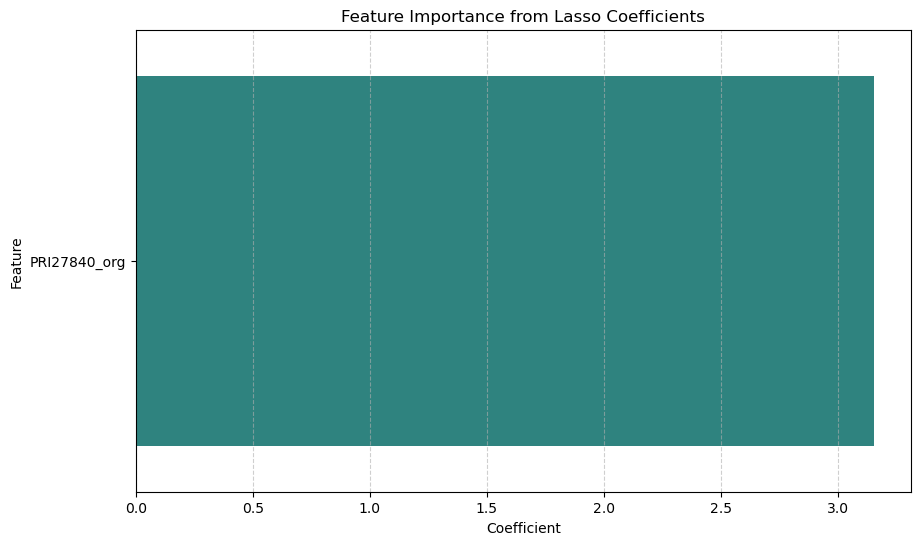

In [ ]:
# Function to plot feature importance according to Lasso coefficients
def plot_feature_importance(feature_importance, title):
    # Sort the features by their importance
    feature_importance = feature_importance.sort_values('Coefficient', ascending=False)
    # Create a bar plot of the feature importance
    plt.figure(figsize=(10, 6))
    sns.barplot(x='Coefficient', y='Feature', data=feature_importance, palette='viridis')
    plt.title(title)
    plt.xlabel('Coefficient')
    plt.ylabel('Feature')
    plt.grid(axis='x', linestyle='--', alpha=0.6)
    plt.show()

# Plot the feature importance according to Lasso coefficients
plot_feature_importance(lasso_coefficients_df, "Feature Importance from Lasso Coefficients")

## Marked Data Preprocessing

In [ ]:
market_data.columns

Index(['DATE', 'China_MAB_ELE_PRO156', 'China_MAB_ELE_SHP156',
       'France_MAB_ELE_PRO250', 'France_MAB_ELE_SHP250',
       'Germany_MAB_ELE_PRO276', 'Germany_MAB_ELE_SHP276',
       'Italy_MAB_ELE_PRO380', 'Italy_MAB_ELE_SHP380', 'Japan_MAB_ELE_PRO392',
       'Japan_MAB_ELE_SHP392', 'Switzerland_MAB_ELE_PRO756',
       'Switzerland_MAB_ELE_SHP756', 'United Kingdom_MAB_ELE_PRO826',
       'United Kingdom_MAB_ELE_SHP826', 'United States_MAB_ELE_PRO840',
       'United States_MAB_ELE_SHP840', 'Europe_MAB_ELE_PRO1100',
       'Europe_MAB_ELE_SHP1100', 'Europe_RohiBASEMET1000_org',
       'Europe_RohiENERGY1000_org', 'Europe_RohiMETMIN1000_org',
       'Europe_RohiNATGAS1000_org', 'Europe_RohCRUDE_PETRO1000_org',
       'Europe_RohCOPPER1000_org', 'Europe_WKLWEUR840_org',
       'Producer Prices_PRI27840_org', 'Producer Prices_PRI27826_org',
       'Producer Prices_PRI27380_org', 'Producer Prices_PRI27250_org',
       'Producer Prices_PRI27276_org', 'Producer Prices_PRI27156_org',
    

In [ ]:
# Production & Shipments Index Machinery & Electricals
prod_ship_features = [
    'DATE',
    'China_MAB_ELE_PRO156', 'China_MAB_ELE_SHP156',
    'France_MAB_ELE_PRO250', 'France_MAB_ELE_SHP250',
    'Germany_MAB_ELE_PRO276', 'Germany_MAB_ELE_SHP276',
    'Italy_MAB_ELE_PRO380', 'Italy_MAB_ELE_SHP380',
    'Japan_MAB_ELE_PRO392', 'Japan_MAB_ELE_SHP392',
    'Switzerland_MAB_ELE_PRO756', 'Switzerland_MAB_ELE_SHP756',
    'United Kingdom_MAB_ELE_PRO826', 'United Kingdom_MAB_ELE_SHP826',
    'United States_MAB_ELE_PRO840', 'United States_MAB_ELE_SHP840',
    'Europe_MAB_ELE_PRO1100', 'Europe_MAB_ELE_SHP1100'
]

# Prices of Materials
price_features = [
    'DATE',
    'Europe_RohiBASEMET1000_org', 'Europe_RohiENERGY1000_org',
    'Europe_RohiMETMIN1000_org', 'Europe_RohiNATGAS1000_org',
    'Europe_RohCRUDE_PETRO1000_org', 'Europe_RohCOPPER1000_org',
    'Europe_WKLWEUR840_org'
]

# Producer Prices
producer_price_features = [
    'DATE',
    'Producer Prices_PRI27840_org', 'Producer Prices_PRI27826_org',
    'Producer Prices_PRI27380_org', 'Producer Prices_PRI27250_org',
    'Producer Prices_PRI27276_org', 'Producer Prices_PRI27156_org'
]

# Production Index
production_index_features = [
    'DATE',
    'production index_PRO28840_org', 'production index_PRO281000_org',
    'production index_PRO28756_org', 'production index_PRO28826_org',
    'production index_PRO28380_org', 'production index_PRO28392_org',
    'production index_PRO28250_org', 'production index_PRO28276_org',
    'production index_PRO27840_org', 'production index_PRO271000_org',
    'production index_PRO27756_org', 'production index_PRO27826_org',
    'production index_PRO27380_org', 'production index_PRO27392_org',
    'production index_PRO27250_org', 'production index_PRO27276_org'
]

# Create separate DataFrames
# Create separate DataFrames (with explicit copies)
df_prod_ship = market_data[prod_ship_features].copy()
df_prices = market_data[price_features].copy()
df_producer_prices = market_data[producer_price_features].copy()
df_production_index = market_data[production_index_features].copy()

# Print dataset shapes to confirm
print(f"Production & Shipments: {df_prod_ship.shape}")
print(f"Prices of Materials: {df_prices.shape}")
print(f"Producer Prices: {df_producer_prices.shape}")
print(f"Production Index: {df_production_index.shape}")


Production & Shipments: (219, 19)
Prices of Materials: (219, 8)
Producer Prices: (219, 7)
Production Index: (219, 17)


### Product and Shipment Data 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 19 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   DATE                           219 non-null    datetime64[ns]
 1   China_MAB_ELE_PRO156           219 non-null    float64       
 2   China_MAB_ELE_SHP156           219 non-null    float64       
 3   France_MAB_ELE_PRO250          219 non-null    float64       
 4   France_MAB_ELE_SHP250          219 non-null    float64       
 5   Germany_MAB_ELE_PRO276         219 non-null    float64       
 6   Germany_MAB_ELE_SHP276         219 non-null    float64       
 7   Italy_MAB_ELE_PRO380           219 non-null    float64       
 8   Italy_MAB_ELE_SHP380           219 non-null    float64       
 9   Japan_MAB_ELE_PRO392           219 non-null    float64       
 10  Japan_MAB_ELE_SHP392           219 non-null    float64       
 11  Switzerland_MAB_ELE

array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >], dtype=object)

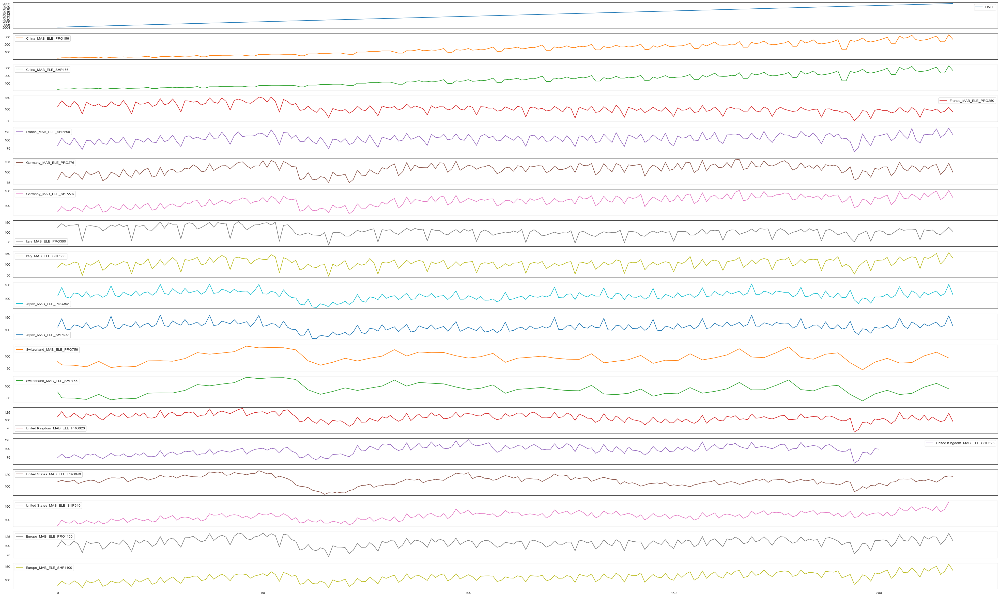

In [ ]:
### df_prod_ship
df_prod_ship.info()
df_prod_ship.describe()
df_prod_ship.isna().sum()
df_prod_ship.plot(subplots=True, figsize=(50, 30)) 

* Missing values are present in some columns (Switzerland_MAB_ELE_PRO756, Switzerland_MAB_ELE_SHP756, United Kingdom_MAB_ELE_SHP826, United States_MAB_ELE_SHP840).
* No extreme outliers stand out visually, but we should confirm with statistical methods.
* Trends look stable, meaning we can use time-series-based methods for handling missing values.

#### Outlier treatment (Product and Shipment Data)

In [ ]:
def detect_outliers_iqr(df):
    outliers = {}
    for col in df.columns[1:]: 
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR
        outliers[col] = df[(df[col] < lower) | (df[col] > upper)].shape[0]
    return outliers

outlier_counts = detect_outliers_iqr(df_prod_ship)
print(outlier_counts)


{'China_MAB_ELE_PRO156': 0, 'China_MAB_ELE_SHP156': 0, 'France_MAB_ELE_PRO250': 9, 'France_MAB_ELE_SHP250': 1, 'Germany_MAB_ELE_PRO276': 2, 'Germany_MAB_ELE_SHP276': 0, 'Italy_MAB_ELE_PRO380': 17, 'Italy_MAB_ELE_SHP380': 8, 'Japan_MAB_ELE_PRO392': 10, 'Japan_MAB_ELE_SHP392': 11, 'Switzerland_MAB_ELE_PRO756': 0, 'Switzerland_MAB_ELE_SHP756': 0, 'United Kingdom_MAB_ELE_PRO826': 2, 'United Kingdom_MAB_ELE_SHP826': 1, 'United States_MAB_ELE_PRO840': 5, 'United States_MAB_ELE_SHP840': 1, 'Europe_MAB_ELE_PRO1100': 4, 'Europe_MAB_ELE_SHP1100': 1}


Any values lower or higher than this range are counted as outliers. This helps identify unusually extreme data points that might distort analysis or model training.

In [ ]:
# Capping Outliers
def cap_outliers(df):
    for col in df.columns[1:]: 
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR
        df[col] = df[col].clip(lower, upper)  
    return df

df_prod_ship = cap_outliers(df_prod_ship)


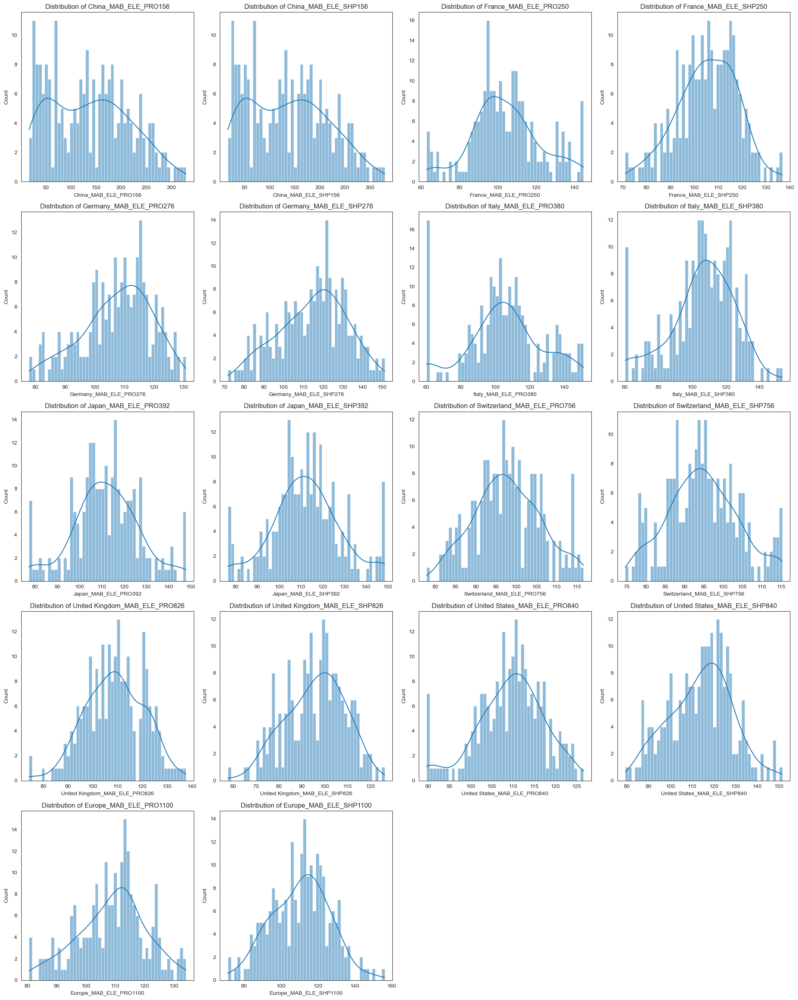

In [ ]:
#Checking for skewdness
num_cols = 4 
num_rows = int(np.ceil(len(df_prod_ship.columns[1:]) / num_cols)) 

# Create subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 5 * num_rows)) 

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through columns and plot
for i, col in enumerate(df_prod_ship.columns[1:]):
    sns.histplot(df_prod_ship[col], bins=50, kde=True, ax=axes[i])
    axes[i].set_title(f"Distribution of {col}")

# Remove any empty subplots (if total columns are not a multiple of num_cols)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j]) 

plt.tight_layout()  
plt.show()


Since most distributions look symmetric or slightly skewed, applying a log transformation wouldn’t improve things much.

#### Handling Missing values (Product and Shipment Data)

In [ ]:
# check missing values
missing_values = df_prod_ship.isnull().sum()
missing_values[missing_values > 0]

Switzerland_MAB_ELE_PRO756        1
Switzerland_MAB_ELE_SHP756        1
United Kingdom_MAB_ELE_SHP826    18
United States_MAB_ELE_SHP840      1
dtype: int64

In [ ]:
#missing production data is likely to continue trends from past values.
df_prod_ship.fillna(method='ffill', inplace=True)

#Applying Linear Interpolation for smoother transitions
df_prod_ship.interpolate(method='linear', inplace=True)

/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_54330/2836412164.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_prod_ship.fillna(method='ffill', inplace=True)


In [ ]:
# check missing values
missing_values = df_prod_ship.isnull().sum()
missing_values[missing_values > 0]

Series([], dtype: int64)

### Prices Data 

In [ ]:
#head of df_prices
df_prices.head()

,DATE,Europe_RohiBASEMET1000_org,Europe_RohiENERGY1000_org,Europe_RohiMETMIN1000_org,Europe_RohiNATGAS1000_org,Europe_RohCRUDE_PETRO1000_org,Europe_RohCOPPER1000_org,Europe_WKLWEUR840_org
0,2004-02-01,54.0398,44.1233,48.7479,87.0770,39.6395,36.6238,1.2646
1,2004-03-01,54.6662,47.5890,49.2562,87.1927,42.5920,39.9311,1.2262
2,2004-04-01,54.8727,47.7790,49.4238,91.3799,42.6506,39.1349,1.1985
3,2004-05-01,51.2304,53.5909,46.4684,99.0445,47.5171,36.2784,1.2007
4,2004-06-01,52.8763,50.7996,47.8039,98.6363,44.9676,35.6574,1.2138


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   DATE                           219 non-null    datetime64[ns]
 1   Europe_RohiBASEMET1000_org     219 non-null    float64       
 2   Europe_RohiENERGY1000_org      219 non-null    float64       
 3   Europe_RohiMETMIN1000_org      219 non-null    float64       
 4   Europe_RohiNATGAS1000_org      219 non-null    float64       
 5   Europe_RohCRUDE_PETRO1000_org  219 non-null    float64       
 6   Europe_RohCOPPER1000_org       219 non-null    float64       
 7   Europe_WKLWEUR840_org          219 non-null    float64       
dtypes: datetime64[ns](1), float64(7)
memory usage: 13.8 KB


array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >], dtype=object)

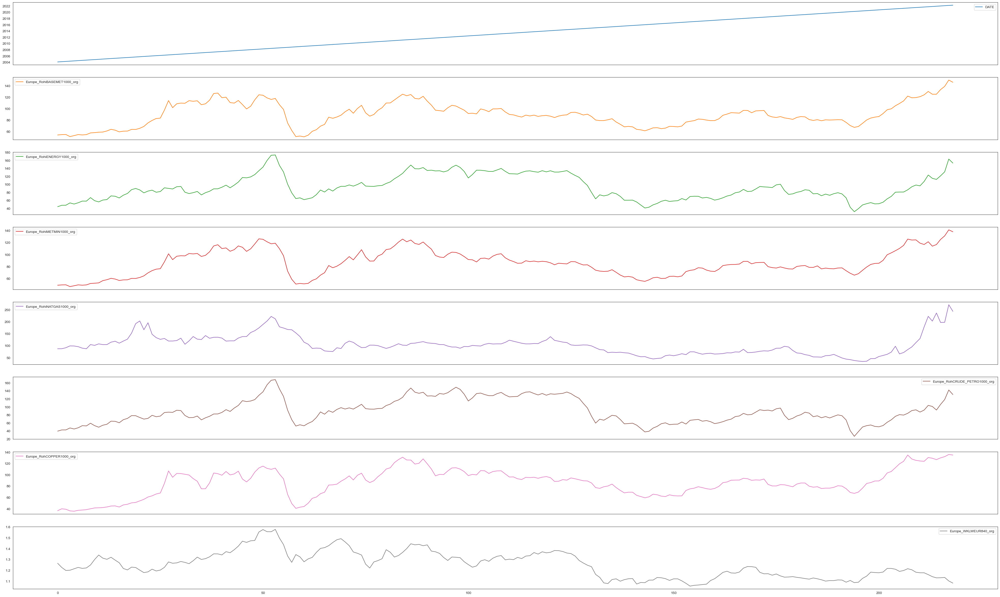

In [ ]:
df_prices.info()
df_prices.describe()
df_prices.isna().sum()
df_prices.plot(subplots=True, figsize=(50, 30))  # Visual overview


#### Handling Outliers Price Data

In [ ]:
#ckecking for outliers using the previous function

outlier_counts = detect_outliers_iqr(df_prices)
print(outlier_counts)


{'Europe_RohiBASEMET1000_org': 2, 'Europe_RohiENERGY1000_org': 0, 'Europe_RohiMETMIN1000_org': 0, 'Europe_RohiNATGAS1000_org': 13, 'Europe_RohCRUDE_PETRO1000_org': 0, 'Europe_RohCOPPER1000_org': 0, 'Europe_WKLWEUR840_org': 0}


Prices fluctuate due to supply, demand, and external shocks (e.g., oil crises, wars, inflation).
ARIMA expects real market variations, so removing true price spikes may hurt forecasting accuracy.
Therefore, instead of capping all outliers, we will only cap those in RohiNATGAS1000_org that exceed 3x the IQR range (very extreme cases)


In [ ]:
def cap_extreme_outliers(df, columns, factor=3):
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - factor * IQR
        upper = Q3 + factor * IQR
        df[col] = df[col].clip(lower, upper)  # Capping extreme outliers
    return df

# Apply only to Europe_RohiMETMIN1000_org
df_prices = cap_extreme_outliers(df_prices, ['Europe_RohiMETMIN1000_org'])


### Producer Prices Data 

In [ ]:
df_producer_prices.head()

,DATE,Producer Prices_PRI27840_org,Producer Prices_PRI27826_org,Producer Prices_PRI27380_org,Producer Prices_PRI27250_org,Producer Prices_PRI27276_org,Producer Prices_PRI27156_org
0,2004-02-01,78.9699,80.7574,93.0200,NaN,93.2305,NaN
1,2004-03-01,79.6736,80.9621,93.5403,NaN,93.3357,NaN
2,2004-04-01,80.3376,80.7574,93.8524,NaN,93.4409,NaN
3,2004-05-01,80.7988,80.7574,93.8524,NaN,93.5461,NaN
4,2004-06-01,80.9135,80.5527,93.9565,NaN,93.4409,NaN


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   DATE                          219 non-null    datetime64[ns]
 1   Producer Prices_PRI27840_org  219 non-null    float64       
 2   Producer Prices_PRI27826_org  201 non-null    float64       
 3   Producer Prices_PRI27380_org  219 non-null    float64       
 4   Producer Prices_PRI27250_org  184 non-null    float64       
 5   Producer Prices_PRI27276_org  219 non-null    float64       
 6   Producer Prices_PRI27156_org  196 non-null    float64       
dtypes: datetime64[ns](1), float64(6)
memory usage: 12.1 KB


array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >], dtype=object)

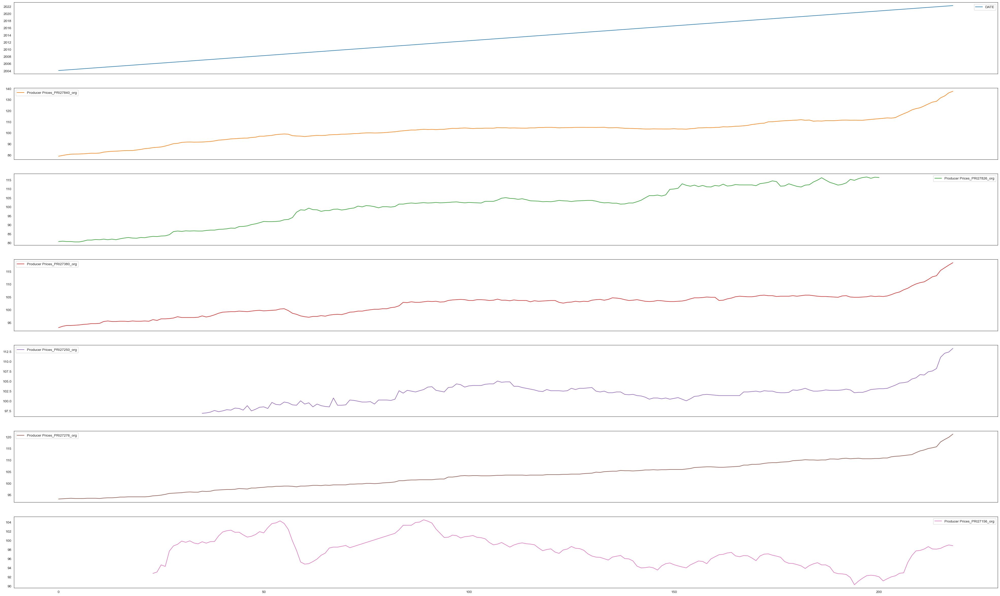

In [ ]:
df_producer_prices.info()
df_producer_prices.describe()
df_producer_prices.isna().sum()
df_producer_prices.plot(subplots=True, figsize=(50, 30))  # Visual overview


### Handling Outliers

In [ ]:
#ckecking for outliers using the previous function

outlier_counts = detect_outliers_iqr(df_producer_prices)
print(outlier_counts)

{'Producer Prices_PRI27840_org': 32, 'Producer Prices_PRI27826_org': 0, 'Producer Prices_PRI27380_org': 4, 'Producer Prices_PRI27250_org': 7, 'Producer Prices_PRI27276_org': 2, 'Producer Prices_PRI27156_org': 0}


In [ ]:
def cap_outliers(df, columns=None):
    if columns is None:
        columns = df.columns[1:]  # Default: skip first column (e.g. DATE)
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR
        df.loc[:, col] = df[col].clip(lower, upper)
    return df


In [ ]:
df_producer_prices = cap_outliers(df_producer_prices, ['Producer Prices_PRI27840_org', 'Producer Prices_PRI27250_org'])


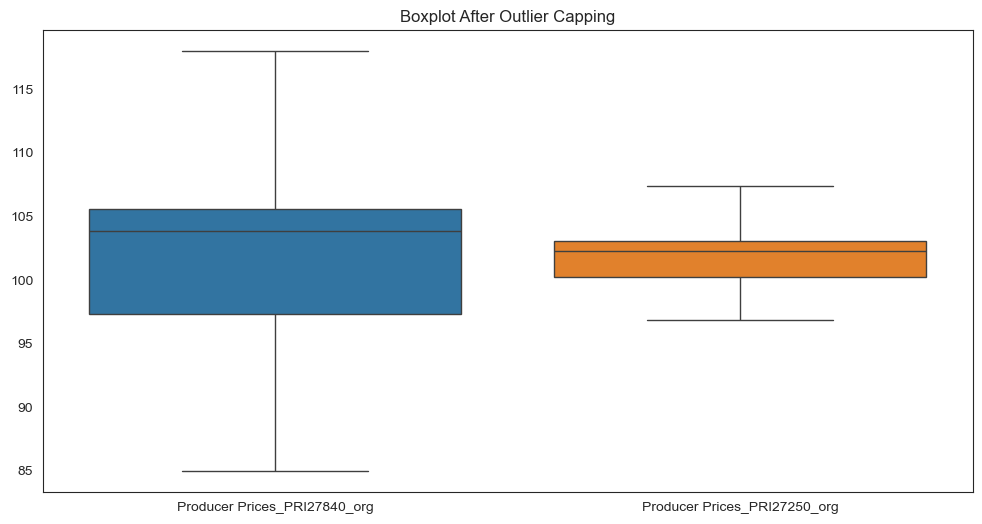

In [ ]:
#Visualising
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_producer_prices[['Producer Prices_PRI27840_org', 'Producer Prices_PRI27250_org']])
plt.title("Boxplot After Outlier Capping")
plt.show()


Decision for Remaining Outliers

1. Keep Producer Prices_PRI27276_org as is → Only 2 outliers, likely small impact
2. Keep Producer Producer Prices_PRI27380_org unless extreme → If they don’t affect trendlines, leave them

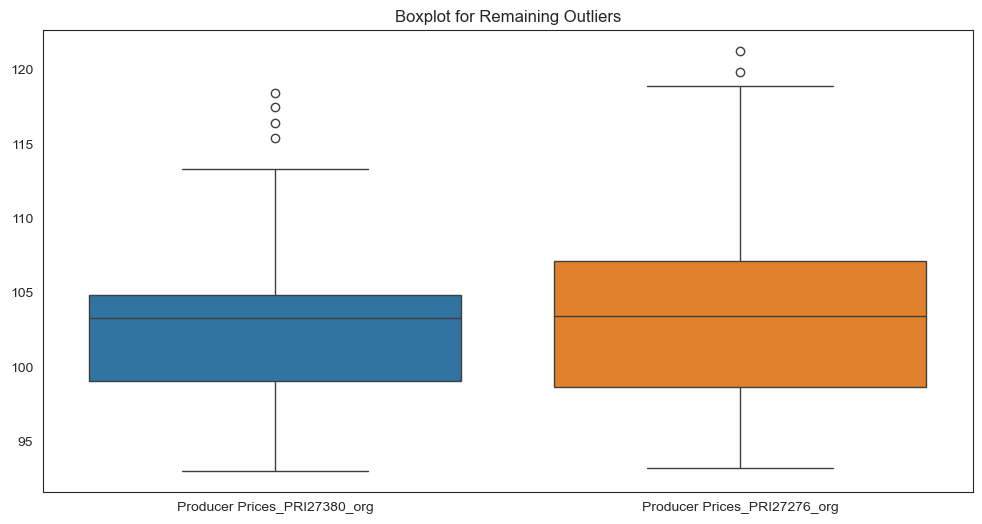

In [ ]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_producer_prices[['Producer Prices_PRI27380_org', 'Producer Prices_PRI27276_org']])
plt.title("Boxplot for Remaining Outliers")
plt.show()


In [ ]:
# Capping Mild Outliers
def cap_mild_outliers(df, columns, factor=3):  # Using a higher factor to preserve more data
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - factor * IQR
        upper = Q3 + factor * IQR
        df[col] = df[col].clip(lower, upper)
    return df

df_producer_prices = cap_mild_outliers(df_producer_prices, ['Producer Prices_PRI27380_org', 'Producer Prices_PRI27276_org'])

#### Handling Missing Values (Price Data)

In [ ]:
#check missing values
missing_values = df_producer_prices.isnull().sum()
missing_values[missing_values > 0]

Producer Prices_PRI27826_org    18
Producer Prices_PRI27250_org    35
Producer Prices_PRI27156_org    23
dtype: int64

Since this is producer price data, the best approach is to use trend-based methods (not random filling).

In [ ]:
# Forward Fill (ffill) to propagate previous values
df_producer_prices.fillna(method='ffill', inplace=True)

# Interpolate missing values linearly to estimate values between known points
df_producer_prices.interpolate(method='linear', inplace=True)

# Rolling Mean for `PRI27250_org` (as it has the most missing values)
df_producer_prices['Producer Prices_PRI27250_org'] = df_producer_prices['Producer Prices_PRI27250_org'].fillna(
    df_producer_prices['Producer Prices_PRI27250_org'].rolling(3, min_periods=1).mean()
)

# Backward Fill (bfill) to handle any remaining NaNs
df_producer_prices.fillna(method='bfill', inplace=True)

# Check if there are any remaining NaNs
print(df_producer_prices.isna().sum())


DATE                            0
Producer Prices_PRI27840_org    0
Producer Prices_PRI27826_org    0
Producer Prices_PRI27380_org    0
Producer Prices_PRI27250_org    0
Producer Prices_PRI27276_org    0
Producer Prices_PRI27156_org    0
dtype: int64


/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_54330/3968871302.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_producer_prices.fillna(method='ffill', inplace=True)
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_54330/3968871302.py:13: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_producer_prices.fillna(method='bfill', inplace=True)


### Production Index Data 

In [ ]:
#head of df_production_prices
df_production_index.head()

,DATE,production index_PRO28840_org,production index_PRO281000_org,production index_PRO28756_org,production index_PRO28826_org,production index_PRO28380_org,production index_PRO28392_org,production index_PRO28250_org,production index_PRO28276_org,production index_PRO27840_org,production index_PRO271000_org,production index_PRO27756_org,production index_PRO27826_org,production index_PRO27380_org,production index_PRO27392_org,production index_PRO27250_org,production index_PRO27276_org
0,2004-02-01,102.4917,97.5974,97.1000,106.1920,116.7903,110.8900,118.2741,80.8290,117.7240,NaN,81.1000,120.7065,141.5109,106.1613,102.0771,85.9132
1,2004-03-01,105.6275,113.2249,91.1951,121.6251,139.2884,141.1769,148.1218,102.1301,119.2208,NaN,76.6903,138.3095,152.8802,140.2887,117.2257,97.6708
2,2004-04-01,103.4850,100.1691,93.7935,104.9655,125.2896,105.6488,125.4822,90.9614,117.4411,NaN,71.5524,115.5573,137.7969,106.2712,105.3358,87.2540
3,2004-05-01,103.6439,99.5814,96.3920,105.8854,131.9890,101.9904,116.6497,88.0829,117.8992,NaN,66.4145,119.2695,143.8605,101.6087,96.6165,84.6756
4,2004-06-01,106.0627,109.2777,98.9904,118.2523,132.9889,122.1366,143.2487,100.9787,119.4991,NaN,61.2766,128.8494,144.3153,116.6552,118.4587,95.4018


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   DATE                            219 non-null    datetime64[ns]
 1   production index_PRO28840_org   219 non-null    float64       
 2   production index_PRO281000_org  219 non-null    float64       
 3   production index_PRO28756_org   218 non-null    float64       
 4   production index_PRO28826_org   219 non-null    float64       
 5   production index_PRO28380_org   219 non-null    float64       
 6   production index_PRO28392_org   219 non-null    float64       
 7   production index_PRO28250_org   219 non-null    float64       
 8   production index_PRO28276_org   219 non-null    float64       
 9   production index_PRO27840_org   219 non-null    float64       
 10  production index_PRO271000_org  208 non-null    float64       
 11  produc

array([<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
       <Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >], dtype=object)

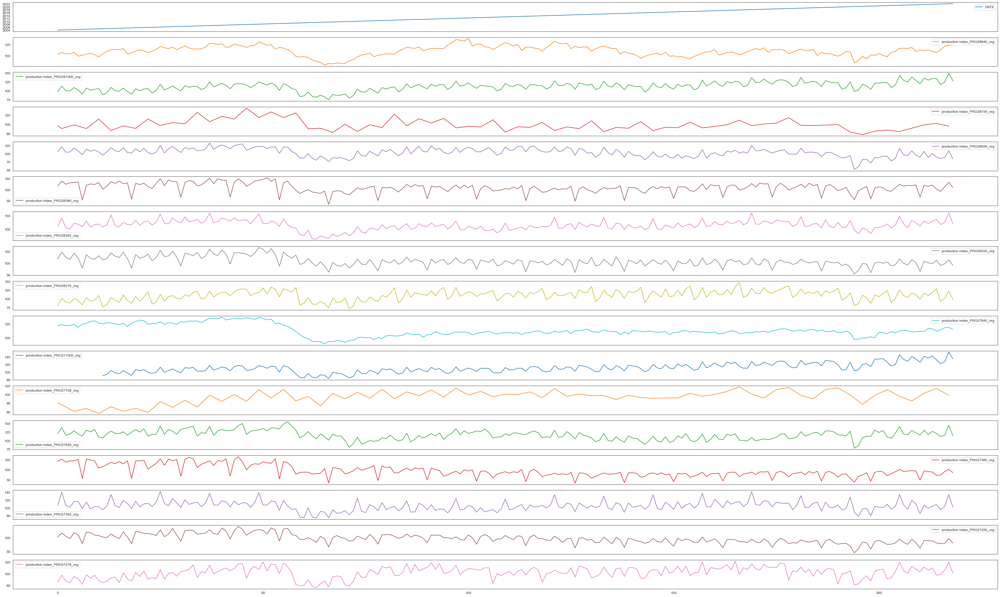

In [ ]:
df_production_index.info()
df_production_index.describe()
df_production_index.isna().sum()
df_production_index.plot(subplots=True, figsize=(50, 30))  # Visual overview

In [ ]:
outlier_counts = detect_outliers_iqr(df_production_index)
print(outlier_counts)

{'production index_PRO28840_org': 1, 'production index_PRO281000_org': 3, 'production index_PRO28756_org': 8, 'production index_PRO28826_org': 2, 'production index_PRO28380_org': 14, 'production index_PRO28392_org': 9, 'production index_PRO28250_org': 7, 'production index_PRO28276_org': 2, 'production index_PRO27840_org': 1, 'production index_PRO271000_org': 5, 'production index_PRO27756_org': 21, 'production index_PRO27826_org': 2, 'production index_PRO27380_org': 2, 'production index_PRO27392_org': 8, 'production index_PRO27250_org': 1, 'production index_PRO27276_org': 0}


High outlier counts in:

- production index_PRO27756_org (21 outliers)
- production index_PRO28380_org (14 outliers)
- production index_PRO28392_org (9 outliers)

Moderate outlier counts in:

- production index_PRO28756_org, production index_PRO27392_org, production index_PRO28250_org (7–8 outliers)

Low outlier counts in:

- production index_PRO28840_org, production index_PRO28826_org, production index_PRO27840_org, production index_PRO271000_org, production index_PRO27826_org, production index_PRO27380_org, production index_PRO27250_org (1-5 outliers)

In [ ]:
# For HIGH outliers
def cap_outliers(df, columns, factor=1.5):  
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower = Q1 - factor * IQR
        upper = Q3 + factor * IQR
        df[col] = df[col].clip(lower, upper)  # Capping outliers
    return df

df_production_index = cap_outliers(df_production_index, ['production index_PRO27756_org', 'production index_PRO28380_org', 'production index_PRO28392_org'])


In [ ]:
# For Moderate outliers
df_production_index = cap_outliers(df_production_index, ['production index_PRO28756_org', 'production index_PRO27392_org', 'production index_PRO28250_org'], factor=3)


([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15],
 [Text(0, 0, 'production index_PRO28840_org'),
  Text(1, 0, 'production index_PRO281000_org'),
  Text(2, 0, 'production index_PRO28756_org'),
  Text(3, 0, 'production index_PRO28826_org'),
  Text(4, 0, 'production index_PRO28380_org'),
  Text(5, 0, 'production index_PRO28392_org'),
  Text(6, 0, 'production index_PRO28250_org'),
  Text(7, 0, 'production index_PRO28276_org'),
  Text(8, 0, 'production index_PRO27840_org'),
  Text(9, 0, 'production index_PRO271000_org'),
  Text(10, 0, 'production index_PRO27756_org'),
  Text(11, 0, 'production index_PRO27826_org'),
  Text(12, 0, 'production index_PRO27380_org'),
  Text(13, 0, 'production index_PRO27392_org'),
  Text(14, 0, 'production index_PRO27250_org'),
  Text(15, 0, 'production index_PRO27276_org')])

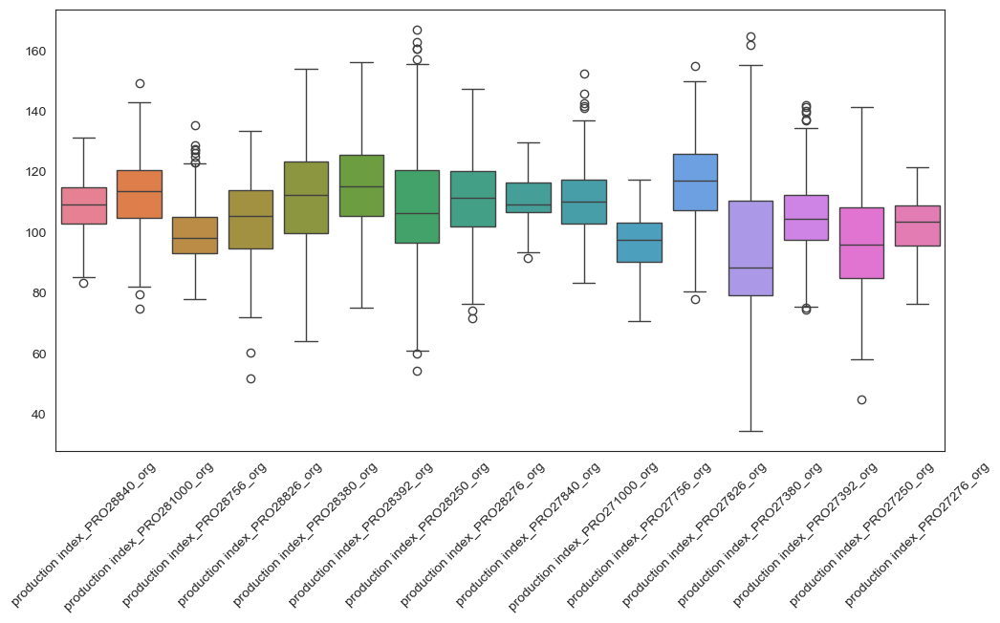

In [ ]:
#check outliers
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_production_index.iloc[:, 1:])
plt.xticks(rotation=45)

In [ ]:
# check missing values
missing_values = df_production_index.isnull().sum()
missing_values[missing_values > 0]

production index_PRO28756_org      1
production index_PRO271000_org    11
production index_PRO27756_org      1
dtype: int64

In [ ]:
# Forward Fill
df_production_index.fillna(method='ffill', inplace=True)

# Linear Interpolation
df_production_index.interpolate(method='linear', inplace=True)

# Backward Fill
df_production_index.fillna(method='bfill', inplace=True)

print(df_production_index.isna().sum()) 


DATE                              0
production index_PRO28840_org     0
production index_PRO281000_org    0
production index_PRO28756_org     0
production index_PRO28826_org     0
production index_PRO28380_org     0
production index_PRO28392_org     0
production index_PRO28250_org     0
production index_PRO28276_org     0
production index_PRO27840_org     0
production index_PRO271000_org    0
production index_PRO27756_org     0
production index_PRO27826_org     0
production index_PRO27380_org     0
production index_PRO27392_org     0
production index_PRO27250_org     0
production index_PRO27276_org     0
dtype: int64


/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_54330/4038881791.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_production_index.fillna(method='ffill', inplace=True)
/var/folders/28/dyw7s0_j39z2g3qcp40tr5300000gn/T/ipykernel_54330/4038881791.py:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df_production_index.fillna(method='bfill', inplace=True)


## Forecasting Market Data for 10 months

In [ ]:
pip install pmdarima matplotlib statsmodels

Note: you may need to restart the kernel to use updated packages.


### Forecast Product Shipment

In [ ]:
# Ensure 'date' column is datetime and set as index
df_prod_ship['DATE'] = pd.to_datetime(df_prod_ship['DATE'])
df_prod_ship.set_index('DATE', inplace=True)
df_prod_ship.index.name = 'DATE'

# Forecast config
forecast_horizon = 10
adf_results = {}
sarima_models = {}
future_forecasts = {}

In [ ]:
# Loop through each time series column
for col in df_prod_ship.columns:
    print(f"\nForecasting: {col}")
    
    ts = df_prod_ship[col]

    # Ensure index is datetime 
    ts.index = pd.to_datetime(ts.index)

    # ADF test for stationarity 
    try:
        adf_stat, p_value, _, _, _, _ = adfuller(ts)
        adf_results[col] = {'ADF Statistic': adf_stat, 'p-value': p_value}
        print(f" ADF p-value: {p_value:.4f}")
    except Exception as e:
        print(f" ADF test failed for {col}: {e}")

    # Fit SARIMA model
    try:
        model = auto_arima(
            ts,
            seasonal=True,
            m=12,  # Monthly seasonality
            stepwise=True,
            suppress_warnings=True,
            trace=False,
            max_p=3, max_q=3, max_P=2, max_Q=2, max_order=10,
            n_jobs=-1
        )

        sarima_models[col] = model

        # Forecast next 10 months
        forecast = model.predict(n_periods=forecast_horizon)

        # Generate correct future monthly dates
        last_date = ts.index[-1]
        future_dates = pd.date_range(start=last_date + pd.DateOffset(months=1),
                                     periods=forecast_horizon, freq='MS')

        # Create forecast series
        forecast_series = pd.Series(forecast, index=future_dates)

        # Prepend the last historical value if not already present
        last_value = ts.iloc[-1]
        last_date = ts.index[-1]
        if last_date not in forecast_series.index:
            forecast_series = pd.concat([pd.Series([last_value], index=[last_date]), forecast_series])

        # Drop duplicates just in case
        forecast_series = forecast_series[~forecast_series.index.duplicated(keep='first')]

        # Save final forecast series
        future_forecasts[col] = forecast_series

    except Exception as e:
        print(f" SARIMA model failed for {col}: {e}")
        continue

# Optionally print all forecast results
print(future_forecasts)



Forecasting: China_MAB_ELE_PRO156
 ADF p-value: 0.9853


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: China_MAB_ELE_SHP156
 ADF p-value: 0.9853


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: France_MAB_ELE_PRO250
 ADF p-value: 0.3359


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: France_MAB_ELE_SHP250
 ADF p-value: 0.0377


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Germany_MAB_ELE_PRO276
 ADF p-value: 0.0004


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Germany_MAB_ELE_SHP276
 ADF p-value: 0.0804


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Italy_MAB_ELE_PRO380
 ADF p-value: 0.2499


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Italy_MAB_ELE_SHP380
 ADF p-value: 0.2938


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Japan_MAB_ELE_PRO392
 ADF p-value: 0.0343


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Japan_MAB_ELE_SHP392
 ADF p-value: 0.0142


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Switzerland_MAB_ELE_PRO756
 ADF p-value: 0.0001


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Switzerland_MAB_ELE_SHP756
 ADF p-value: 0.0002


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: United Kingdom_MAB_ELE_PRO826
 ADF p-value: 0.0794


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: United Kingdom_MAB_ELE_SHP826
 ADF p-value: 0.0957


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: United States_MAB_ELE_PRO840
 ADF p-value: 0.0004


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: United States_MAB_ELE_SHP840
 ADF p-value: 0.4763


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Europe_MAB_ELE_PRO1100
 ADF p-value: 0.0127


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '
/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_auto_solvers.py:524: ModelFitWarning: Error fitting  ARIMA(3,0,0)(2,0,1)[12] intercept (if you do not want to see these warnings, run with error_action="ignore").
Traceback:
Traceback (most recent call last):
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_auto_solvers.py", line 508, in _fit_candidate_model
    fit.fit(y, X=X, **fit_params)
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/arima.py", line 603, in fit
    self._fit(y, X, **fit_args)
  File "/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/arima.py", line 524, in _fit
    fit, self.arima_res_ = _fit_wr


Forecasting: Europe_MAB_ELE_SHP1100
 ADF p-value: 0.3560


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '


{'China_MAB_ELE_PRO156': 2022-04-01   267.3731
2022-05-01   284.6931
2022-06-01   318.8517
2022-07-01   268.8731
2022-08-01   260.8095
2022-09-01   268.8148
2022-10-01   281.3720
2022-11-01   302.1599
2022-12-01   322.6253
2023-01-01   244.2697
2023-02-01   244.5172
dtype: float64, 'China_MAB_ELE_SHP156': 2022-04-01   267.3731
2022-05-01   284.6931
2022-06-01   318.8517
2022-07-01   268.8731
2022-08-01   260.8095
2022-09-01   268.8148
2022-10-01   281.3720
2022-11-01   302.1599
2022-12-01   322.6253
2023-01-01   244.2697
2023-02-01   244.5172
dtype: float64, 'France_MAB_ELE_PRO250': 2022-04-01    87.6981
2022-05-01    85.9201
2022-06-01   105.4241
2022-07-01    93.9546
2022-08-01    63.8007
2022-09-01   101.1775
2022-10-01    99.5295
2022-11-01    94.7842
2022-12-01    98.0449
2023-01-01    84.8882
2023-02-01    89.3900
dtype: float64, 'France_MAB_ELE_SHP250': 2022-04-01   116.5287
2022-05-01   113.8296
2022-06-01   138.8054
2022-07-01   116.0129
2022-08-01   101.5171
2022-09-01   129.

In [ ]:
# Combine all forecasts into one DataFrame
forecast_df_prod_ship = pd.DataFrame(future_forecasts)
forecast_df_prod_ship.index.name = 'DATE'

In [ ]:

print(forecast_df_prod_ship.head())

            China_MAB_ELE_PRO156  China_MAB_ELE_SHP156  France_MAB_ELE_PRO250  \
DATE                                                                            
2022-04-01              267.3731              267.3731                87.6981   
2022-05-01              284.6931              284.6931                85.9201   
2022-06-01              318.8517              318.8517               105.4241   
2022-07-01              268.8731              268.8731                93.9546   
2022-08-01              260.8095              260.8095                63.8007   

            France_MAB_ELE_SHP250  Germany_MAB_ELE_PRO276  \
DATE                                                        
2022-04-01               116.5287                 99.5222   
2022-05-01               113.8296                 99.0532   
2022-06-01               138.8054                113.4746   
2022-07-01               116.0129                109.0433   
2022-08-01               101.5171                 99.8842   

    

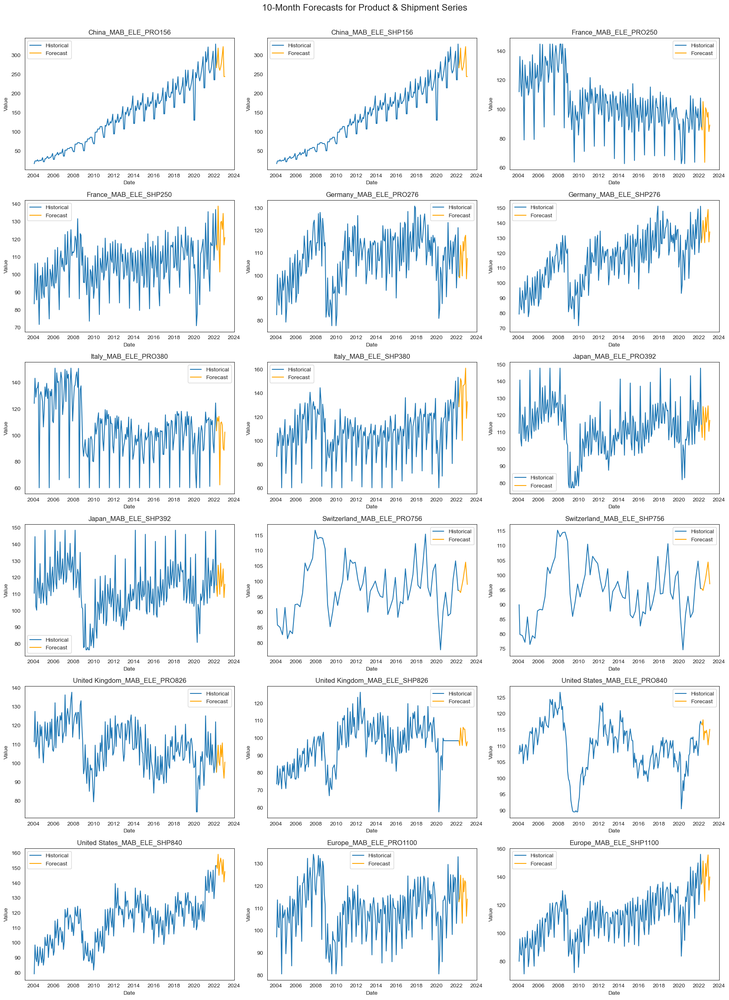

In [ ]:
import math

# Define columns to plot (all forecasted columns)
cols = forecast_df_prod_ship.columns
n_cols = 3
n_rows = math.ceil(len(cols) / n_cols)

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()

# Plot each column in its subplot
for i, col in enumerate(cols):
    ax = axes[i]
    ax.plot(df_prod_ship[col], label='Historical')
    ax.plot(forecast_df_prod_ship[col], label='Forecast', color='orange')
    ax.set_title(f"{col}")
    ax.set_xlabel("Date")
    ax.set_ylabel("Value")
    ax.legend()

# Hide unused subplots if any
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle("10-Month Forecasts for Product & Shipment Series", fontsize=16, y=1.02)
plt.show()


## Forecasting Price

In [ ]:
# Ensure 'date' column is datetime and set as index
df_prices['DATE'] = pd.to_datetime(df_prices['DATE'])
df_prices.set_index('DATE', inplace=True)
df_prices.index.name = 'DATE'

# Forecast config
forecast_horizon = 10
adf_results = {}
sarima_models = {}
future_forecasts = {}

In [ ]:
# Loop through each time series column
for col in df_prices.columns:
    print(f"\n Forecasting: {col}")
    
    ts = df_prices[col]

    # Ensure index is datetime 
    ts.index = pd.to_datetime(ts.index)

    # ADF test for stationarity 
    try:
        adf_stat, p_value, _, _, _, _ = adfuller(ts)
        adf_results[col] = {'ADF Statistic': adf_stat, 'p-value': p_value}
        print(f"  ADF p-value: {p_value:.4f}")
    except Exception as e:
        print(f" ADF test failed for {col}: {e}")

    # Fit SARIMA model
    try:
        model = auto_arima(
            ts,
            seasonal=True,
            m=12,  # Monthly seasonality
            stepwise=True,
            suppress_warnings=True,
            trace=False,
            max_p=3, max_q=3, max_P=2, max_Q=2, max_order=10,
            n_jobs=-1
        )

        sarima_models[col] = model

        # Forecast next 'forecast_horizon' months
        forecast = model.predict(n_periods=forecast_horizon)

        # Generate correct future monthly dates
        last_date = ts.index[-1]
        future_dates = pd.date_range(start=last_date + pd.DateOffset(months=1),
                                     periods=forecast_horizon, freq='MS')

        # Create forecast series
        forecast_series = pd.Series(forecast, index=future_dates)

        # Optionally, prepend the last value if you want continuity
        last_value = ts.iloc[-1]
        if future_dates[0] != last_date:
            forecast_series = pd.concat([pd.Series([last_value], index=[last_date]), forecast_series])

        # Store the result
        future_forecasts[col] = forecast_series

    except Exception as e:
        print(f" SARIMA model failed for {col}: {e}")
        continue

# Optionally print all forecast results
print(future_forecasts)



 Forecasting: Europe_RohiBASEMET1000_org
  ADF p-value: 0.2565


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



 Forecasting: Europe_RohiENERGY1000_org
  ADF p-value: 0.0903


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



 Forecasting: Europe_RohiMETMIN1000_org
  ADF p-value: 0.2063


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



 Forecasting: Europe_RohiNATGAS1000_org
  ADF p-value: 0.2984


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



 Forecasting: Europe_RohCRUDE_PETRO1000_org
  ADF p-value: 0.0320


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



 Forecasting: Europe_RohCOPPER1000_org
  ADF p-value: 0.1248


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



 Forecasting: Europe_WKLWEUR840_org
  ADF p-value: 0.4513


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '


{'Europe_RohiBASEMET1000_org': 2022-04-01   146.0910
2022-05-01   143.8154
2022-06-01   141.7192
2022-07-01   139.4705
2022-08-01   137.0003
2022-09-01   134.3087
2022-10-01   131.4141
2022-11-01   128.3403
2022-12-01   125.1125
2023-01-01   121.7563
2023-02-01   118.2978
dtype: float64, 'Europe_RohiENERGY1000_org': 2022-04-01   153.1889
2022-05-01   149.5110
2022-06-01   148.1581
2022-07-01   147.6603
2022-08-01   147.4772
2022-09-01   147.4099
2022-10-01   147.3851
2022-11-01   147.3760
2022-12-01   147.3726
2023-01-01   147.3714
2023-02-01   147.3710
dtype: float64, 'Europe_RohiMETMIN1000_org': 2022-04-01   138.0941
2022-05-01   135.5027
2022-06-01   133.2085
2022-07-01   131.0895
2022-08-01   129.0942
2022-09-01   127.2001
2022-10-01   125.3955
2022-11-01   123.6738
2022-12-01   122.0302
2023-01-01   120.4607
2023-02-01   118.9618
dtype: float64, 'Europe_RohiNATGAS1000_org': 2022-04-01   243.4360
2022-05-01   255.6741
2022-06-01   264.5302
2022-07-01   241.3725
2022-08-01   263.849

In [ ]:
# Combine all forecasts into one DataFrame
forecast_df_prices = pd.DataFrame(future_forecasts)
forecast_df_prices.index.name = 'DATE'

In [ ]:

print(forecast_df_prices.head())

            Europe_RohiBASEMET1000_org  Europe_RohiENERGY1000_org  \
DATE                                                                
2022-04-01                    146.0910                   153.1889   
2022-05-01                    143.8154                   149.5110   
2022-06-01                    141.7192                   148.1581   
2022-07-01                    139.4705                   147.6603   
2022-08-01                    137.0003                   147.4772   

            Europe_RohiMETMIN1000_org  Europe_RohiNATGAS1000_org  \
DATE                                                               
2022-04-01                   138.0941                   243.4360   
2022-05-01                   135.5027                   255.6741   
2022-06-01                   133.2085                   264.5302   
2022-07-01                   131.0895                   241.3725   
2022-08-01                   129.0942                   263.8498   

            Europe_RohCRUDE_PETRO1000_o

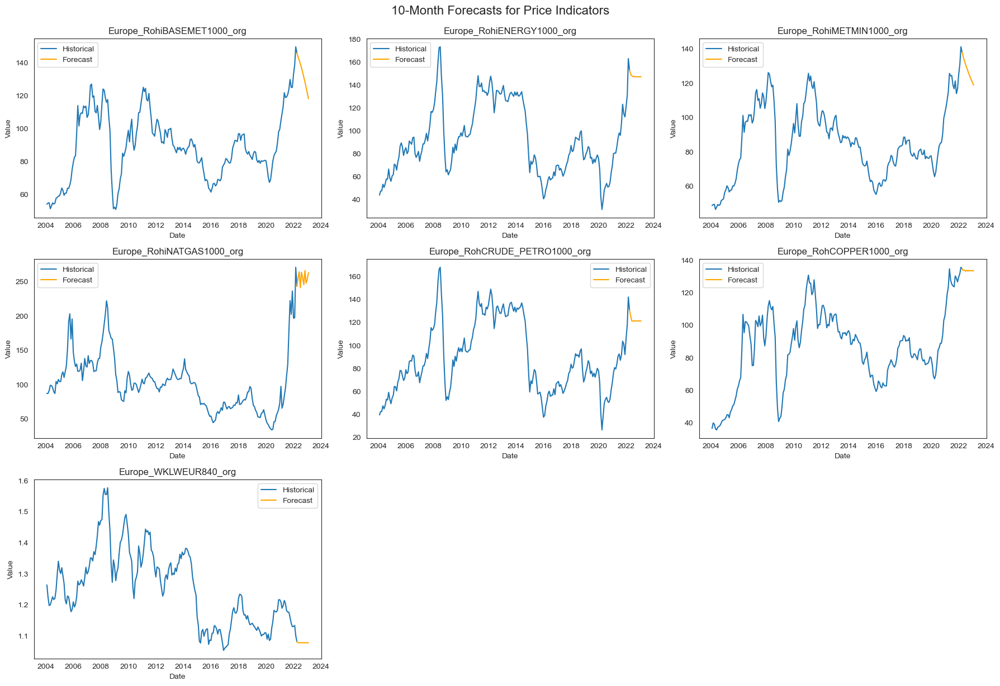

In [ ]:
# Define the columns and grid layout
cols = forecast_df_prices.columns
n_cols = 3  # plots per row
n_rows = math.ceil(len(cols) / n_cols)

# Create the figure and axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()

#  Plot each forecast vs. historical
for i, col in enumerate(cols):
    ax = axes[i]
    ax.plot(df_prices[col], label='Historical')
    ax.plot(forecast_df_prices[col], label='Forecast', color='orange')
    ax.set_title(col)
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.legend()

# Hide unused subplots 
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle("10-Month Forecasts for Price Indicators", fontsize=16, y=1.02)
plt.show()


### Producer Price Forecast

In [ ]:
# Ensure 'date' column is datetime and set as index
df_producer_prices['DATE'] = pd.to_datetime(df_producer_prices['DATE'])
df_producer_prices.set_index('DATE', inplace=True)
df_producer_prices.index.name = 'DATE'

# Forecast config
forecast_horizon = 10
adf_results = {}
sarima_models = {}
future_forecasts = {}

In [ ]:
# Forecast each time series in the dataset using SARIMA and store future predictions
for col in df_producer_prices.columns:
    print(f"\nForecasting: {col}")
    ts = df_producer_prices[col]

    if ts.isnull().all() or ts.nunique() < 2:
        print(f"  Skipping {col} due to insufficient or constant data.")
        continue

    # ADF test for stationarity
    try:
        adf_stat, p_value, *_ = adfuller(ts.dropna())
        adf_results[col] = {'ADF Statistic': adf_stat, 'p-value': p_value}
        print(f"  ADF p-value: {p_value:.4f}")
    except Exception as e:
        print(f"  ADF test failed for {col}: {e}")
        continue

    # SARIMA forecasting
    try:
        model = auto_arima(
            ts.dropna(),
            seasonal=True,
            m=12,  # Monthly seasonality
            stepwise=True,
            suppress_warnings=True,
            trace=False,
            max_p=3, max_q=3, max_P=2, max_Q=2, max_order=10,
            n_jobs=-1
        )
        sarima_models[col] = model

        forecast = model.predict(n_periods=forecast_horizon)

        last_date = ts.index[-1]
        future_dates = pd.date_range(start=last_date + pd.DateOffset(months=1),
                                     periods=forecast_horizon, freq='MS')
        forecast_series = pd.Series(forecast, index=future_dates)

        if last_date not in forecast_series.index:
            forecast_series = pd.concat([pd.Series([ts.iloc[-1]], index=[last_date]), forecast_series])

        forecast_series = forecast_series[~forecast_series.index.duplicated(keep='first')]
        future_forecasts[col] = forecast_series

    except Exception as e:
        print(f"  SARIMA model failed for {col}: {e}")
        continue



Forecasting: Producer Prices_PRI27840_org
  ADF p-value: 0.7929


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Producer Prices_PRI27826_org
  ADF p-value: 0.5866


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Producer Prices_PRI27380_org
  ADF p-value: 0.9980


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Producer Prices_PRI27250_org
  ADF p-value: 0.8188


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Producer Prices_PRI27276_org
  ADF p-value: 0.9983


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: Producer Prices_PRI27156_org
  ADF p-value: 0.1005


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '


In [ ]:
# Combine all forecasts into one DataFrame
forecast_df_producer_price = pd.DataFrame(future_forecasts)
forecast_df_producer_price.index.name = 'DATE'

In [ ]:

print(forecast_df_producer_price.head())

            Producer Prices_PRI27840_org  Producer Prices_PRI27826_org  \
DATE                                                                     
2022-04-01                      117.9743                      116.2743   
2022-05-01                      118.0469                      116.4171   
2022-06-01                      118.1442                      116.5775   
2022-07-01                      118.2683                      116.7400   
2022-08-01                      118.3994                      116.9028   

            Producer Prices_PRI27380_org  Producer Prices_PRI27250_org  \
DATE                                                                     
2022-04-01                      118.4080                      107.3668   
2022-05-01                      119.2555                      107.4800   
2022-06-01                      120.0649                      107.7092   
2022-07-01                      120.8382                      107.8328   
2022-08-01                      121.5

## Product Index Forecasting

In [ ]:
# Ensure 'date' column is datetime and set as index
df_production_index['DATE'] = pd.to_datetime(df_production_index['DATE'])
df_production_index.set_index('DATE', inplace=True)
df_production_index.index.name = 'DATE'

# Forecast config
forecast_horizon = 10
adf_results = {}
sarima_models = {}
future_forecasts = {}

In [ ]:
# Loop through each time series column
for col in df_production_index.columns:
    print(f"\nForecasting: {col}")
    
    ts = df_production_index[col]

    # Ensure index is datetime 
    ts.index = pd.to_datetime(ts.index)

    # ADF test for stationarity 
    try:
        adf_stat, p_value, _, _, _, _ = adfuller(ts)
        adf_results[col] = {'ADF Statistic': adf_stat, 'p-value': p_value}
        print(f"  ADF p-value: {p_value:.4f}")
    except Exception as e:
        print(f"  ADF test failed for {col}: {e}")

    # Fit SARIMA model
    try:
        model = auto_arima(
            ts,
            seasonal=True,
            m=12,  # Monthly seasonality
            stepwise=True,
            suppress_warnings=True,
            trace=False,
            max_p=3, max_q=3, max_P=2, max_Q=2, max_order=10,
            n_jobs=-1
        )

        sarima_models[col] = model

        # Forecast next 10 months
        forecast = model.predict(n_periods=forecast_horizon)

        # Generate future dates
        last_date = ts.index[-1]
        future_dates = pd.date_range(start=last_date + pd.DateOffset(months=1),
                                     periods=forecast_horizon, freq='MS')

        # Build forecast series
        forecast_series = pd.Series(forecast, index=future_dates)

        # Prepend last historical value for continuity if necessary
        last_value = ts.iloc[-1]
        if future_dates[0] != last_date:
            forecast_series = pd.concat([pd.Series([last_value], index=[last_date]), forecast_series])

        # Drop duplicates just in case
        forecast_series = forecast_series[~forecast_series.index.duplicated(keep='first')]

        # Store forecast
        future_forecasts[col] = forecast_series

    except Exception as e:
        print(f"  SARIMA model failed for {col}: {e}")
        continue

# Optionally print all forecast results
print(future_forecasts)



Forecasting: production index_PRO28840_org
  ADF p-value: 0.0003


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO281000_org
  ADF p-value: 0.2803


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO28756_org
  ADF p-value: 0.0006


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO28826_org
  ADF p-value: 0.0658


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO28380_org
  ADF p-value: 0.0400


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO28392_org
  ADF p-value: 0.0291


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO28250_org
  ADF p-value: 0.1338


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO28276_org
  ADF p-value: 0.0012


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO27840_org
  ADF p-value: 0.0348


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO271000_org
  ADF p-value: 0.8255


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO27756_org
  ADF p-value: 0.0579


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO27826_org
  ADF p-value: 0.1688


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO27380_org
  ADF p-value: 0.3577


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO27392_org
  ADF p-value: 0.1051


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO27250_org
  ADF p-value: 0.6909


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '



Forecasting: production index_PRO27276_org
  ADF p-value: 0.0001


/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/pmdarima/arima/_validation.py:76: UserWarning: stepwise model cannot be fit in parallel (n_jobs=1). Falling back to stepwise parameter search.
  warnings.warn('stepwise model cannot be fit in parallel (n_jobs=%i). '


{'production index_PRO28840_org': 2022-04-01   119.3855
2022-05-01   118.5100
2022-06-01   120.6603
2022-07-01   112.5244
2022-08-01   115.6514
2022-09-01   114.7770
2022-10-01   115.0042
2022-11-01   112.6233
2022-12-01   109.3916
2023-01-01   113.2485
2023-02-01   116.7701
dtype: float64, 'production index_PRO281000_org': 2022-04-01   128.2857
2022-05-01   131.0305
2022-06-01   140.8489
2022-07-01   131.8268
2022-08-01   125.0469
2022-09-01   139.2949
2022-10-01   134.9712
2022-11-01   138.0789
2022-12-01   136.6428
2023-01-01   121.2148
2023-02-01   129.0091
dtype: float64, 'production index_PRO28756_org': 2022-04-01    96.3606
2022-05-01    96.1468
2022-06-01    95.1508
2022-07-01    96.6988
2022-08-01    97.7669
2022-09-01    99.2688
2022-10-01    99.9530
2022-11-01   100.9756
2022-12-01   101.6985
2023-01-01    98.5588
2023-02-01    95.1681
dtype: float64, 'production index_PRO28826_org': 2022-04-01    84.7287
2022-05-01    86.1540
2022-06-01   101.3876
2022-07-01    94.7273
2022

In [ ]:
# Combine all forecasts into one DataFrame
forecast_df_production_index = pd.DataFrame(future_forecasts)
forecast_df_production_index.name = 'DATE'

In [ ]:
# Preview and save
print("\n Forecasting complete! Here's a preview:")
print(forecast_df_production_index.head())


 Forecasting complete! Here's a preview:
            production index_PRO28840_org  production index_PRO281000_org  \
2022-04-01                       119.3855                        128.2857   
2022-05-01                       118.5100                        131.0305   
2022-06-01                       120.6603                        140.8489   
2022-07-01                       112.5244                        131.8268   
2022-08-01                       115.6514                        125.0469   

            production index_PRO28756_org  production index_PRO28826_org  \
2022-04-01                        96.3606                        84.7287   
2022-05-01                        96.1468                        86.1540   
2022-06-01                        95.1508                       101.3876   
2022-07-01                        96.6988                        94.7273   
2022-08-01                        97.7669                        88.0989   

            production index_PRO28380_

/opt/anaconda3/envs/DM2425/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 128200 (\N{CHART WITH UPWARDS TREND}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


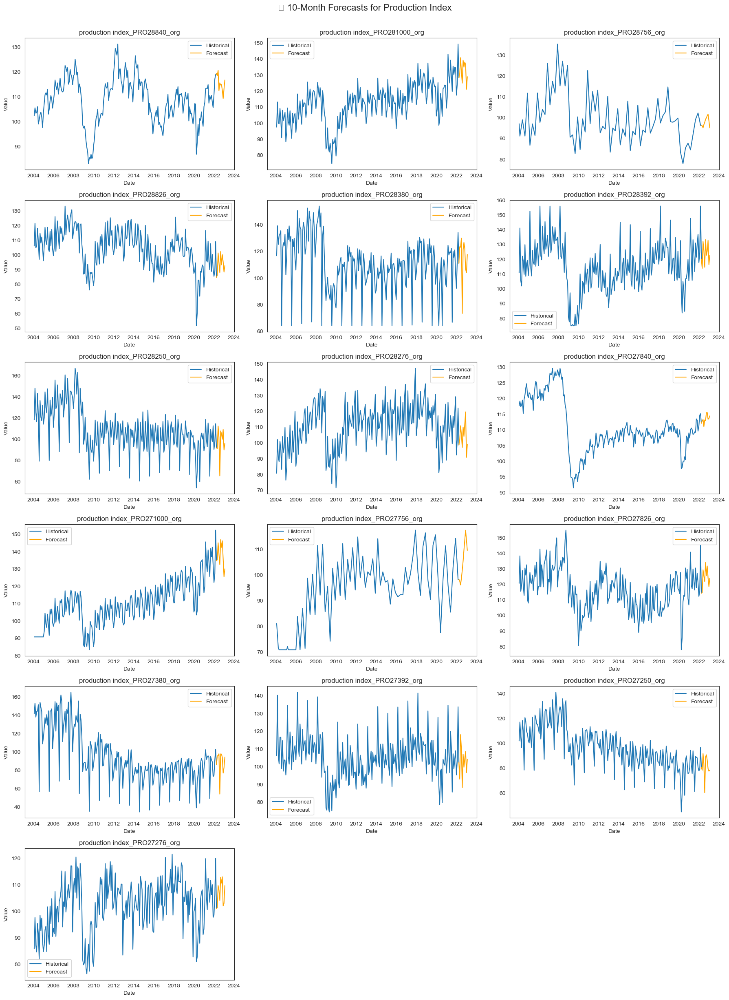

In [ ]:
# Set up columns and grid layout
cols = forecast_df_production_index.columns
n_cols = 3  # number of plots per row
n_rows = math.ceil(len(cols) / n_cols)

# Create subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 4))
axes = axes.flatten()

# Plot each column
for i, col in enumerate(cols):
    ax = axes[i]
    ax.plot(df_production_index[col], label='Historical')
    ax.plot(forecast_df_production_index[col], label='Forecast', color='orange')
    ax.set_title(col)
    ax.set_xlabel('Date')
    ax.set_ylabel('Value')
    ax.legend()

# Remove unused subplots if any
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.suptitle("📈 10-Month Forecasts for Production Index", fontsize=16, y=1.02)
plt.show()


In [ ]:
forecast_df_production_index.to_csv("forecast_df_production_index._10_months.csv")
